#### Packages and Visualization

In [2]:
import torch
from torch import nn
from tqdm.auto import tqdm
from torchvision import transforms
from torchvision.datasets import MNIST
from torchvision.utils import make_grid
from torch.utils.data import DataLoader
import matplotlib.pyplot as plt

torch.manual_seed(0)

In [3]:
def show_tensor_images(image_tensor, num_images=25, size=(1, 28, 28), nrows=5, show=True):
    
    image_tensor = (image_tensor + 1) / 2
    image_unflat = image_tensor.detach().cpu()
    image_grid = make_grid(image_unflat[:num_images], nrow=nrows)
    plt.imshow(image_grid.permute(1, 2, 0).squeeze())
    if show:
        plt.show()

#### Generator and Noise

In [4]:
class Generator(nn.Module):
    
    def __init__(self, input_dim=10, im_chan=1, hidden_dim=64):
        super(Generator, self).__init__()
        
        self.input_dim = input_dim
        
        self.gen = nn.Sequential(
            self.make_gen_block(input_dim, hidden_dim * 4),
            self.make_gen_block(hidden_dim * 4, hidden_dim * 2, kernel_size=4, stride=1),
            self.make_gen_block(hidden_dim * 2, hidden_dim),
            self.make_gen_block(hidden_dim, im_chan, kernel_size=4, final_layer=True),
        )
        
    def make_gen_block(self, input_channels, output_channels, kernel_size=3, stride=2, final_layer=False):
        
        if not final_layer:
            
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.ReLU(inplace=True),
            )
        
        else:
            
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.Tanh(),
            )
        
    def forward(self, noise):
        
        x = noise.view(len(noise), self.input_dim, 1, 1)
        return self.gen(x)
    
def get_noise(n_samples, input_dim, device='cpu'):
    
    return torch.randn(n_samples, input_dim, device=device)

#### Discriminator

In [5]:
class Discriminator(nn.Module):
    
    def __init__(self, im_chan=1, hidden_dim=64):
        
        super(Discriminator, self).__init__()
        
        self.disc = nn.Sequential(
            self.make_disc_block(im_chan, hidden_dim),
            self.make_disc_block(hidden_dim, hidden_dim * 2),
            self.make_disc_block(hidden_dim * 2, 1, final_layer=True),
        )
        
    def make_disc_block(self, input_channels, output_channels, kernel_size=4, stride=2, final_layer=False):
        
        if not final_layer:
            
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.LeakyReLU(0.2, inplace=True)
            )
        
        else:
            
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
            )
        
    def forward(self, image):
        
        disc_pred = self.disc(image)
        return disc_pred.view(len(disc_pred), -1)

#### Class Input

In [6]:
import torch.nn.functional as F

def get_one_hot_labels(labels, n_classes):
    '''
    Function for creating one-hot vectors for the labels, returns a tensor of shape (?, num_classes).
    Parameters:
        labels: tensor of labels from the dataloader, size (?)
        n_classes: the total number of classes in the dataset, an integer scalar
    '''
    
    return F.one_hot(labels, n_classes)

In [7]:
assert (
    get_one_hot_labels(
        labels=torch.Tensor([[0, 2, 1]]).long(),
        n_classes=3
    ).tolist() == 
    [[
      [1, 0, 0], 
      [0, 0, 1], 
      [0, 1, 0]
    ]]
)
print("Success!")

Success!


##### Combining the class one-hot-encoded vector with the input vector

In [8]:
def combine_vectors(x, y):
    
    '''
    Function for combining two vectors with shapes (n_samples, ?) and (n_samples, ?).
    Parameters:
      x: (n_samples, ?) the first vector. 
        In this assignment, this will be the noise vector of shape (n_samples, z_dim), 
        but you shouldn't need to know the second dimension's size.
      y: (n_samples, ?) the second vector.
        Once again, in this assignment this will be the one-hot class vector 
        with the shape (n_samples, n_classes), but you shouldn't assume this in your code.
    '''
    
    combined = torch.cat((x.float(),y.float()), 1)
    
    return combined

In [9]:
assert tuple(combine_vectors(torch.randn(1, 4, 5), torch.randn(1, 8, 5)).shape) == (1, 12, 5)
assert tuple(combine_vectors(torch.randn(1, 10, 12).long(), torch.randn(1, 20, 12).long()).shape) == (1, 30, 12)
print("Success!")

Success!


### Training

In [10]:
mnist_shape = (1, 28, 28)
n_classes = 10

In [11]:
criterion = nn.BCEWithLogitsLoss()
n_epochs = 200
z_dim = 64
display_step = 500
batch_size = 128
lr = 0.0002
device = 'cuda'

transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize((0.5), (0.5)),
])

dataloader = DataLoader(
    MNIST('dataset/', download=False, transform=transform),
    batch_size=batch_size,
    shuffle=True
)

C:\Users\DESKTOP\anaconda3\envs\specter\lib\site-packages\torchvision\datasets\mnist.py:498: UserWarning: The given NumPy array is not writeable, and PyTorch does not support non-writeable tensors. This means you can write to the underlying (supposedly non-writeable) NumPy array using the tensor. You may want to copy the array to protect its data or make it writeable before converting it to a tensor. This type of warning will be suppressed for the rest of this program. (Triggered internally at  ..\torch\csrc\utils\tensor_numpy.cpp:180.)
  return torch.from_numpy(parsed.astype(m[2], copy=False)).view(*s)


In [12]:
def get_input_dimensions(z_dim, mnist_shape, n_classes):
    
    generator_input_dim = z_dim + n_classes
    discriminator_im_chan = mnist_shape[0] + n_classes
    
    return generator_input_dim, discriminator_im_chan

In [13]:
def test_input_dims():
    gen_dim, disc_dim = get_input_dimensions(23, (12, 23, 52), 9)
    assert gen_dim == 32
    assert disc_dim == 21
test_input_dims()
print("Success!")

Success!


In [14]:
generator_input_dim, discriminator_im_chan = get_input_dimensions(z_dim, mnist_shape, n_classes)

gen = Generator(input_dim=generator_input_dim).to(device)
gen_opt = torch.optim.Adam(gen.parameters(), lr=lr)

disc = Discriminator(im_chan=discriminator_im_chan).to(device)
disc_opt = torch.optim.Adam(disc.parameters(), lr=lr)

# Initializing the parameter weights
def weights_init(m):
    
    if isinstance(m , nn.Conv2d) or isinstance(m, nn.ConvTranspose2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
        
    if isinstance(m, nn.BatchNorm2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
        torch.nn.init.constant_(m.bias, 0)
        
gen = gen.apply(weights_init)
disc = disc.apply(weights_init)

  0%|          | 0/469 [00:00<?, ?it/s]

Congratulations! If you've gotten here, it's working. Please let this train until you're happy with how the generated numbers look, and then go on to the exploration!


  0%|          | 0/469 [00:00<?, ?it/s]

Step 500: Generator loss: 2.2937088876962664, discriminator loss: 0.25588329657912257


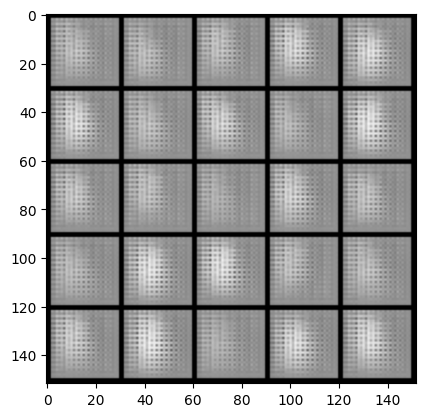

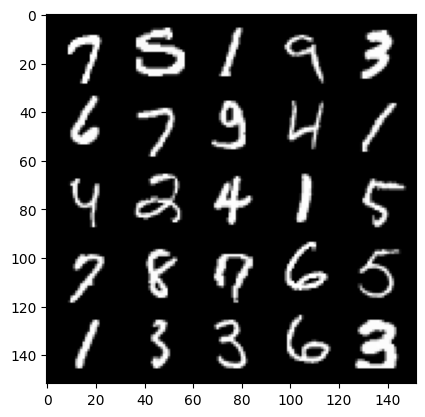

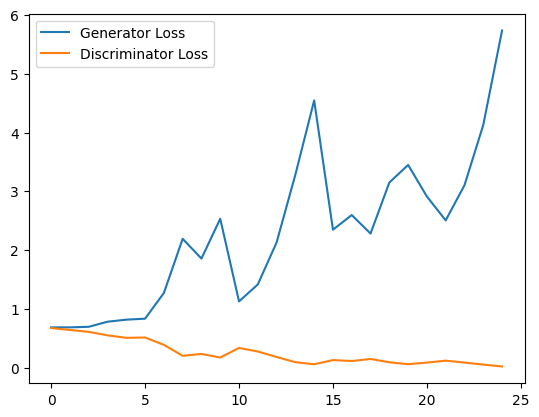

  0%|          | 0/469 [00:00<?, ?it/s]

Step 1000: Generator loss: 4.818470261096954, discriminator loss: 0.03314848028309643


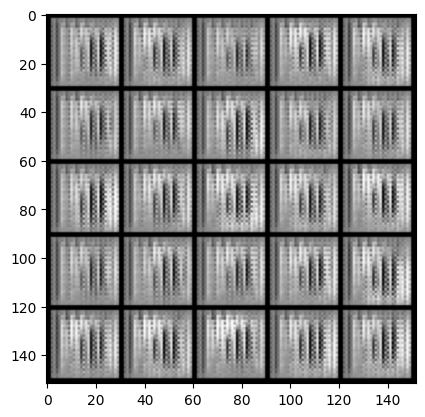

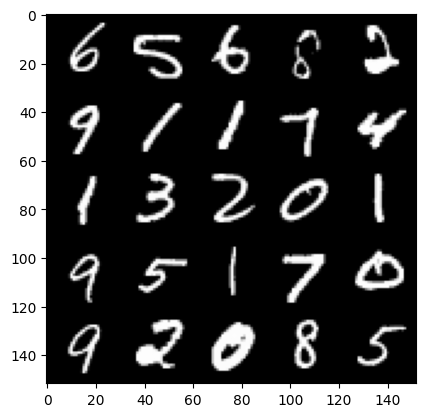

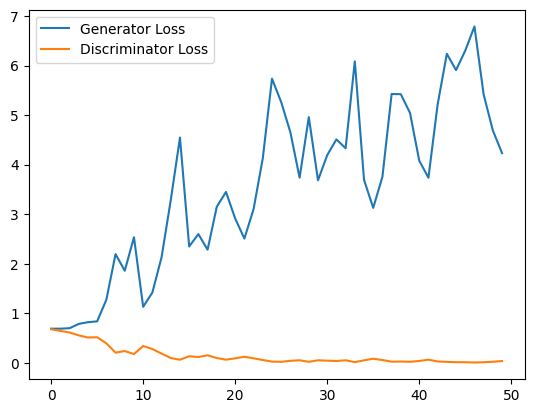

  0%|          | 0/469 [00:00<?, ?it/s]

Step 1500: Generator loss: 5.799243536949158, discriminator loss: 0.02391587177431211


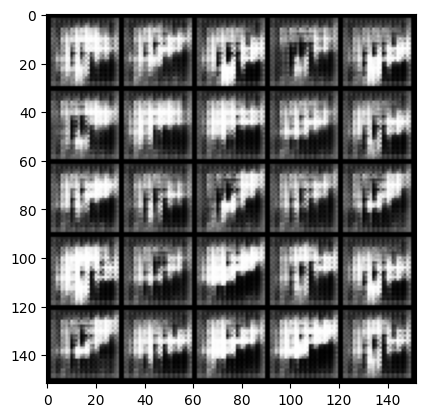

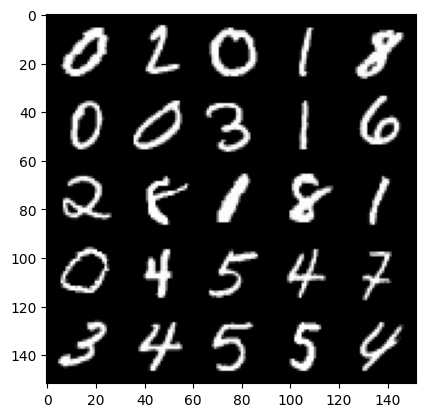

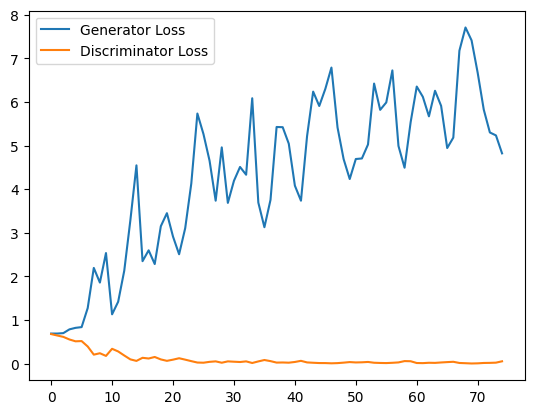

  0%|          | 0/469 [00:00<?, ?it/s]

Step 2000: Generator loss: 4.641528635025025, discriminator loss: 0.05579488684982061


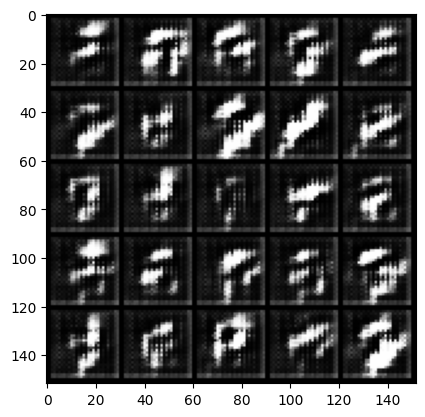

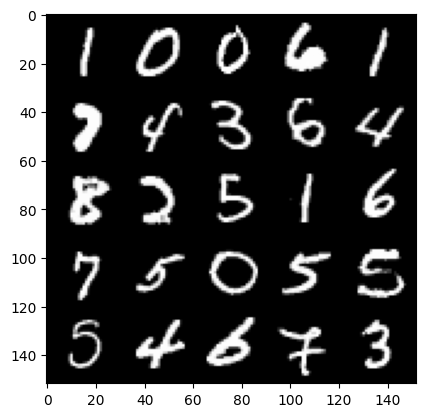

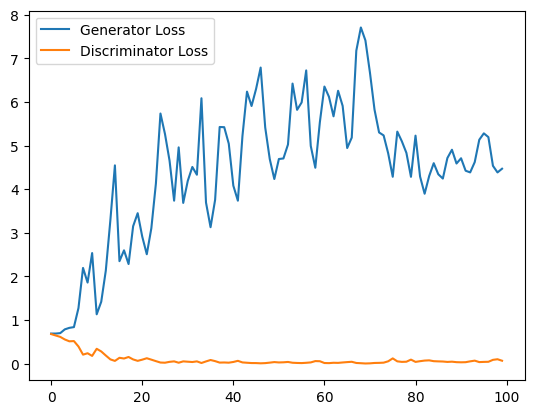

  0%|          | 0/469 [00:00<?, ?it/s]

Step 2500: Generator loss: 4.290964349269867, discriminator loss: 0.08111907292529941


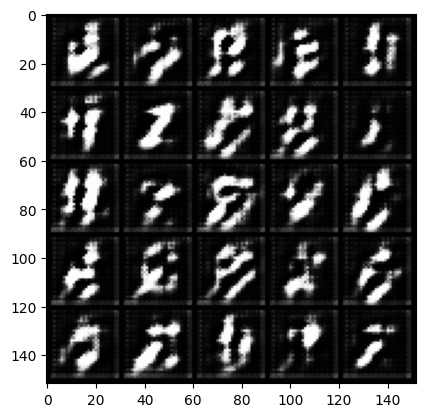

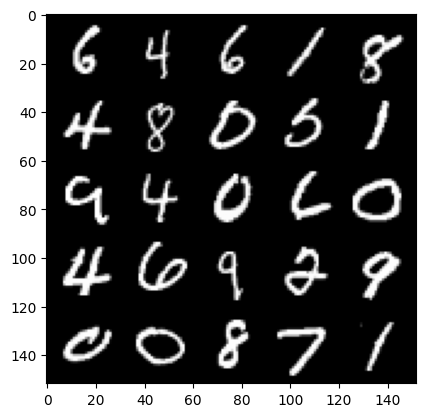

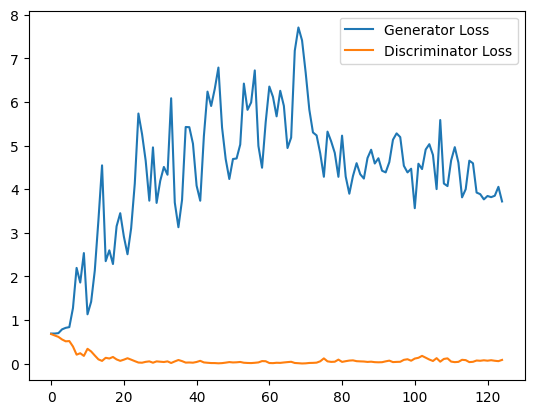

  0%|          | 0/469 [00:00<?, ?it/s]

Step 3000: Generator loss: 3.4636805510520934, discriminator loss: 0.1451301625519991


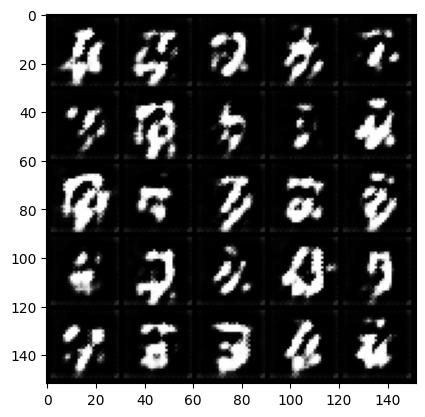

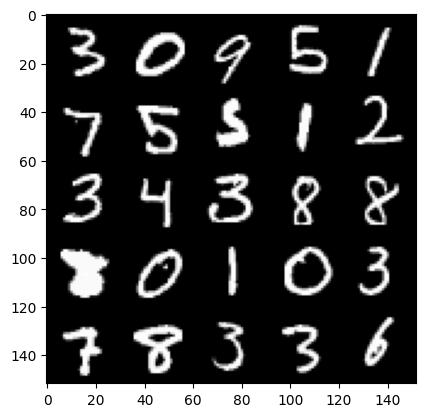

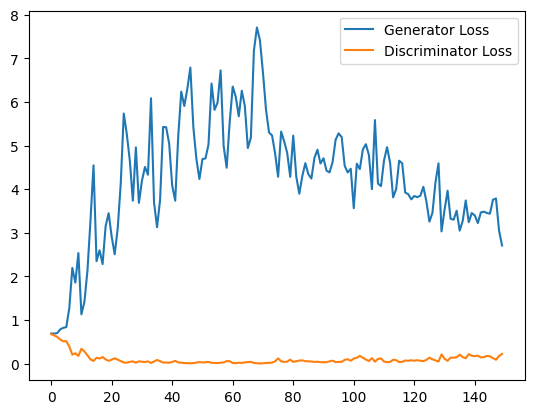

  0%|          | 0/469 [00:00<?, ?it/s]

Step 3500: Generator loss: 2.678893962621689, discriminator loss: 0.21699844589829445


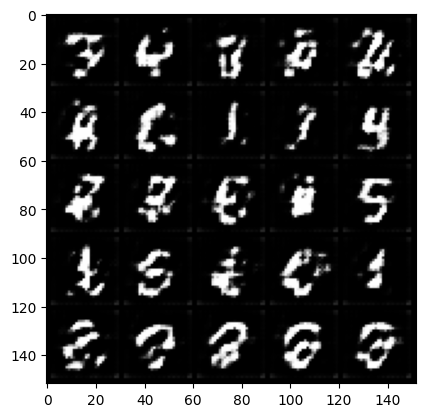

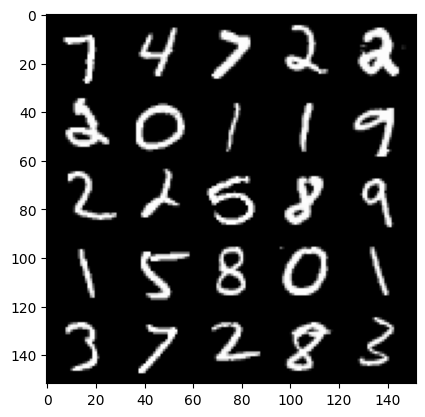

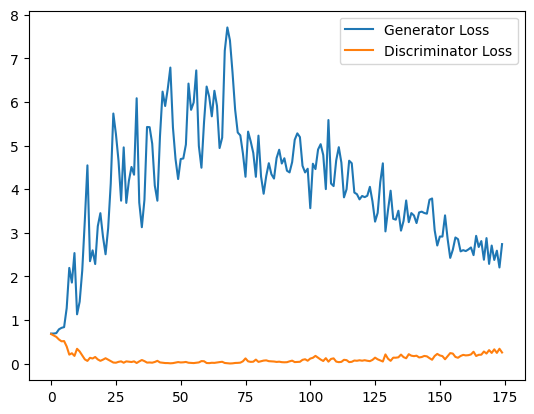

  0%|          | 0/469 [00:00<?, ?it/s]

Step 4000: Generator loss: 2.337564576625824, discriminator loss: 0.316096538066864


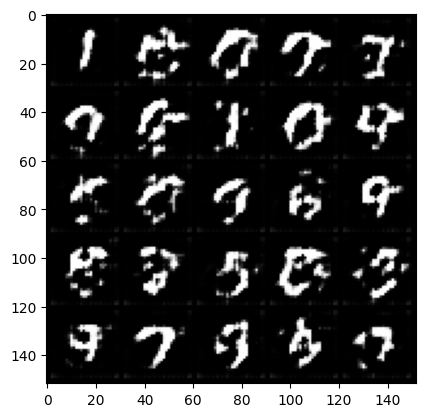

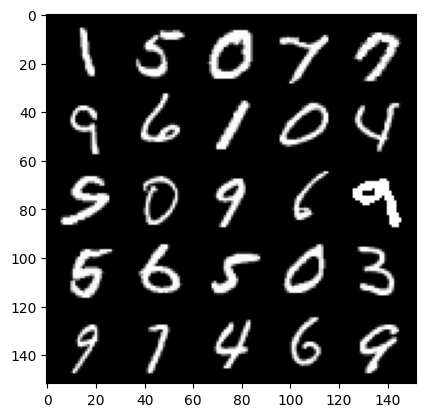

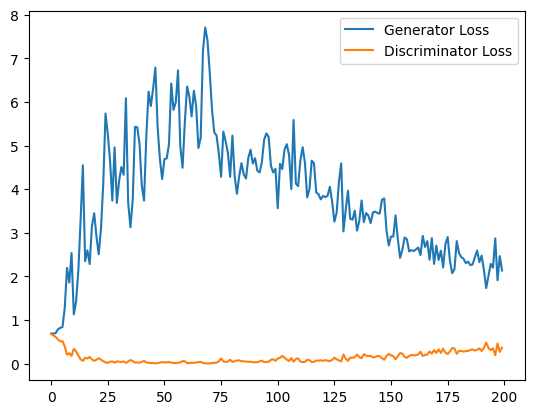

  0%|          | 0/469 [00:00<?, ?it/s]

Step 4500: Generator loss: 2.1570749962329865, discriminator loss: 0.3065654278099537


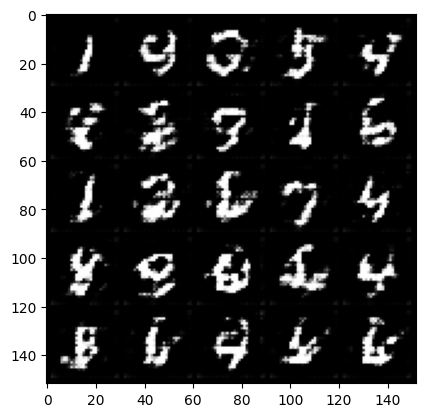

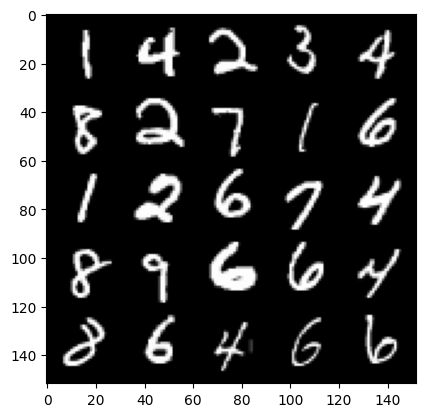

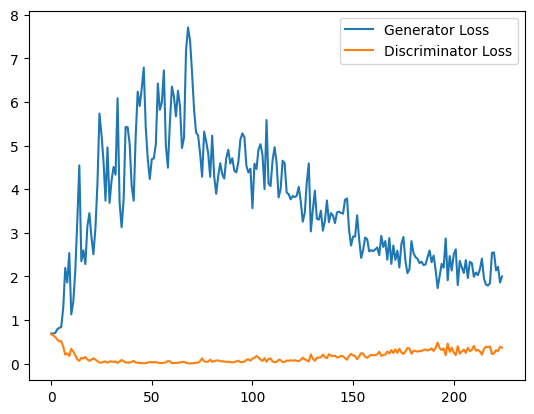

  0%|          | 0/469 [00:00<?, ?it/s]

Step 5000: Generator loss: 2.0977022178173064, discriminator loss: 0.30545113718509675


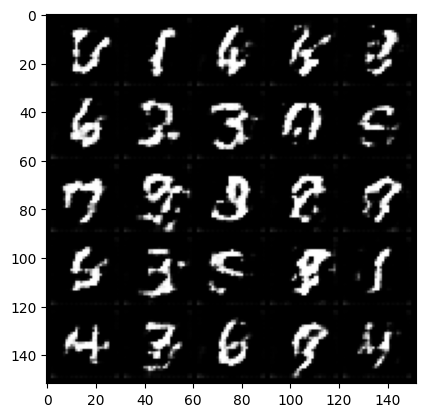

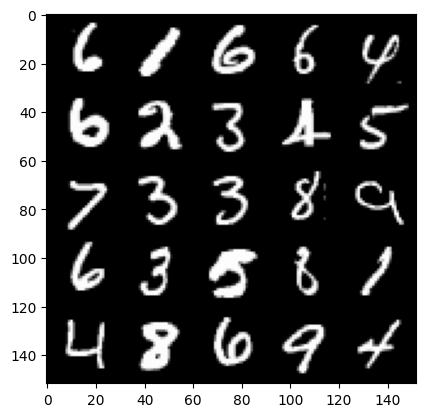

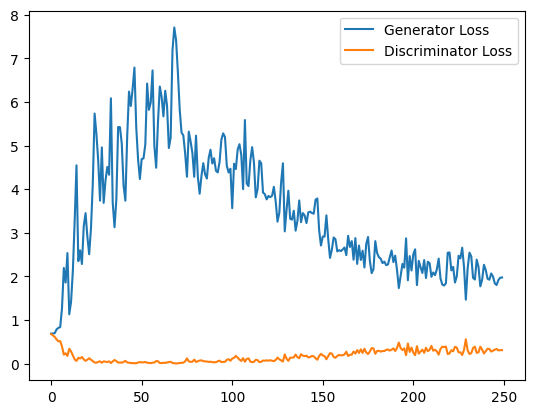

  0%|          | 0/469 [00:00<?, ?it/s]

Step 5500: Generator loss: 2.163695991039276, discriminator loss: 0.28929403483867644


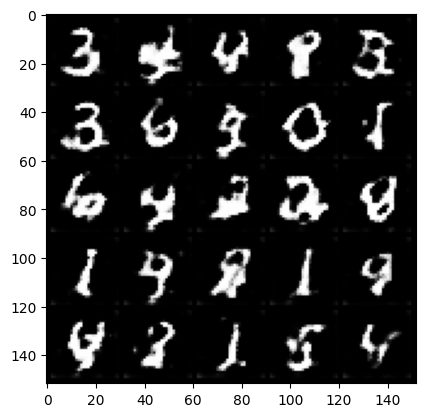

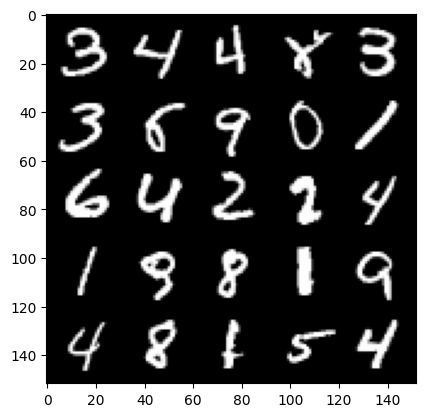

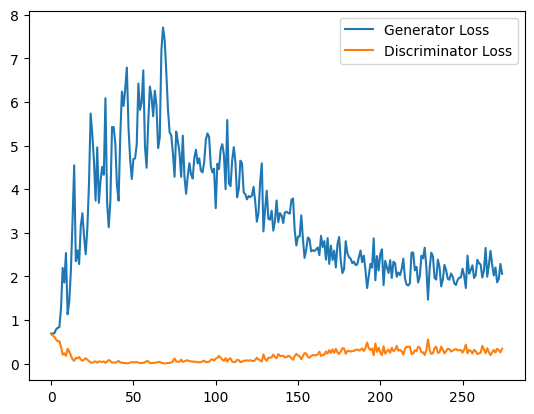

  0%|          | 0/469 [00:00<?, ?it/s]

Step 6000: Generator loss: 2.214479880809784, discriminator loss: 0.32065200601518157


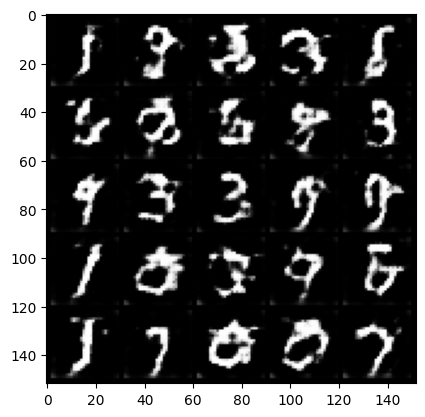

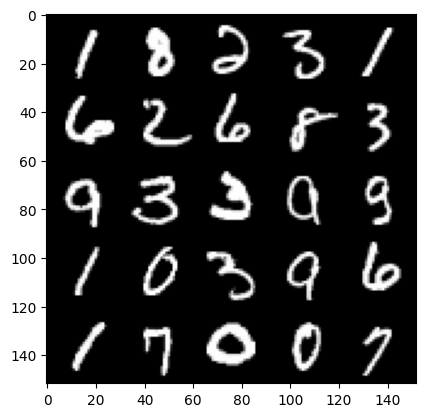

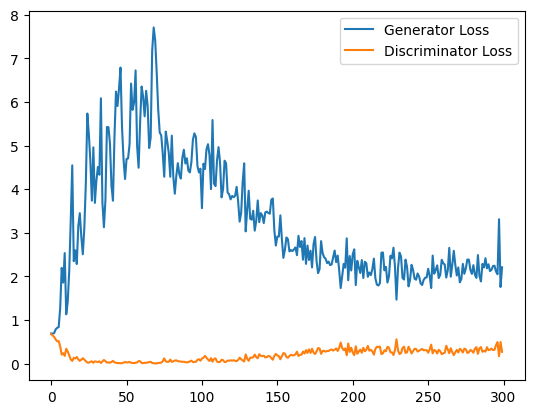

  0%|          | 0/469 [00:00<?, ?it/s]

Step 6500: Generator loss: 1.8909171874523163, discriminator loss: 0.34898490458726883


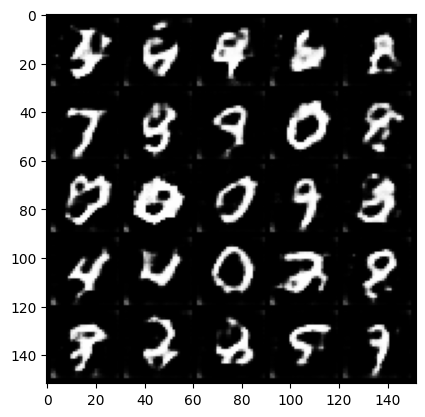

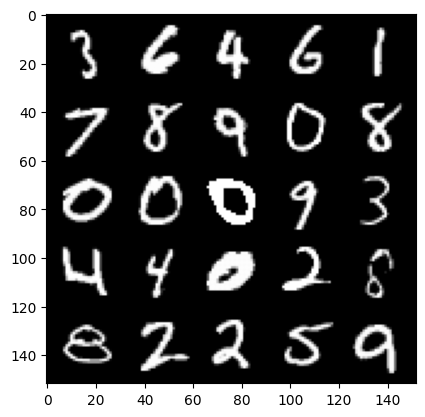

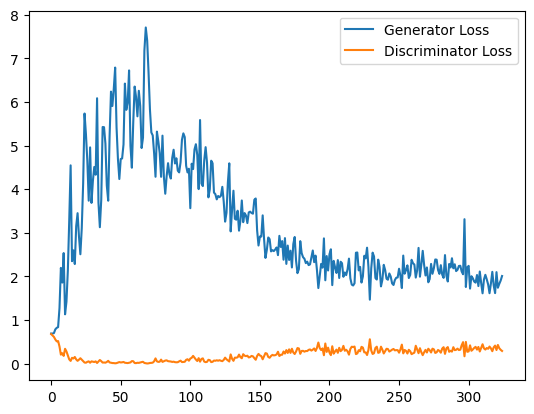

  0%|          | 0/469 [00:00<?, ?it/s]

Step 7000: Generator loss: 1.8043804559707641, discriminator loss: 0.36219777193665503


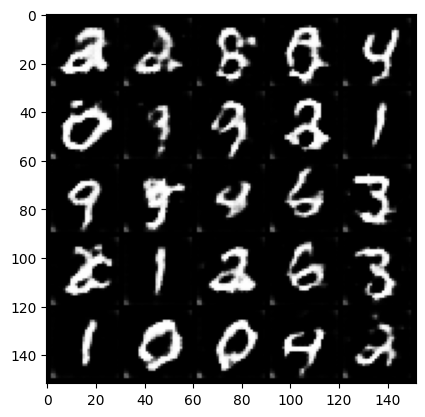

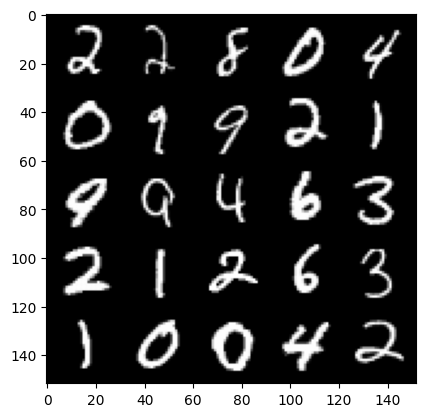

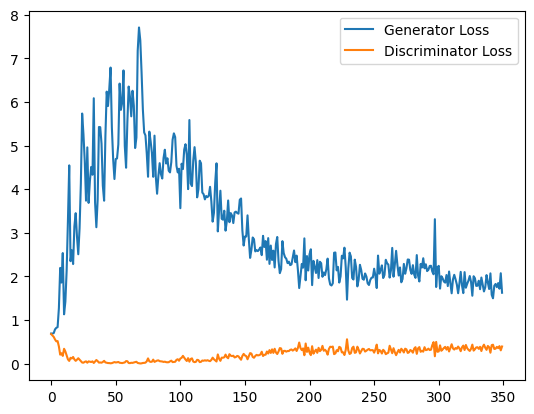

  0%|          | 0/469 [00:00<?, ?it/s]

Step 7500: Generator loss: 1.7239818785190582, discriminator loss: 0.402078843832016


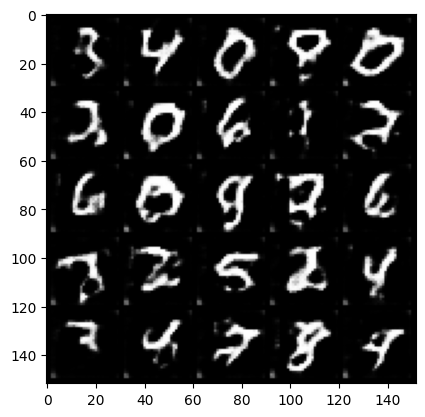

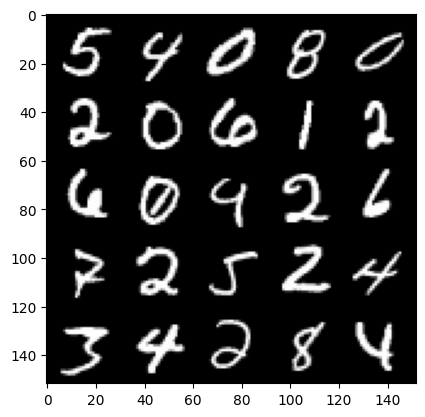

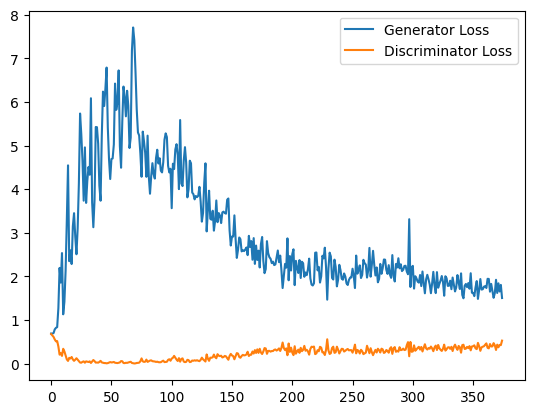

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

Step 8000: Generator loss: 1.7030999035835266, discriminator loss: 0.4098711404204369


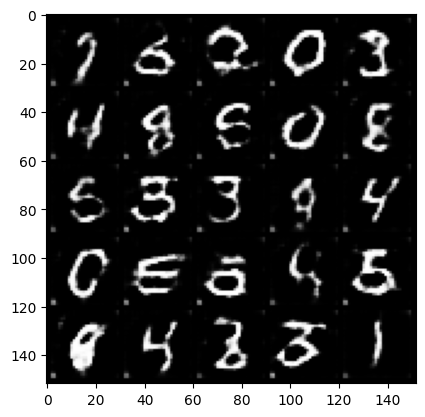

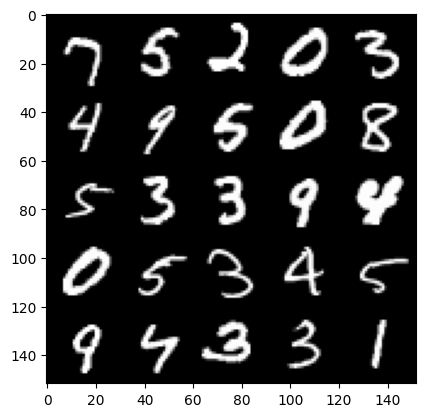

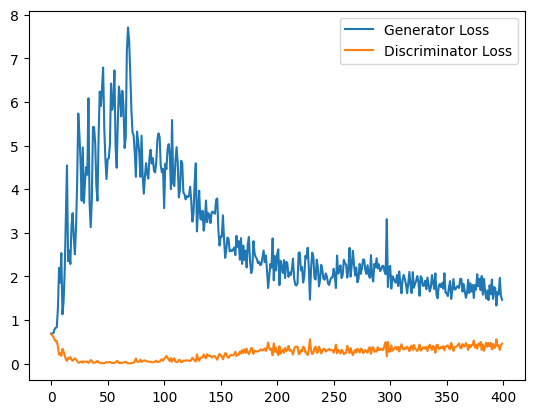

  0%|          | 0/469 [00:00<?, ?it/s]

Step 8500: Generator loss: 1.5609507366418838, discriminator loss: 0.4410710759162903


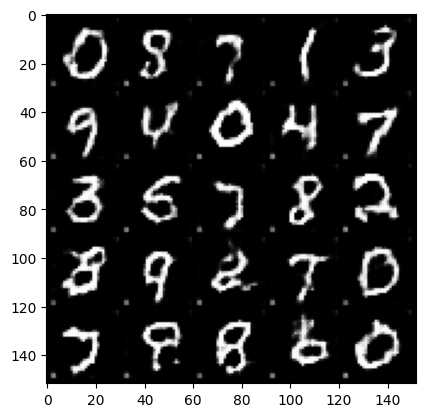

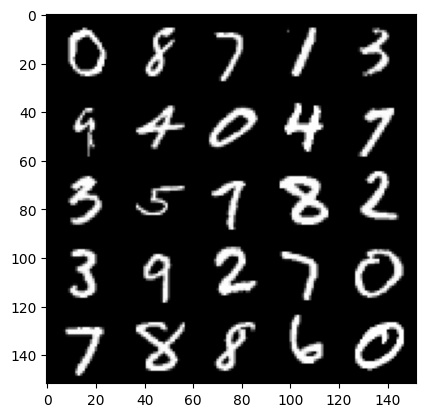

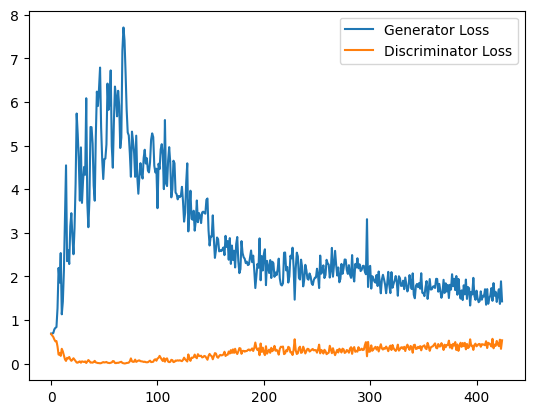

  0%|          | 0/469 [00:00<?, ?it/s]

Step 9000: Generator loss: 1.5434365379810333, discriminator loss: 0.4546798417568207


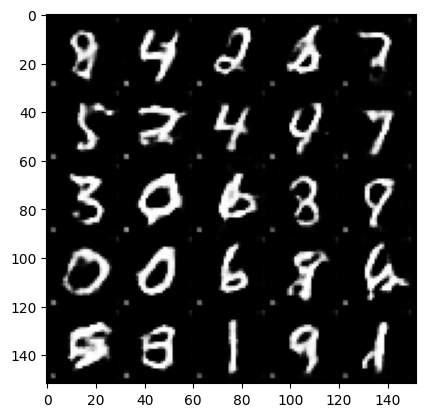

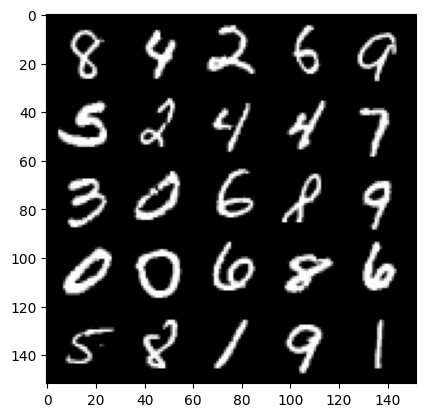

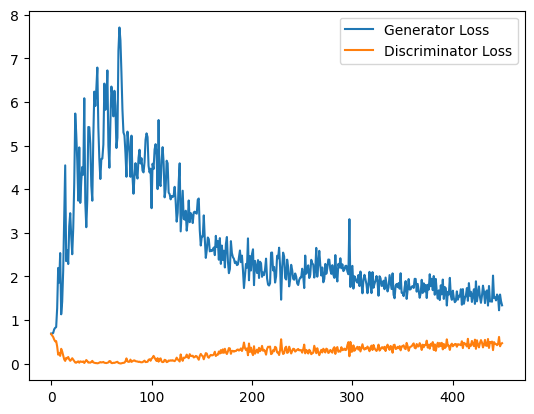

  0%|          | 0/469 [00:00<?, ?it/s]

Step 9500: Generator loss: 1.453326961994171, discriminator loss: 0.47714754474163057


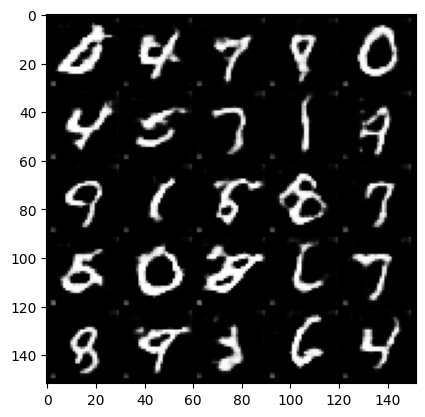

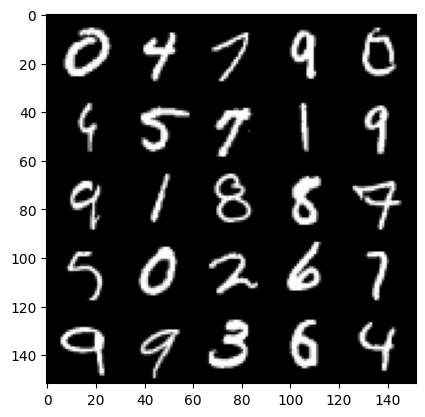

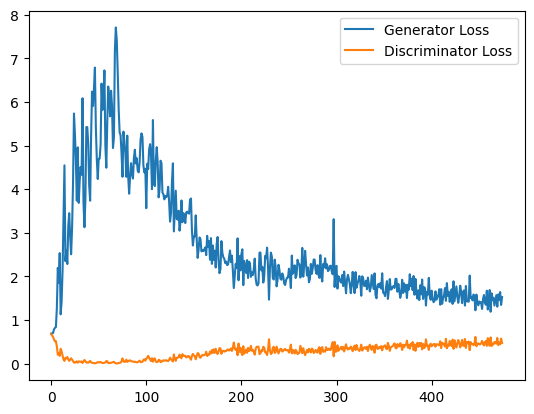

  0%|          | 0/469 [00:00<?, ?it/s]

Step 10000: Generator loss: 1.4434237792491913, discriminator loss: 0.48958142697811124


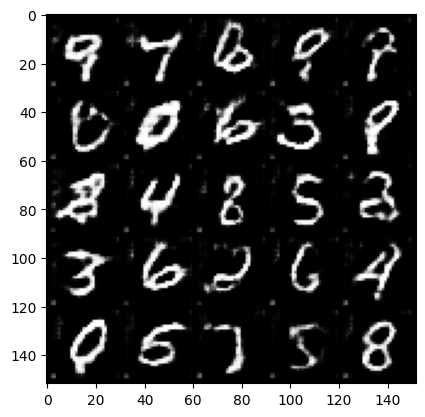

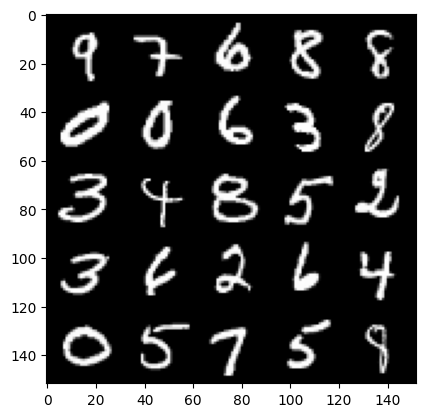

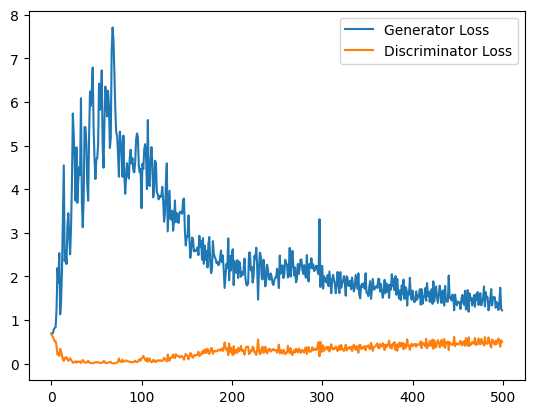

  0%|          | 0/469 [00:00<?, ?it/s]

Step 10500: Generator loss: 1.3501257615089417, discriminator loss: 0.49247901505231856


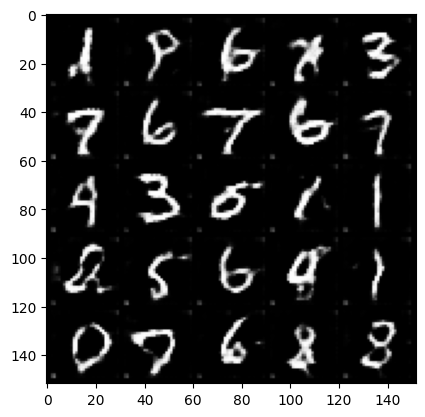

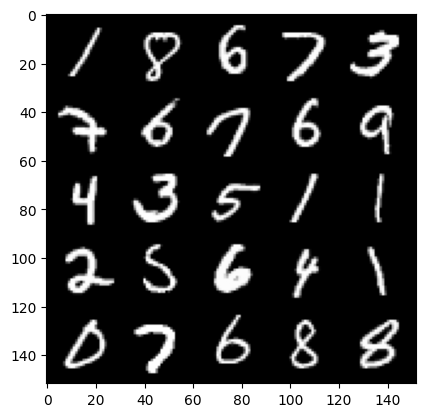

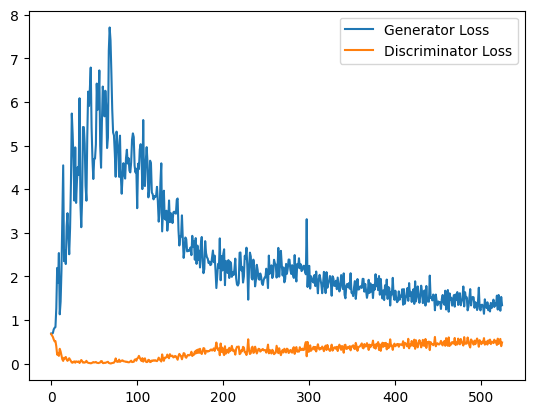

  0%|          | 0/469 [00:00<?, ?it/s]

Step 11000: Generator loss: 1.3706510897874833, discriminator loss: 0.4982474920153618


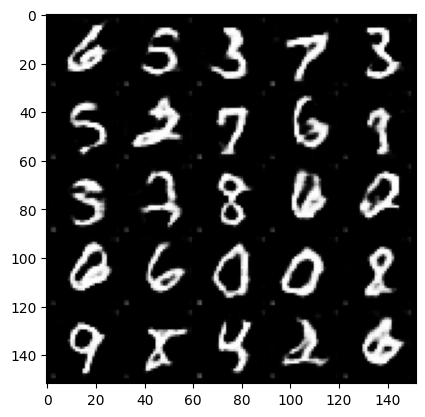

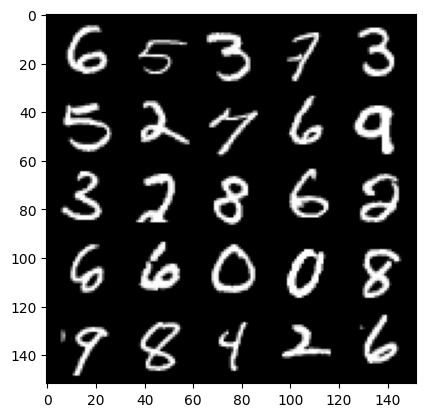

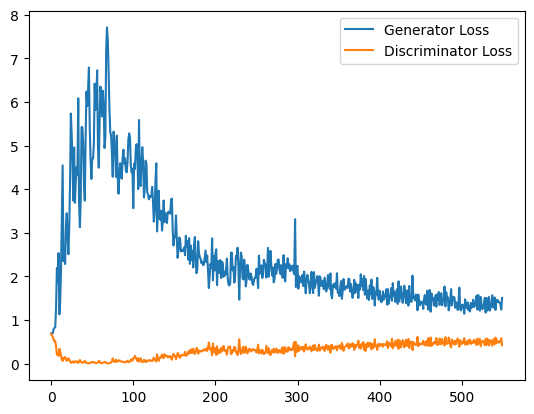

  0%|          | 0/469 [00:00<?, ?it/s]

Step 11500: Generator loss: 1.3560522243976594, discriminator loss: 0.510960521697998


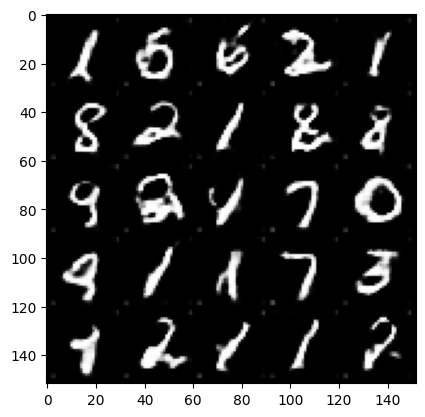

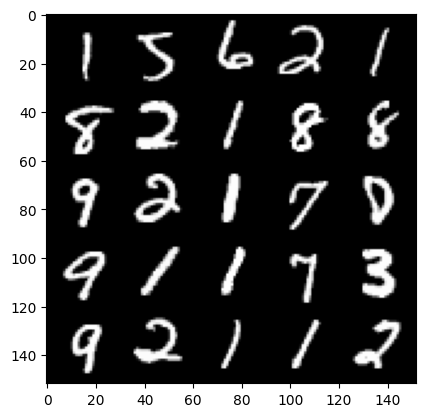

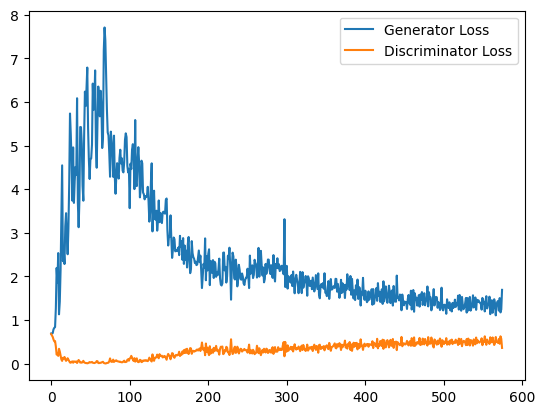

  0%|          | 0/469 [00:00<?, ?it/s]

Step 12000: Generator loss: 1.3151002218723298, discriminator loss: 0.5234413992166519


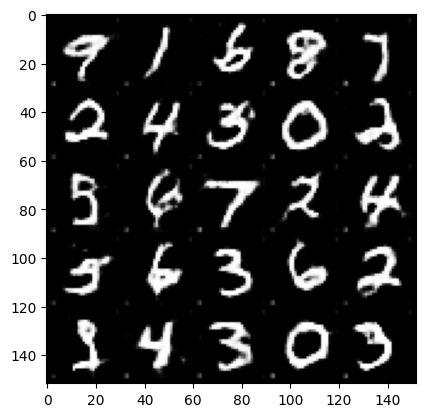

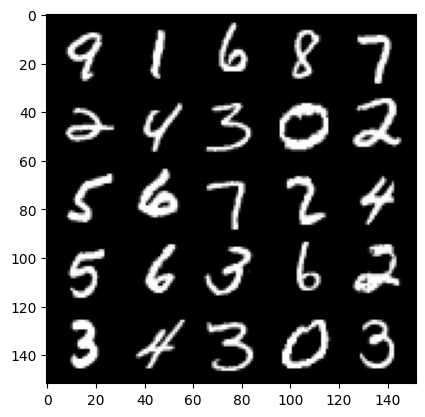

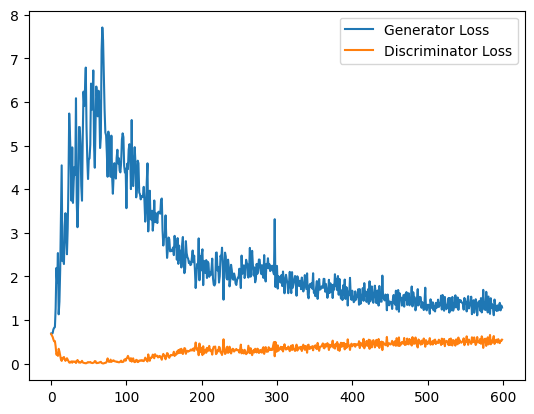

  0%|          | 0/469 [00:00<?, ?it/s]

Step 12500: Generator loss: 1.2706909115314484, discriminator loss: 0.5231685805320739


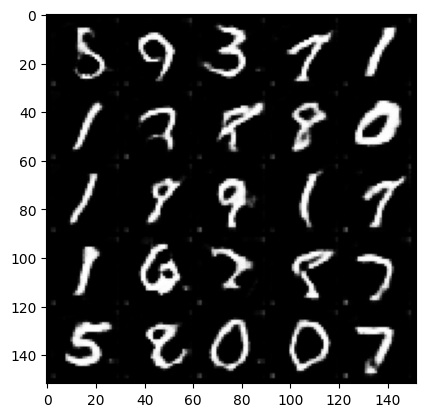

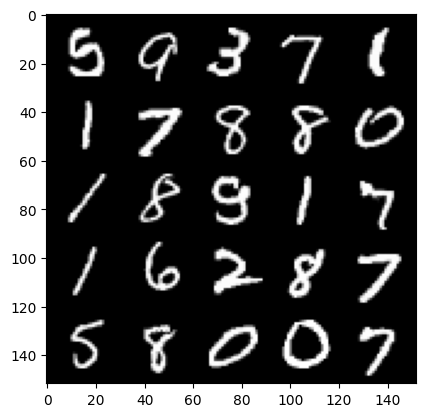

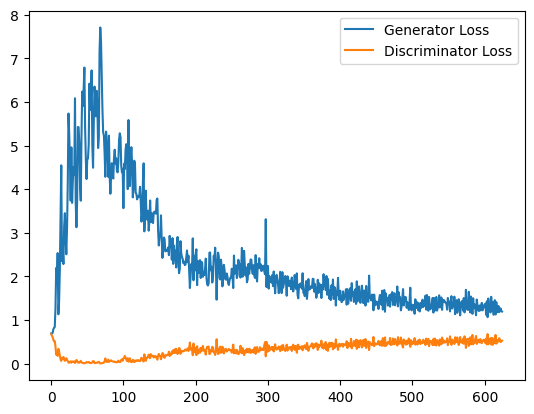

  0%|          | 0/469 [00:00<?, ?it/s]

Step 13000: Generator loss: 1.2347293552160263, discriminator loss: 0.5365871024131775


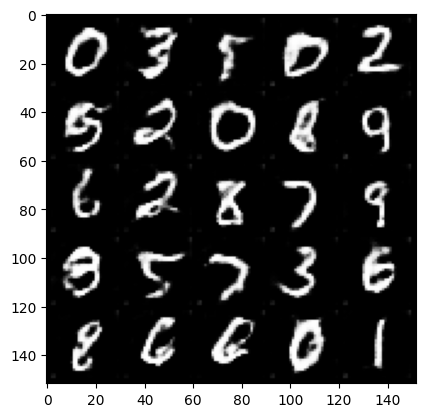

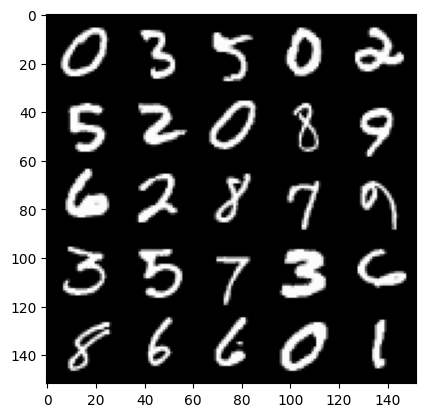

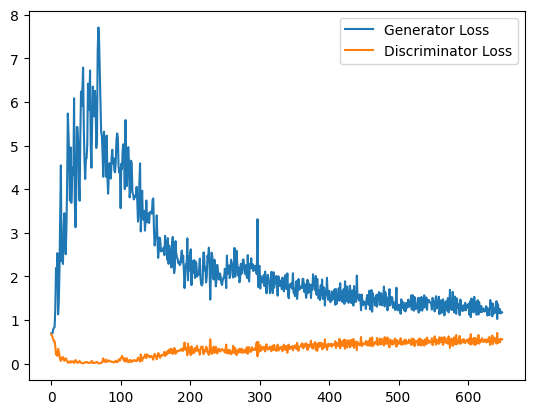

  0%|          | 0/469 [00:00<?, ?it/s]

Step 13500: Generator loss: 1.194826848268509, discriminator loss: 0.5340827859640122


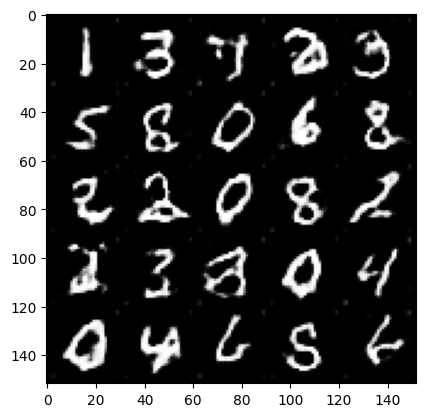

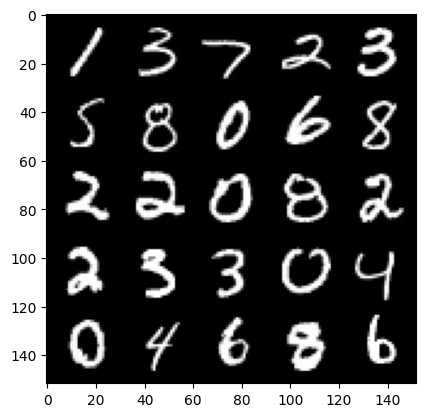

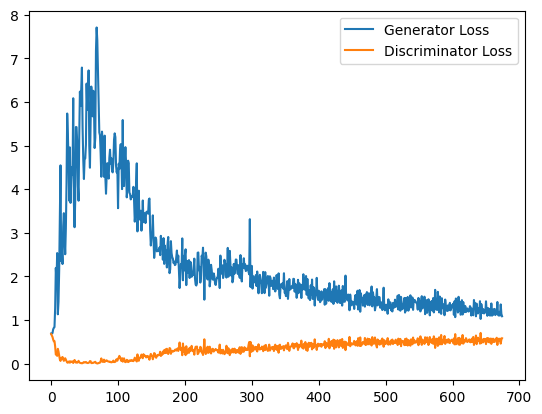

  0%|          | 0/469 [00:00<?, ?it/s]

Step 14000: Generator loss: 1.1981401342153548, discriminator loss: 0.5409204619526863


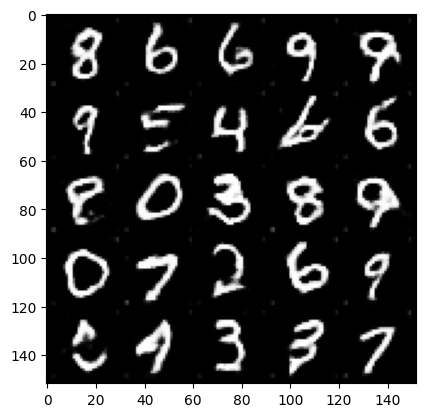

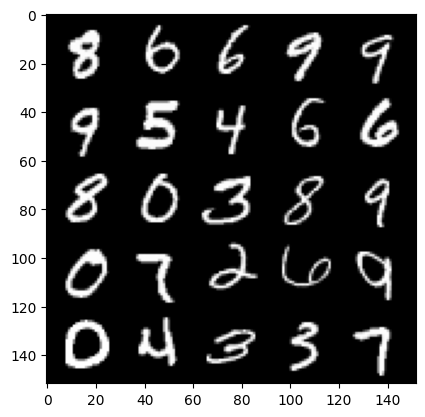

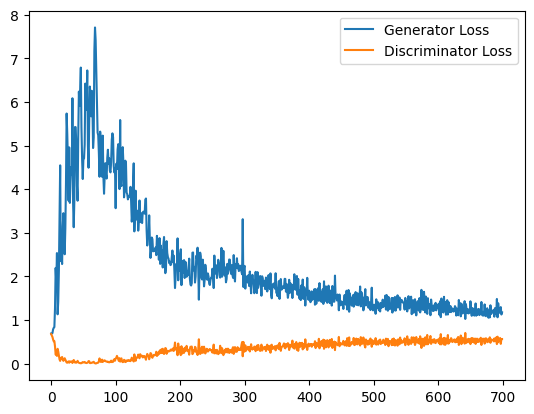

  0%|          | 0/469 [00:00<?, ?it/s]

Step 14500: Generator loss: 1.2607203972339631, discriminator loss: 0.5461416758298874


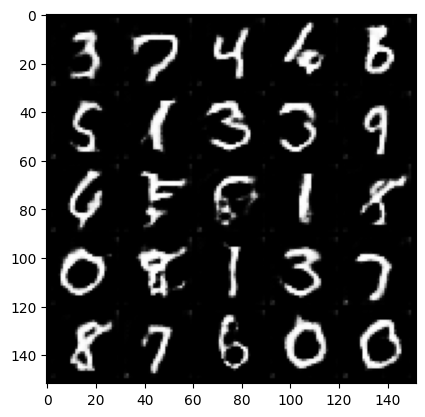

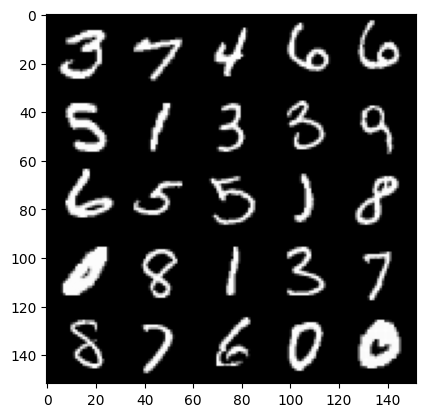

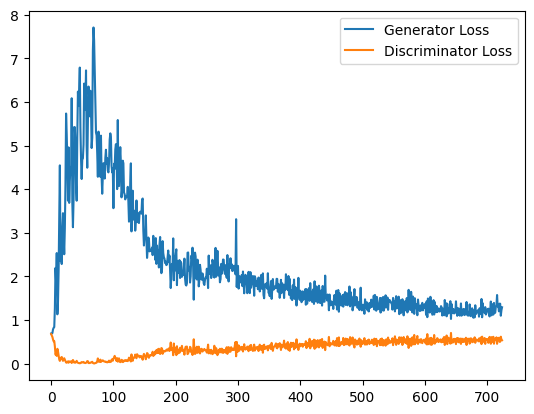

  0%|          | 0/469 [00:00<?, ?it/s]

Step 15000: Generator loss: 1.1874550746679307, discriminator loss: 0.5509752103686333


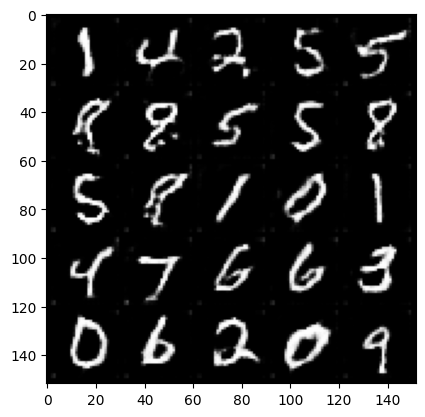

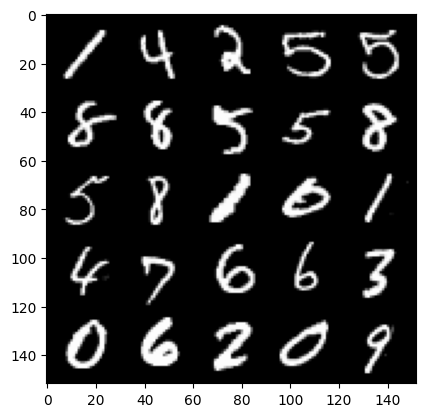

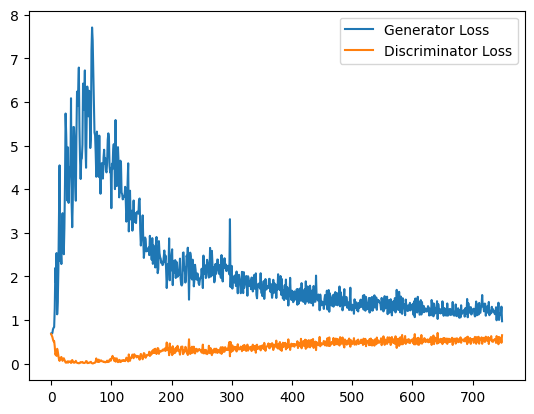

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

Step 15500: Generator loss: 1.1593588584661483, discriminator loss: 0.5505387704372406


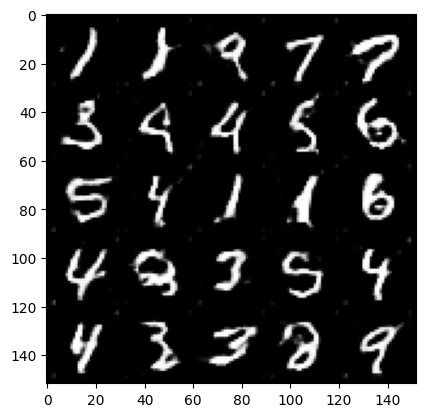

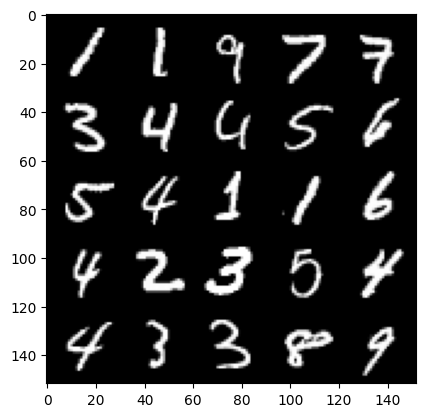

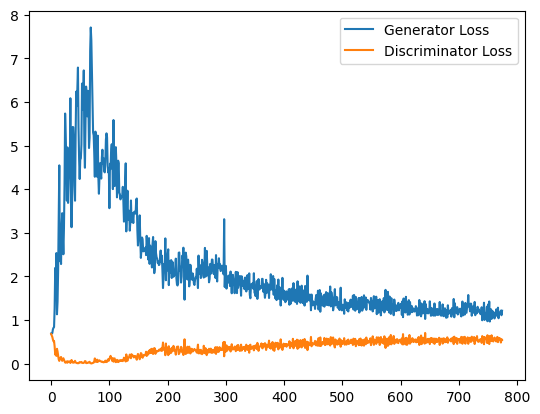

  0%|          | 0/469 [00:00<?, ?it/s]

Step 16000: Generator loss: 1.142802317261696, discriminator loss: 0.5554865116477012


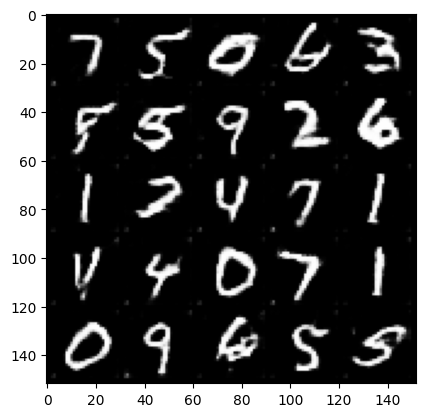

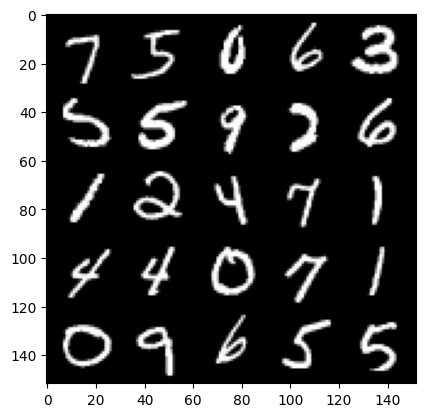

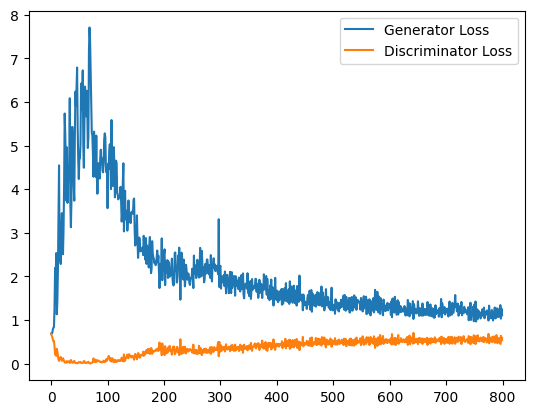

  0%|          | 0/469 [00:00<?, ?it/s]

Step 16500: Generator loss: 1.1479778804779053, discriminator loss: 0.5629098683595657


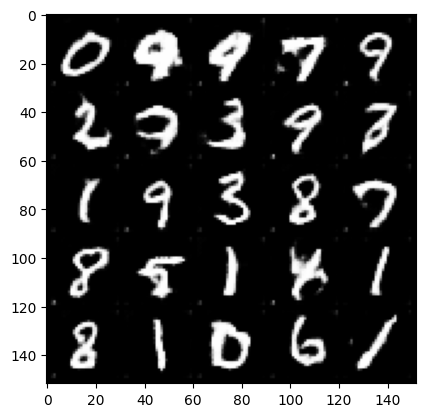

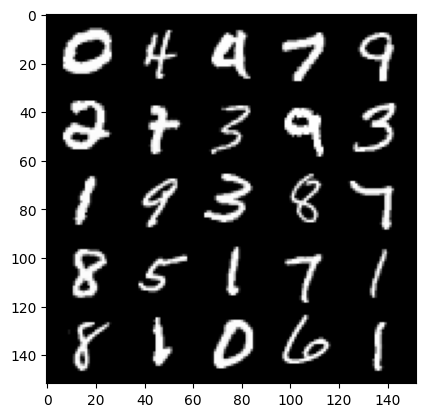

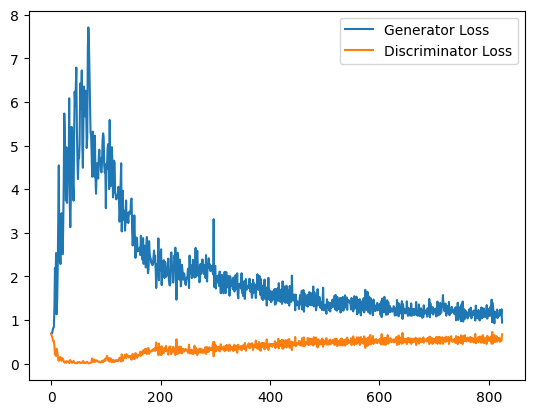

  0%|          | 0/469 [00:00<?, ?it/s]

Step 17000: Generator loss: 1.1231011043787003, discriminator loss: 0.5612355081439018


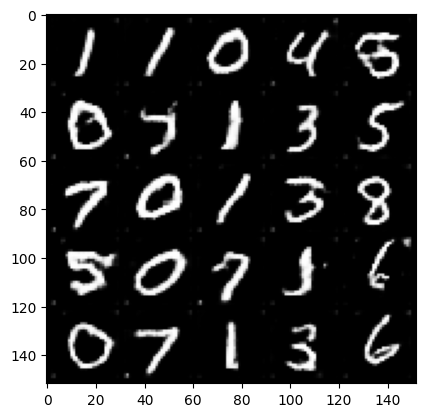

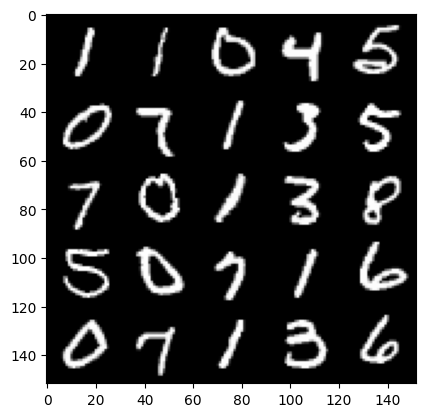

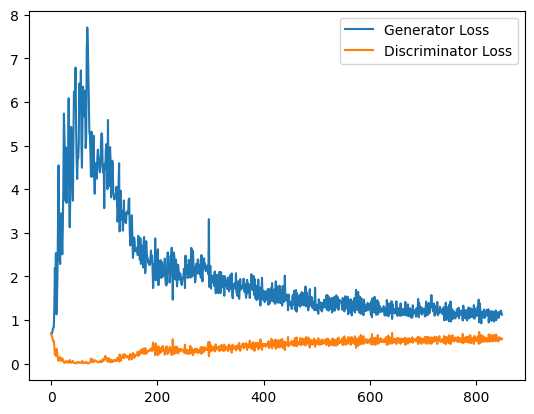

  0%|          | 0/469 [00:00<?, ?it/s]

Step 17500: Generator loss: 1.1106068617105485, discriminator loss: 0.5626181361675262


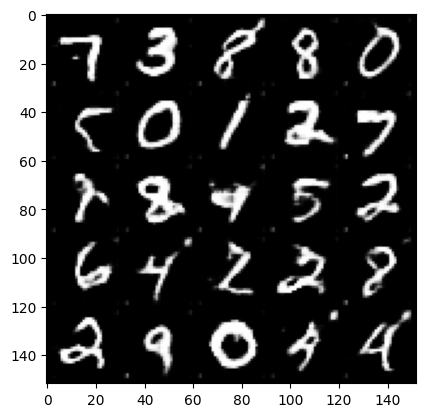

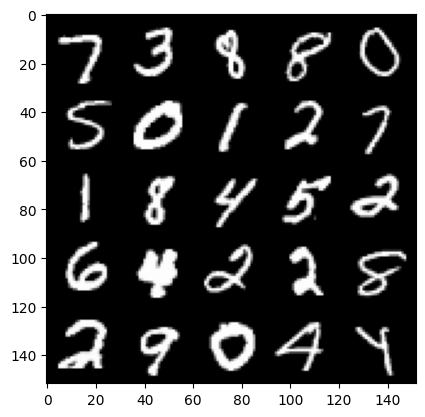

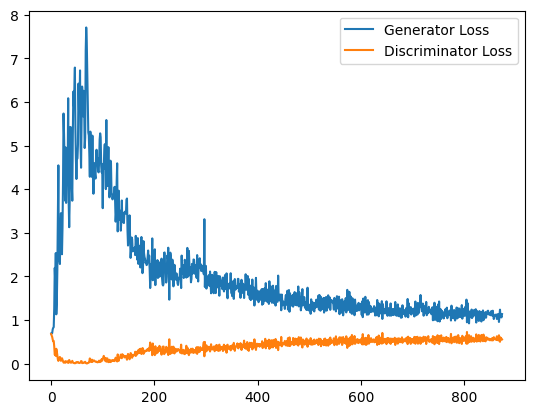

  0%|          | 0/469 [00:00<?, ?it/s]

Step 18000: Generator loss: 1.163688943862915, discriminator loss: 0.5716085792183876


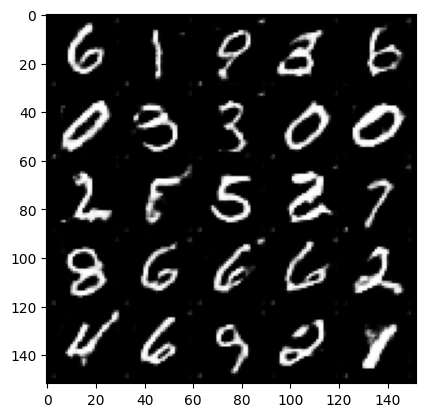

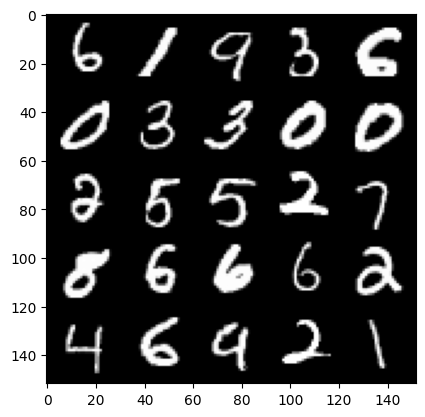

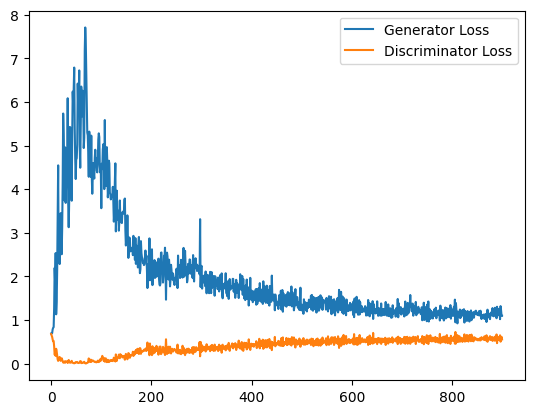

  0%|          | 0/469 [00:00<?, ?it/s]

Step 18500: Generator loss: 1.1417440437078477, discriminator loss: 0.5663358758687973


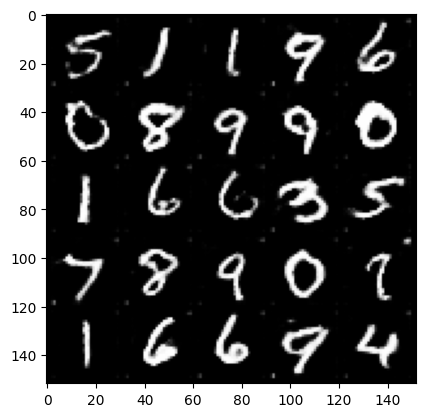

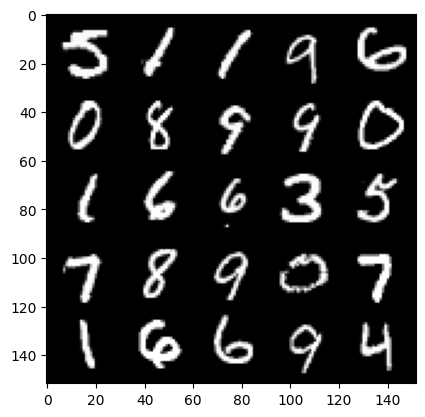

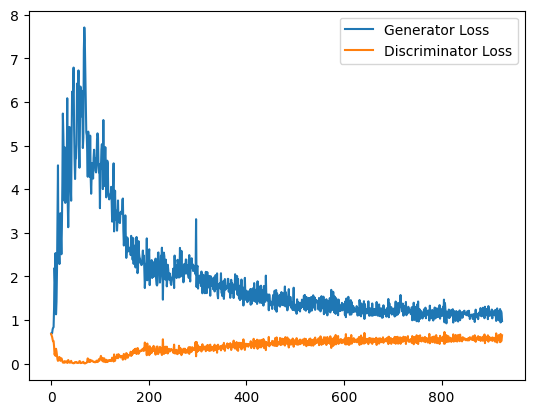

  0%|          | 0/469 [00:00<?, ?it/s]

Step 19000: Generator loss: 1.1077891867160796, discriminator loss: 0.5643305293917656


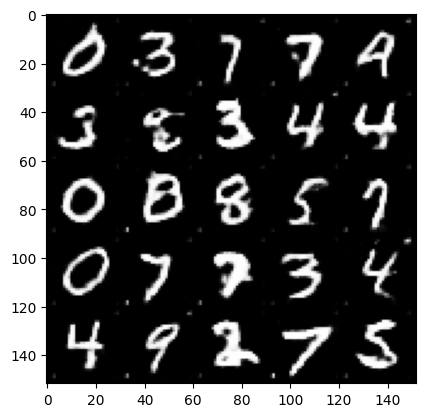

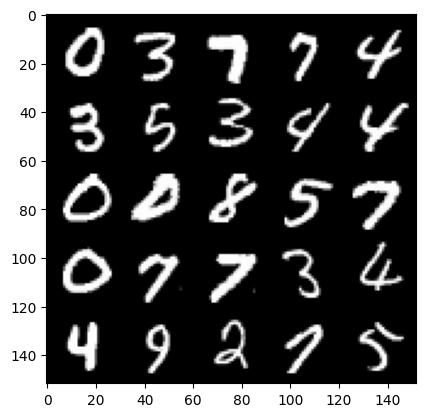

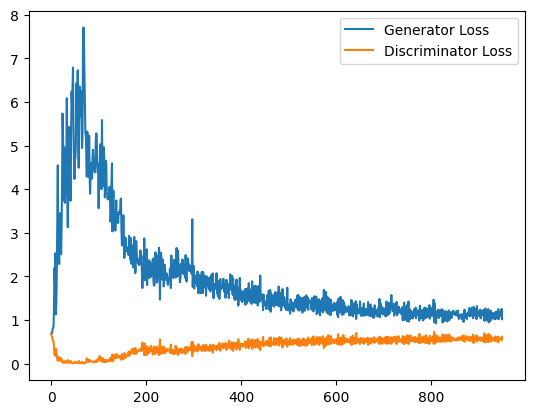

  0%|          | 0/469 [00:00<?, ?it/s]

Step 19500: Generator loss: 1.1064346047639846, discriminator loss: 0.5664792669415474


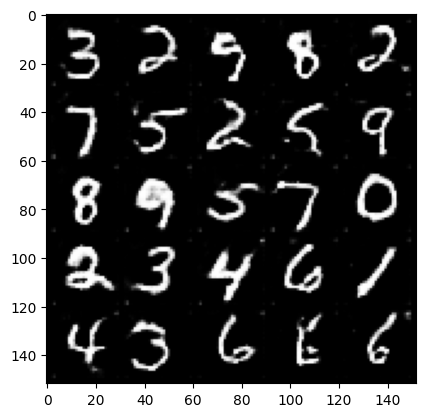

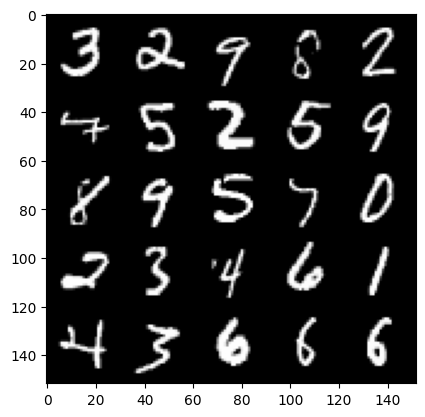

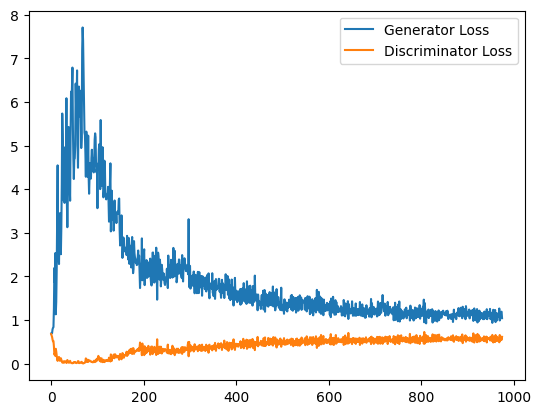

  0%|          | 0/469 [00:00<?, ?it/s]

Step 20000: Generator loss: 1.1706236780881882, discriminator loss: 0.5731993539333343


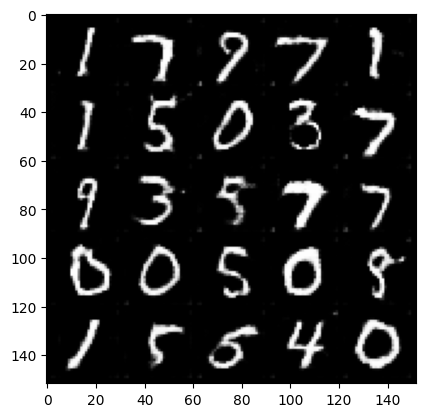

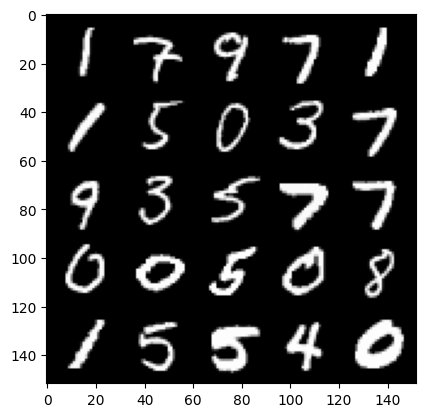

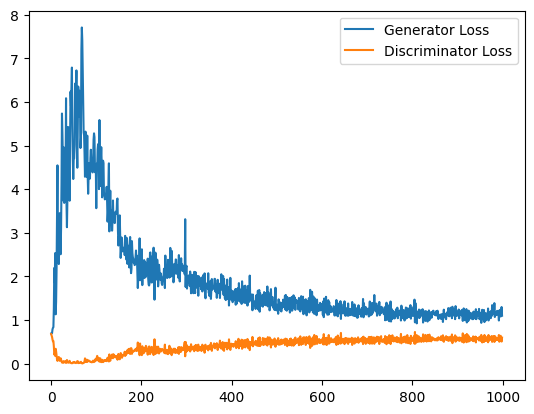

  0%|          | 0/469 [00:00<?, ?it/s]

Step 20500: Generator loss: 1.137596640586853, discriminator loss: 0.5733729250431061


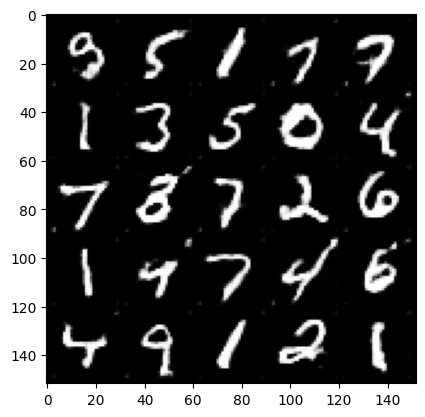

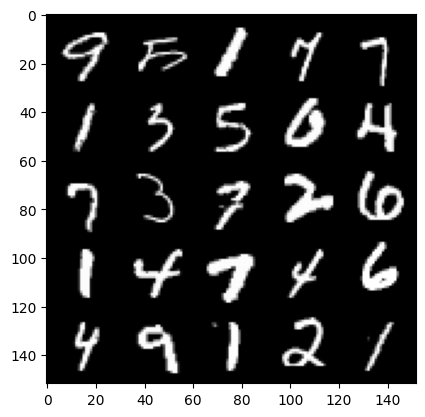

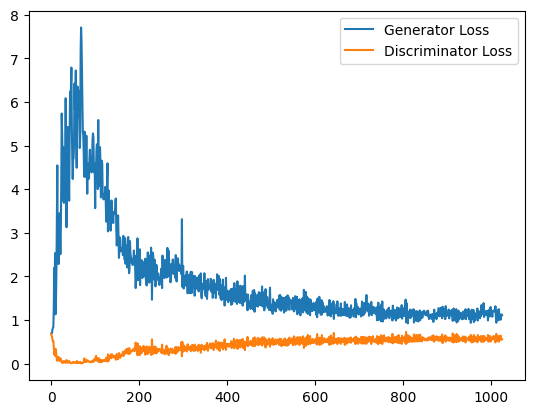

  0%|          | 0/469 [00:00<?, ?it/s]

Step 21000: Generator loss: 1.0961010528802873, discriminator loss: 0.570442491710186


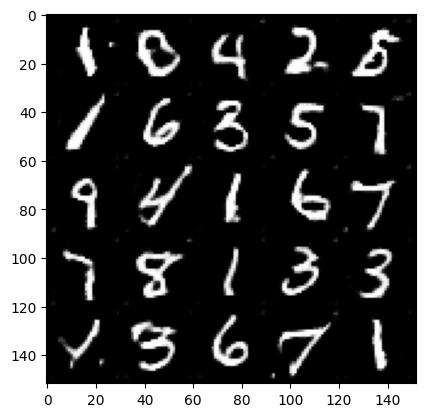

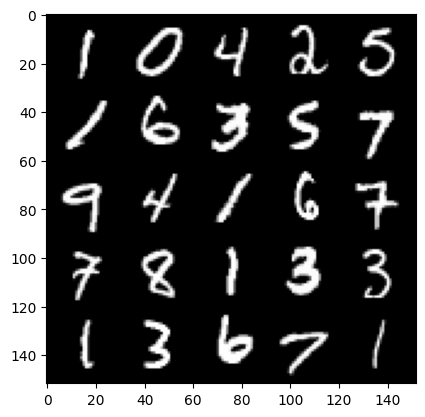

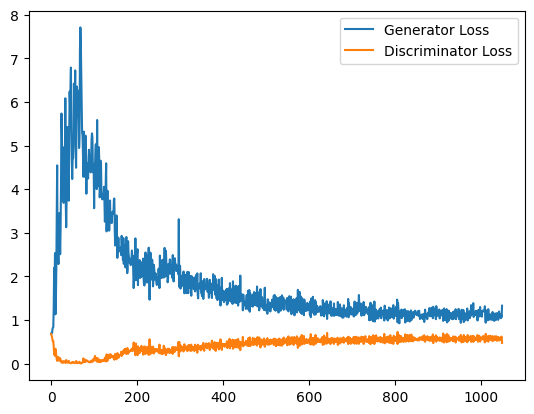

  0%|          | 0/469 [00:00<?, ?it/s]

Step 21500: Generator loss: 1.1046035556793212, discriminator loss: 0.5728436691164971


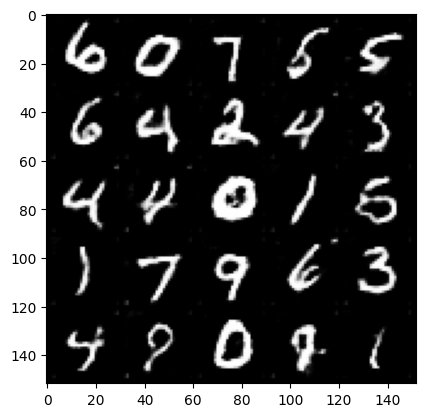

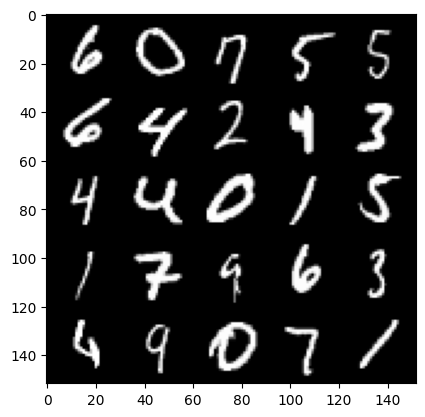

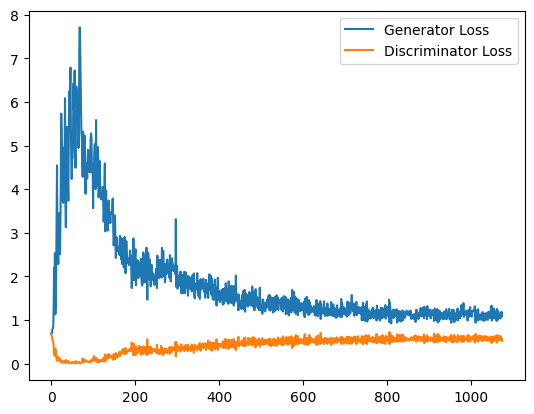

  0%|          | 0/469 [00:00<?, ?it/s]

Step 22000: Generator loss: 1.1188226084709167, discriminator loss: 0.5772529093623161


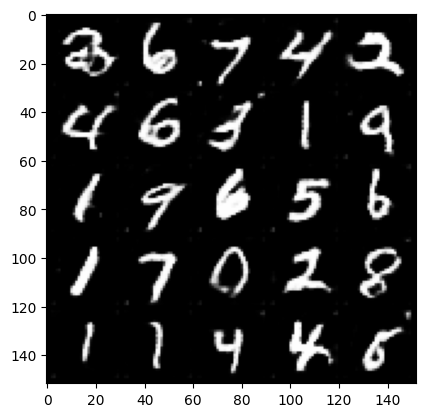

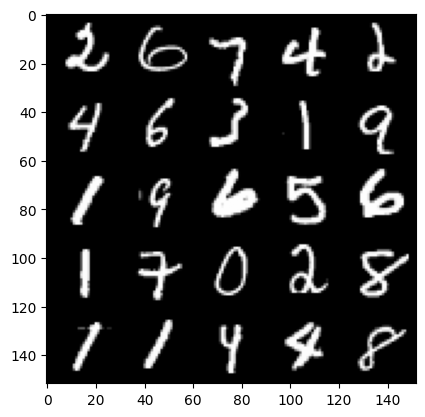

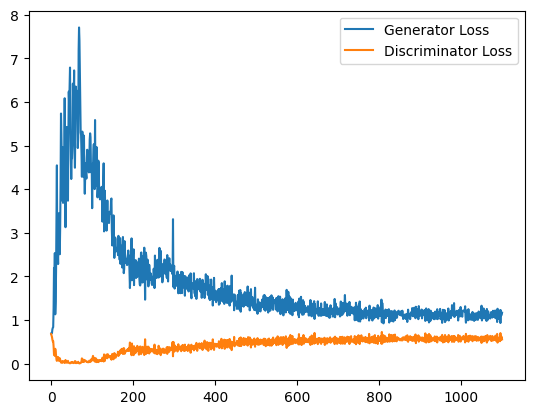

  0%|          | 0/469 [00:00<?, ?it/s]

Step 22500: Generator loss: 1.0934584954977036, discriminator loss: 0.5775534911155701


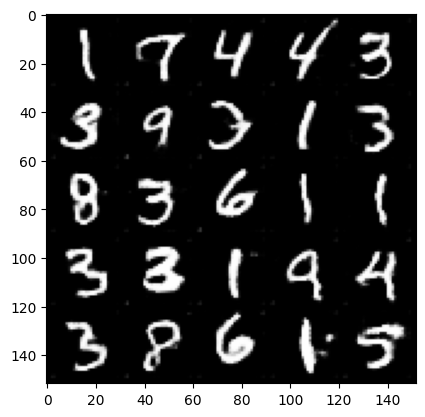

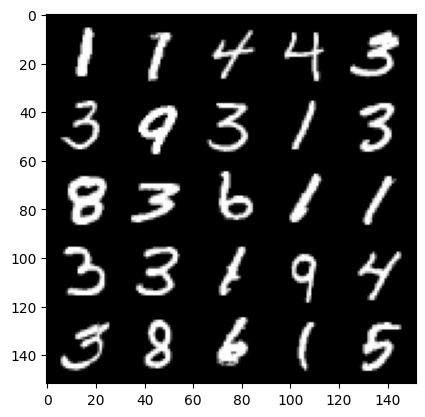

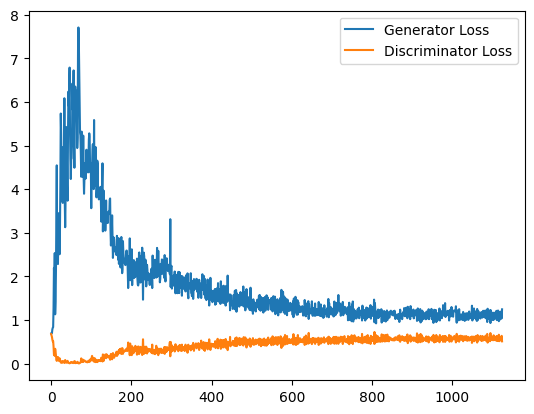

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

Step 23000: Generator loss: 1.0647721152305603, discriminator loss: 0.5857676853537559


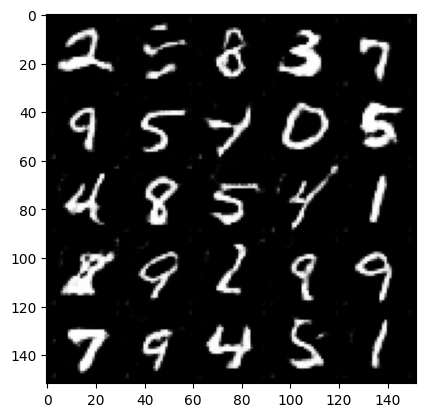

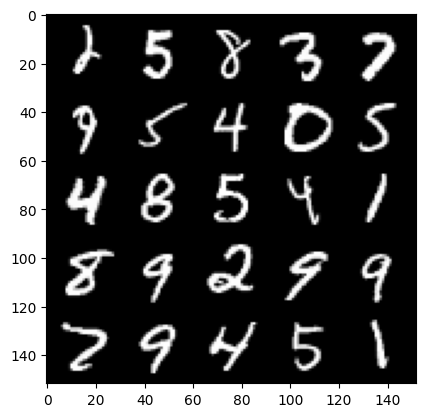

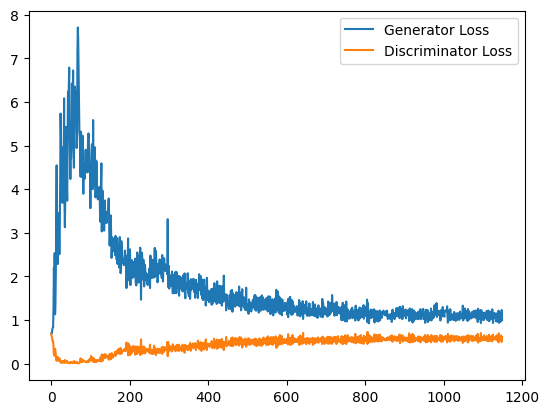

  0%|          | 0/469 [00:00<?, ?it/s]

Step 23500: Generator loss: 1.0649360275268556, discriminator loss: 0.5803999269604683


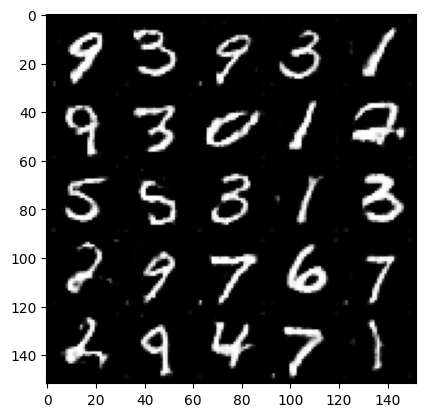

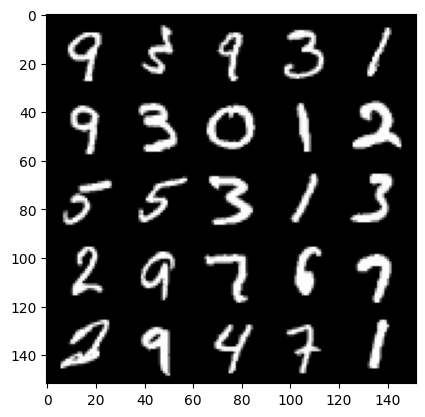

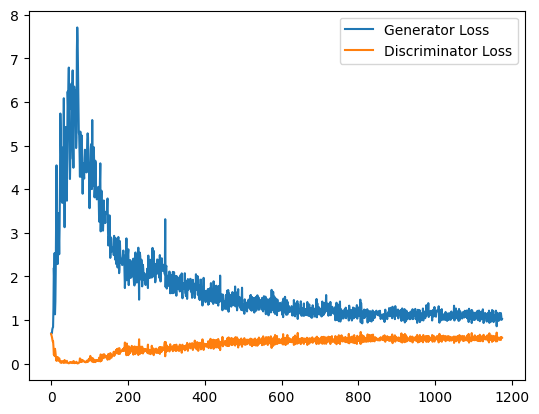

  0%|          | 0/469 [00:00<?, ?it/s]

Step 24000: Generator loss: 1.0708090287446976, discriminator loss: 0.5868530789613724


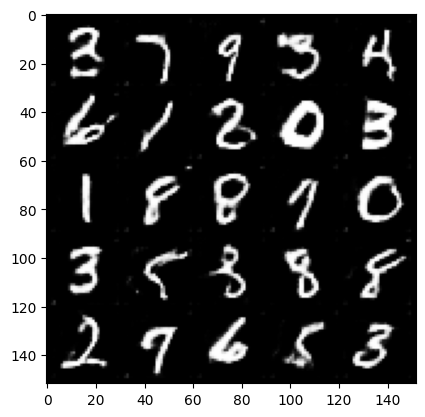

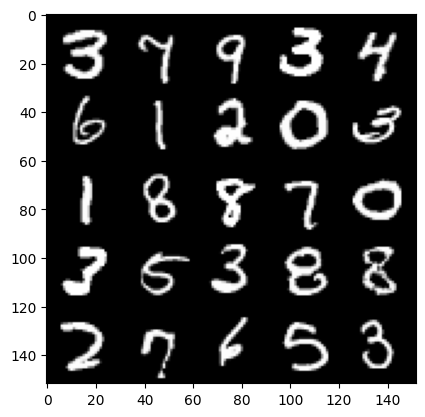

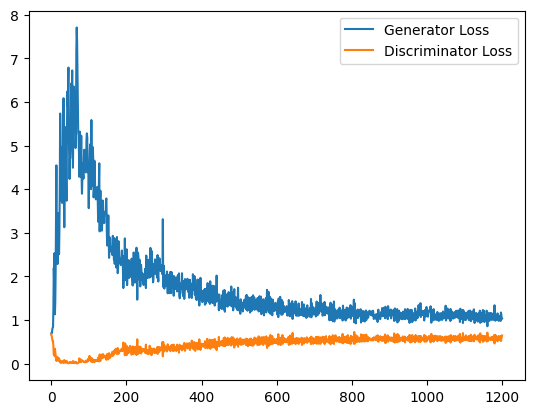

  0%|          | 0/469 [00:00<?, ?it/s]

Step 24500: Generator loss: 1.07701172041893, discriminator loss: 0.58210461384058


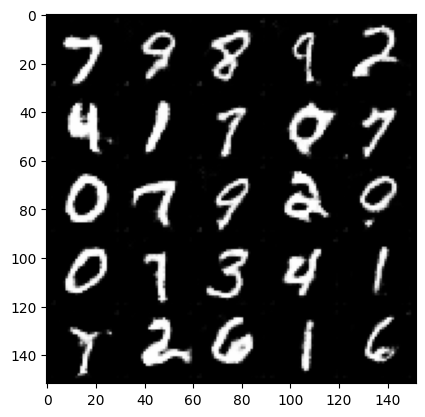

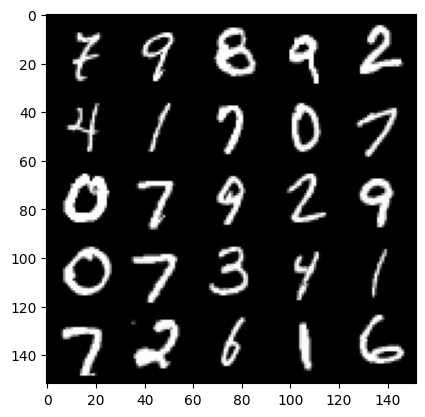

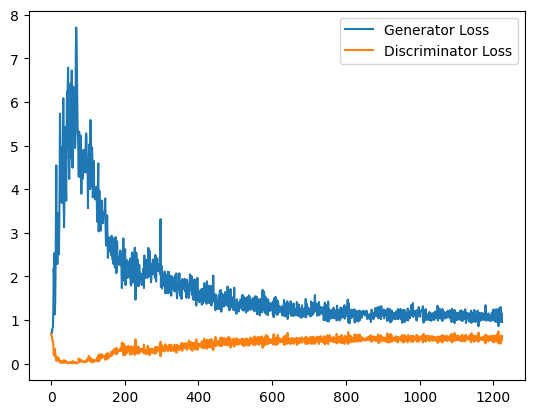

  0%|          | 0/469 [00:00<?, ?it/s]

Step 25000: Generator loss: 1.0669214190244676, discriminator loss: 0.5790401333570481


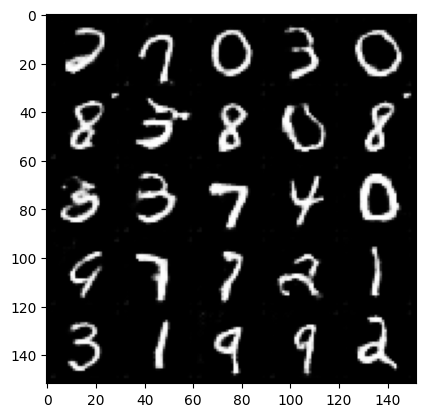

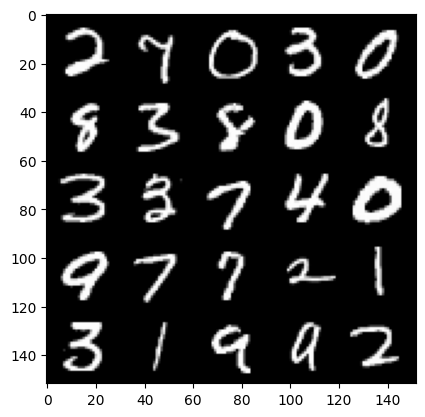

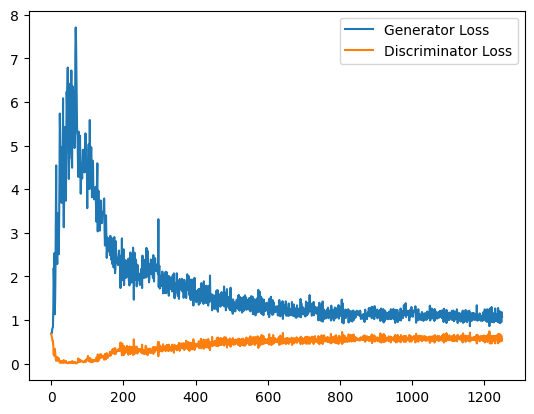

  0%|          | 0/469 [00:00<?, ?it/s]

Step 25500: Generator loss: 1.0484423995018006, discriminator loss: 0.582247753560543


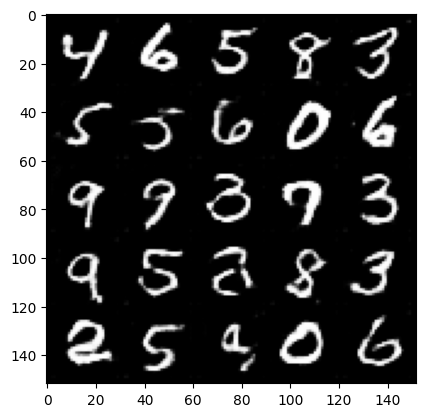

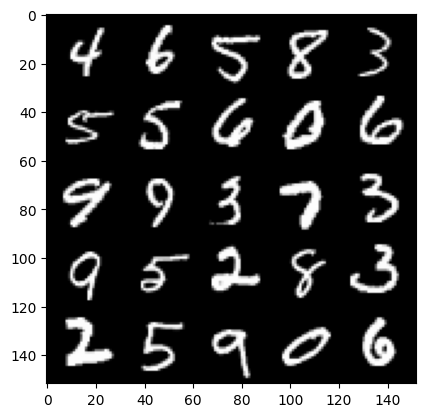

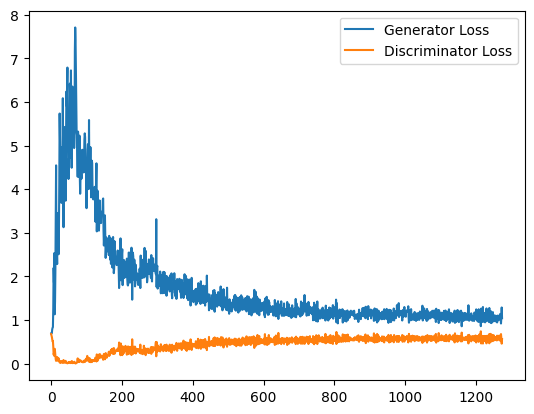

  0%|          | 0/469 [00:00<?, ?it/s]

Step 26000: Generator loss: 1.0314765268564223, discriminator loss: 0.5882158625125885


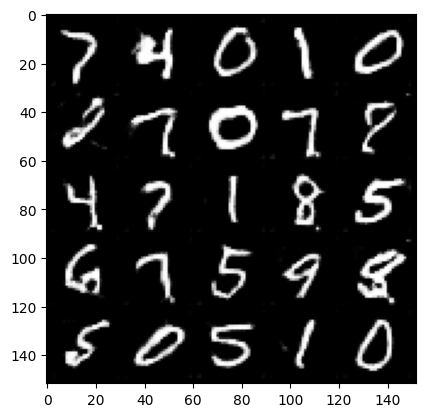

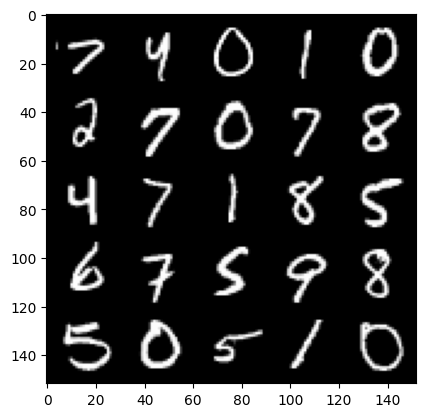

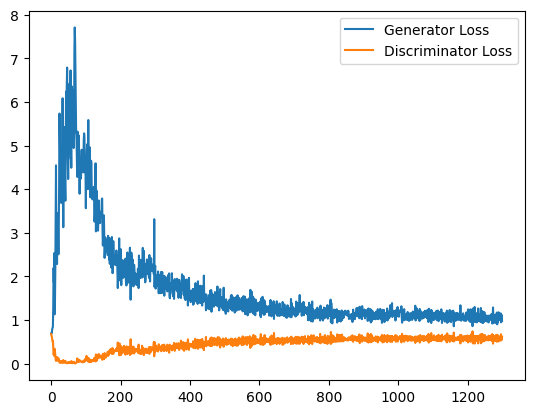

  0%|          | 0/469 [00:00<?, ?it/s]

Step 26500: Generator loss: 1.0567934315204621, discriminator loss: 0.5788958601355553


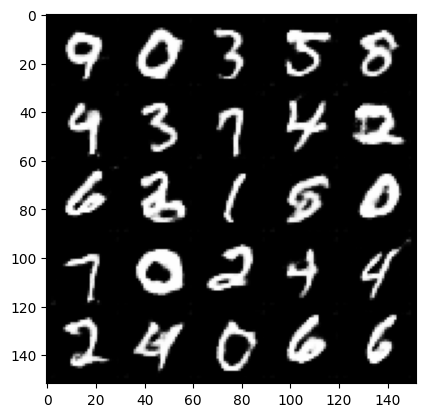

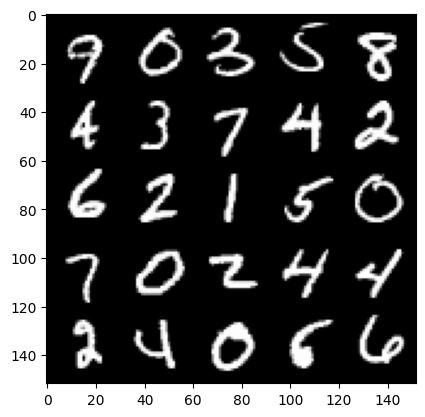

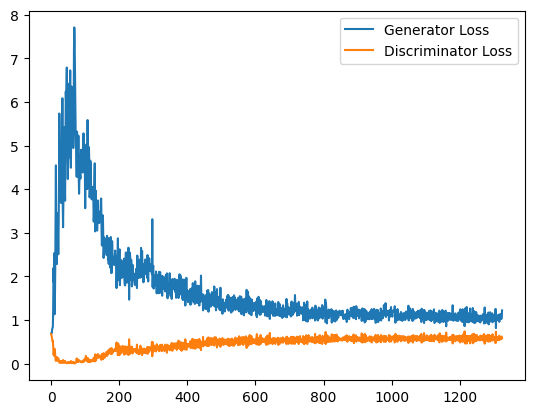

  0%|          | 0/469 [00:00<?, ?it/s]

Step 27000: Generator loss: 1.0362828003168105, discriminator loss: 0.5901994262933731


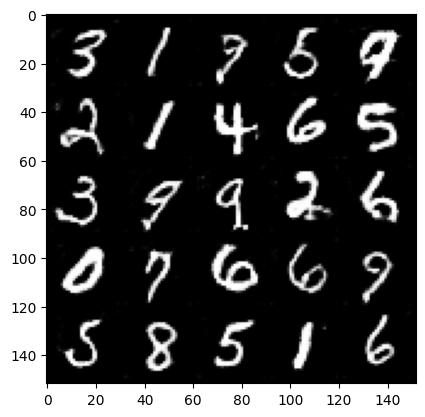

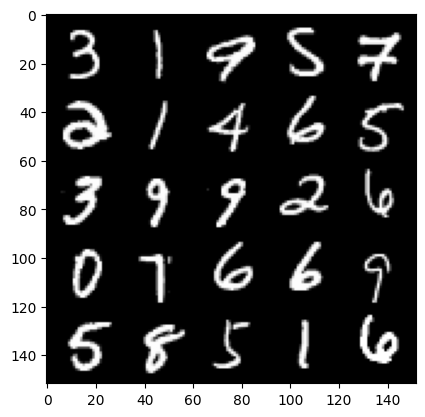

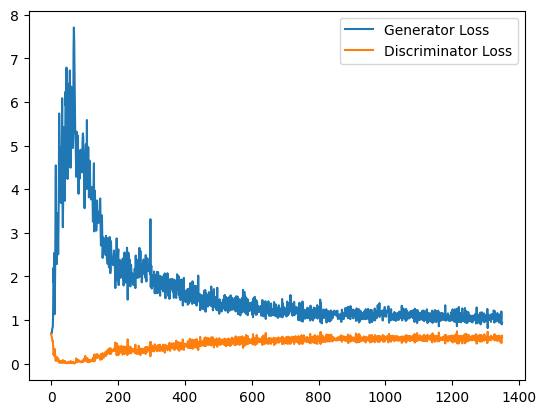

  0%|          | 0/469 [00:00<?, ?it/s]

Step 27500: Generator loss: 1.040171473622322, discriminator loss: 0.5816100834012031


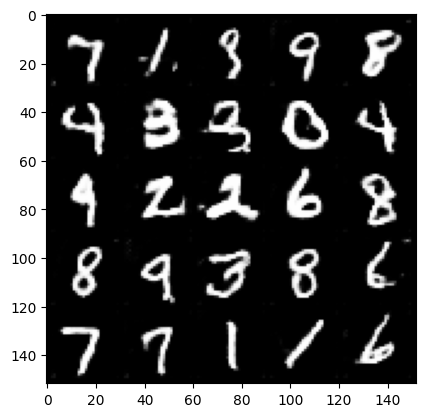

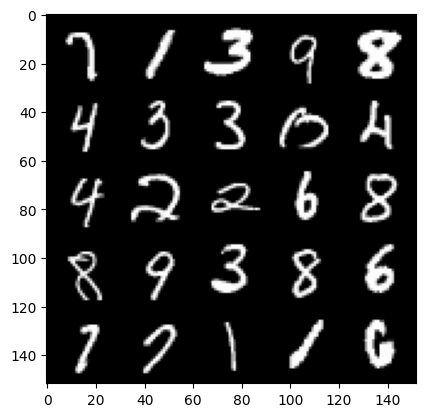

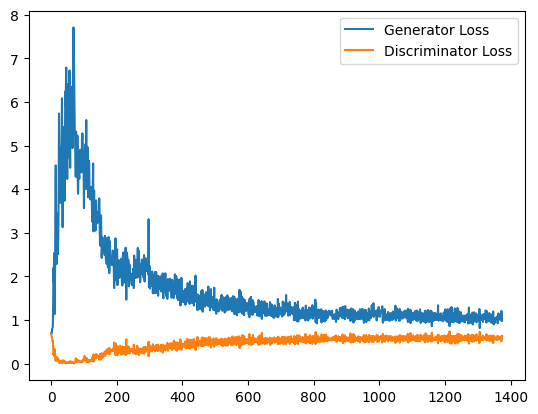

  0%|          | 0/469 [00:00<?, ?it/s]

Step 28000: Generator loss: 1.0119787364006043, discriminator loss: 0.5877177253961563


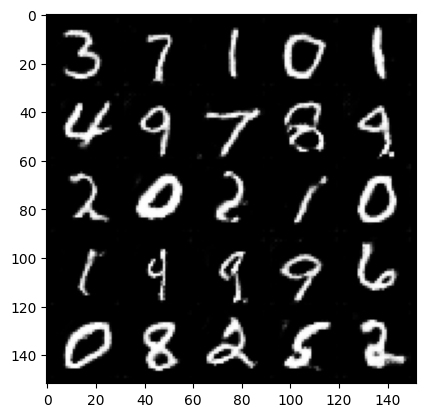

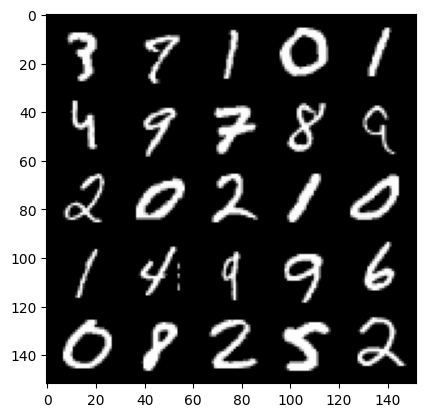

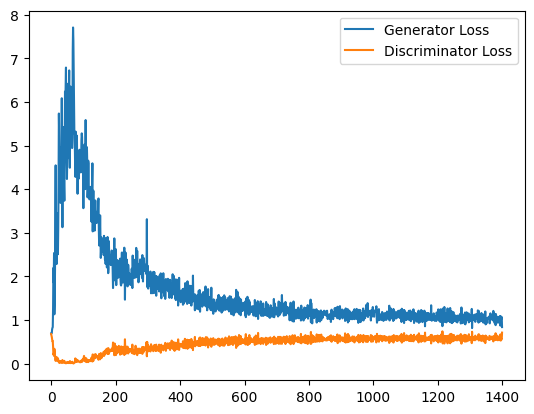

  0%|          | 0/469 [00:00<?, ?it/s]

Step 28500: Generator loss: 1.0395081255435943, discriminator loss: 0.5781018355488777


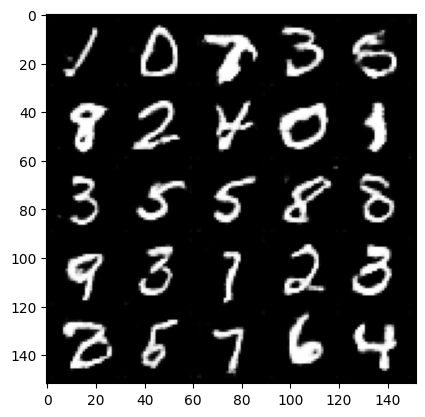

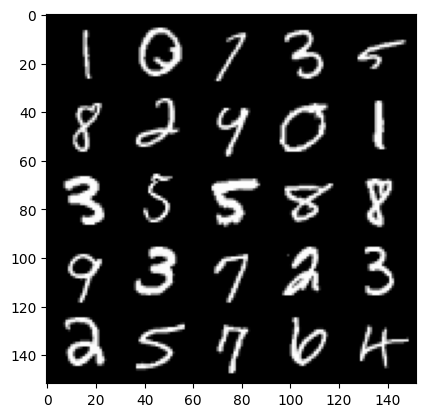

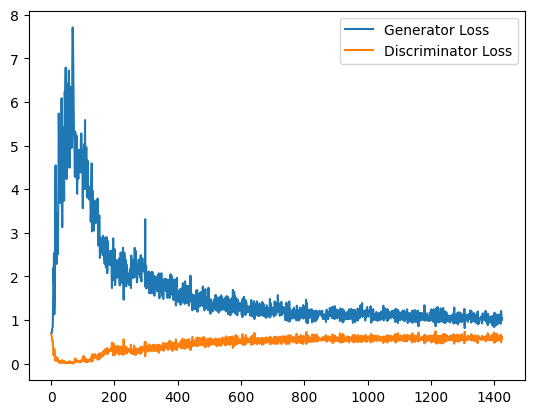

  0%|          | 0/469 [00:00<?, ?it/s]

Step 29000: Generator loss: 1.0805267810821533, discriminator loss: 0.5808767640590667


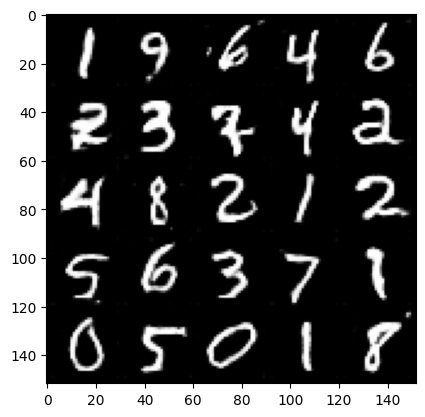

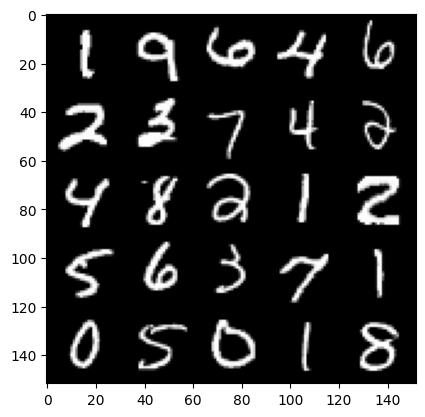

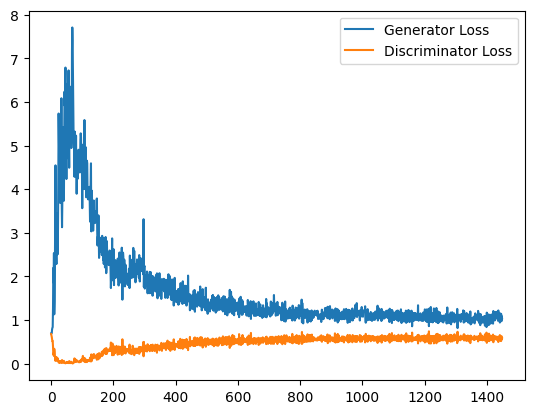

  0%|          | 0/469 [00:00<?, ?it/s]

Step 29500: Generator loss: 1.0396932785511017, discriminator loss: 0.5875694190263748


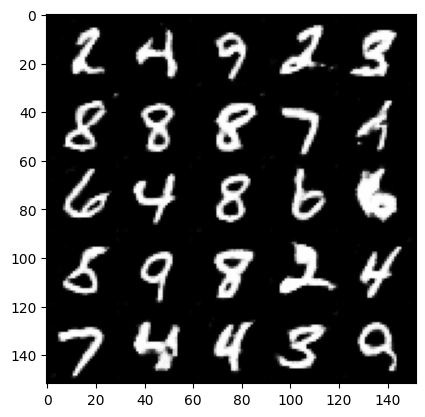

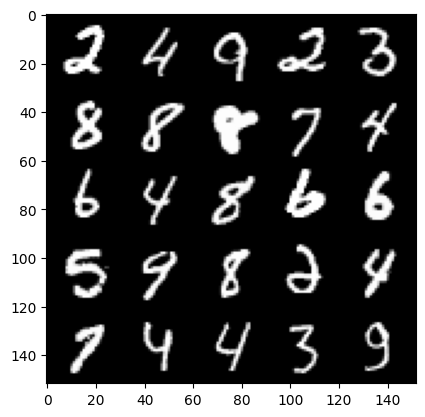

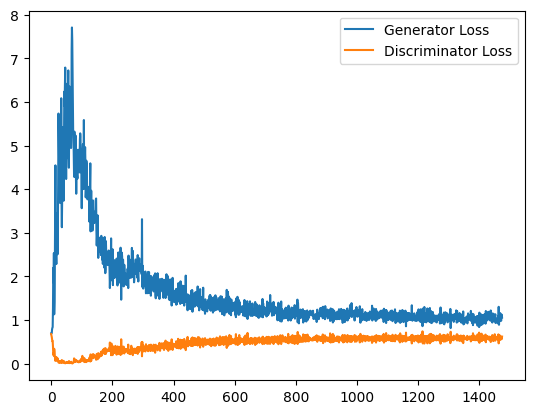

  0%|          | 0/469 [00:00<?, ?it/s]

Step 30000: Generator loss: 1.070137601017952, discriminator loss: 0.5848363018631935


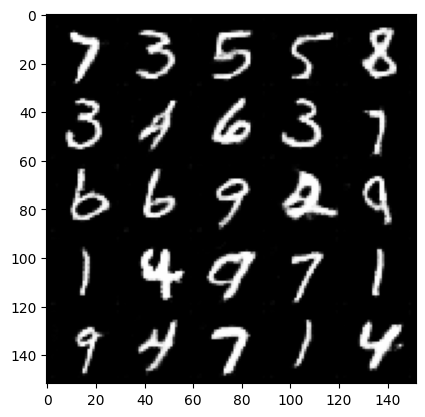

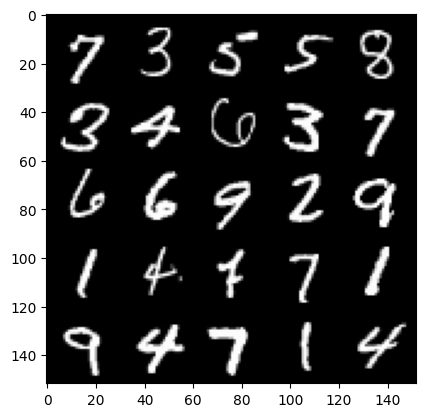

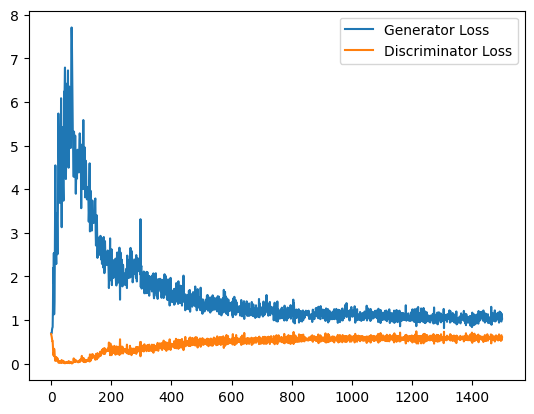

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

Step 30500: Generator loss: 1.0631251665353776, discriminator loss: 0.5855762072205544


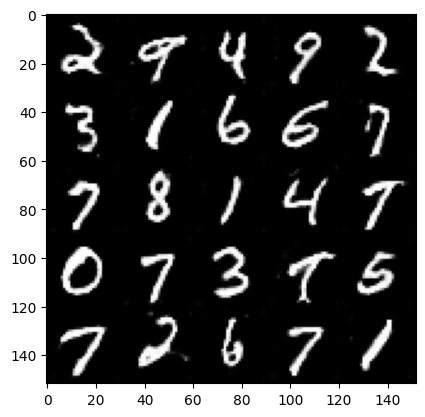

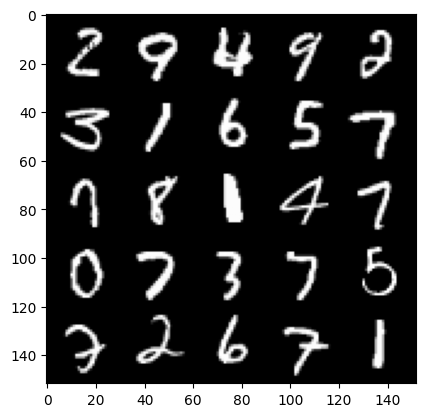

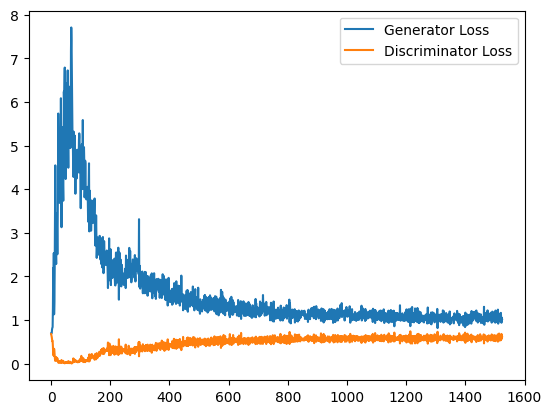

  0%|          | 0/469 [00:00<?, ?it/s]

Step 31000: Generator loss: 1.0318124212026596, discriminator loss: 0.5864047196507454


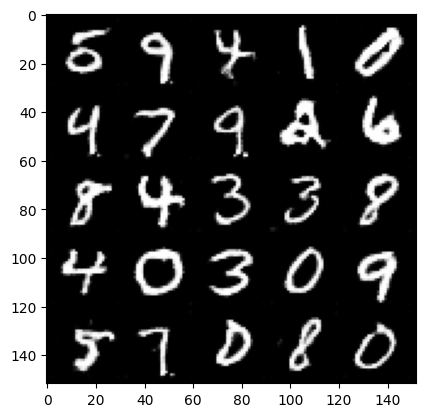

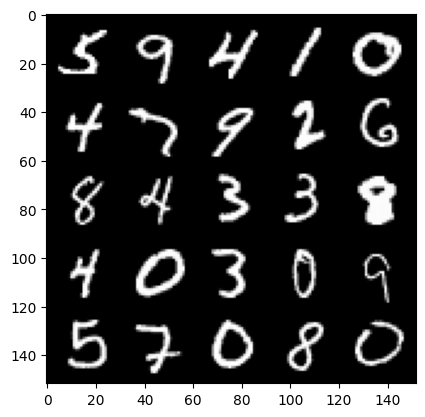

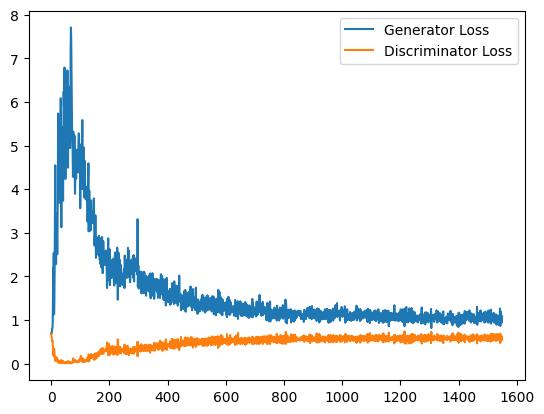

  0%|          | 0/469 [00:00<?, ?it/s]

Step 31500: Generator loss: 1.0382918981313705, discriminator loss: 0.5872267510294914


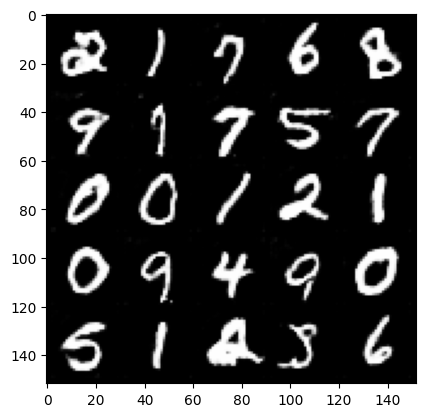

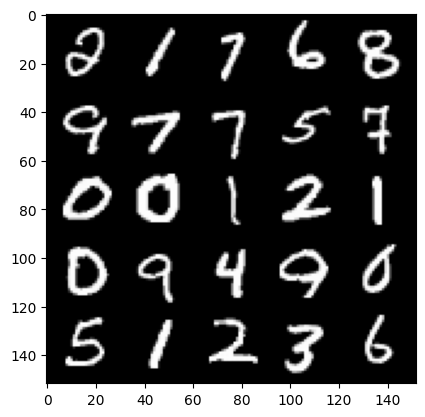

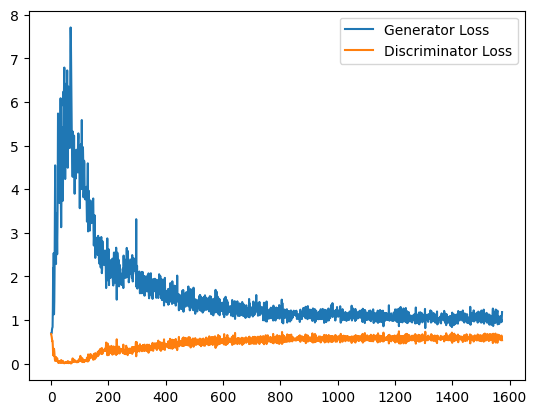

  0%|          | 0/469 [00:00<?, ?it/s]

Step 32000: Generator loss: 1.0621287789344787, discriminator loss: 0.5860200870633125


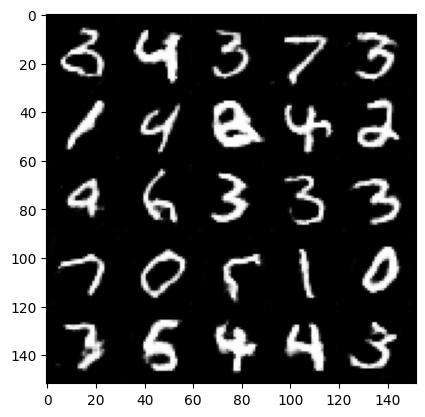

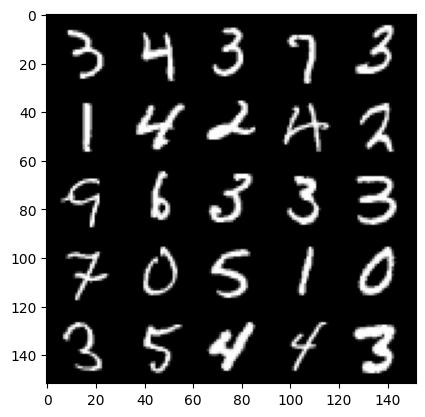

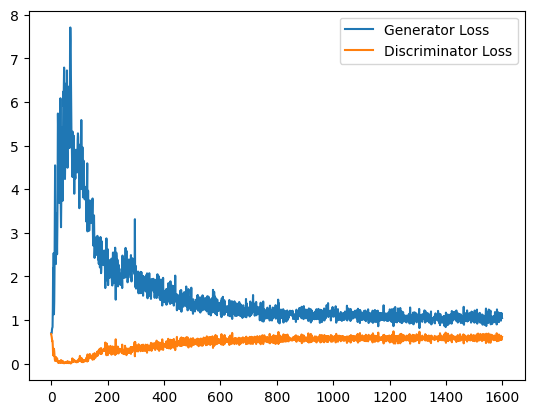

  0%|          | 0/469 [00:00<?, ?it/s]

Step 32500: Generator loss: 1.0546817420721053, discriminator loss: 0.5851448765397071


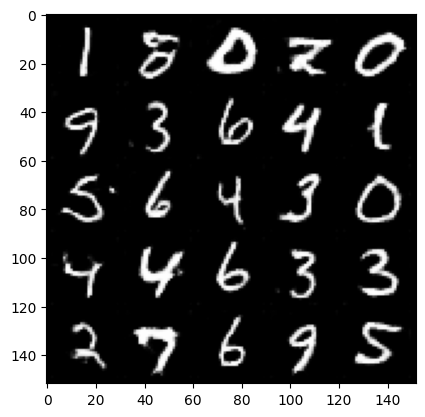

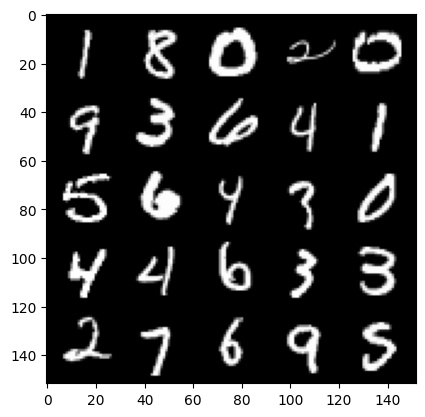

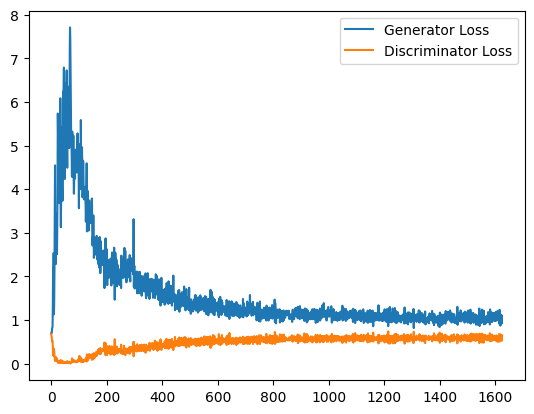

  0%|          | 0/469 [00:00<?, ?it/s]

Step 33000: Generator loss: 1.0105607285499574, discriminator loss: 0.5843870342969895


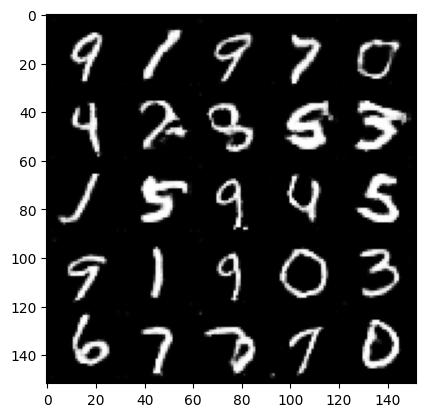

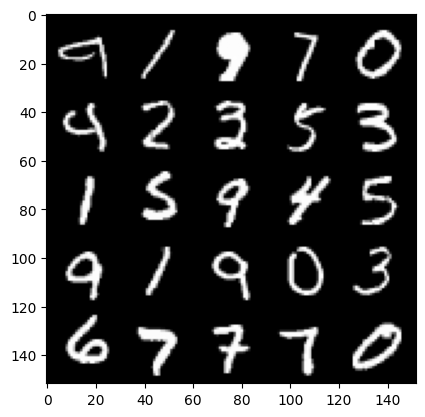

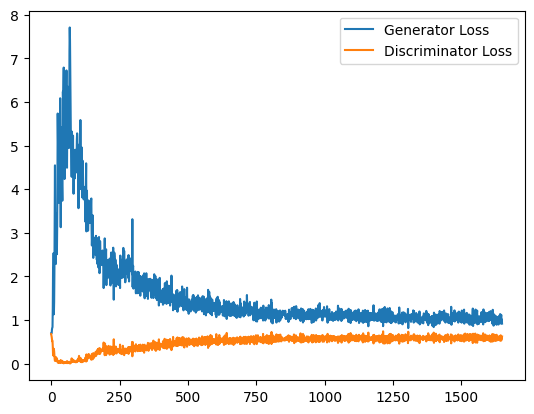

  0%|          | 0/469 [00:00<?, ?it/s]

Step 33500: Generator loss: 1.0484779856204987, discriminator loss: 0.5875373287796974


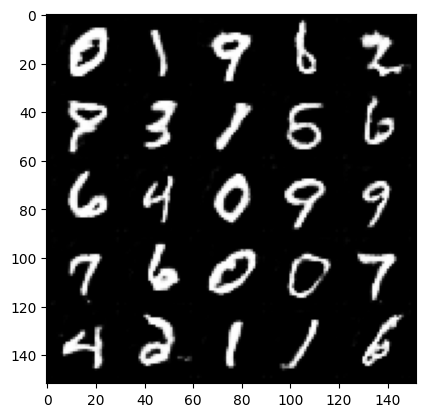

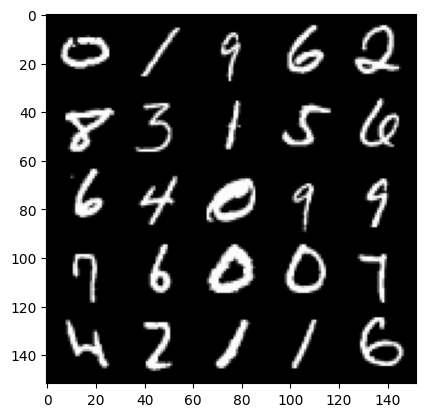

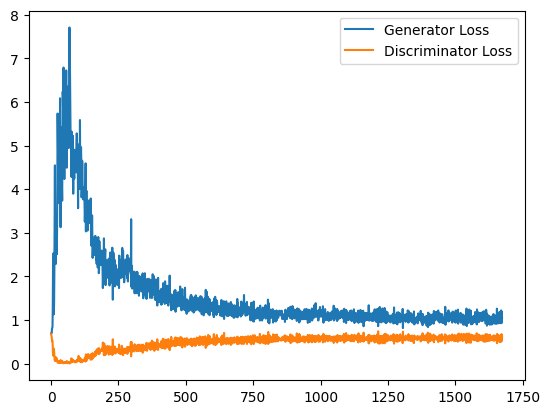

  0%|          | 0/469 [00:00<?, ?it/s]

Step 34000: Generator loss: 1.0377499214410781, discriminator loss: 0.5837438111901283


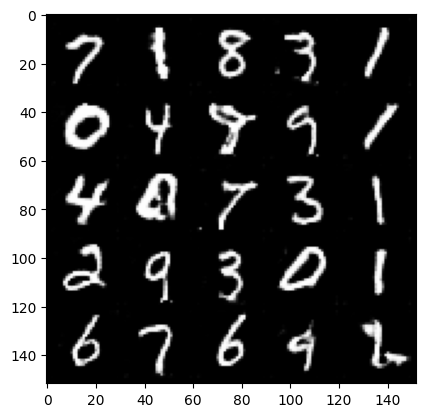

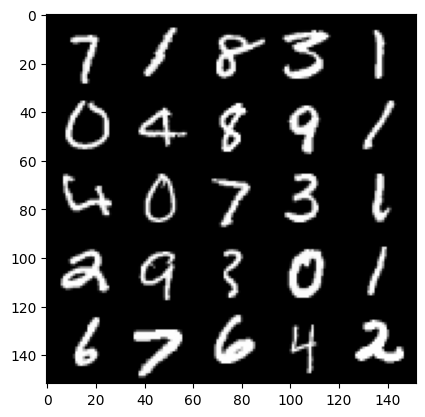

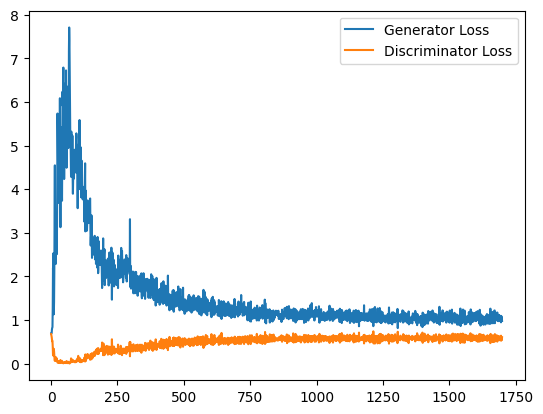

  0%|          | 0/469 [00:00<?, ?it/s]

Step 34500: Generator loss: 1.0277556473016738, discriminator loss: 0.5840136297345161


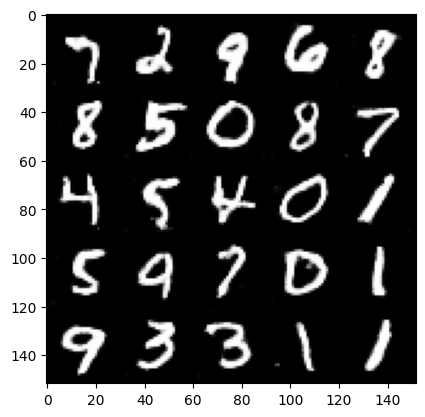

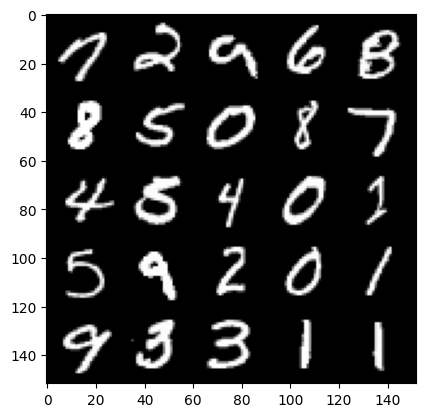

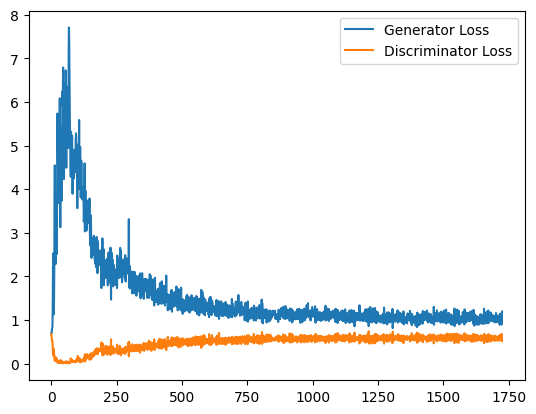

  0%|          | 0/469 [00:00<?, ?it/s]

Step 35000: Generator loss: 1.0484284473657608, discriminator loss: 0.5844683273434639


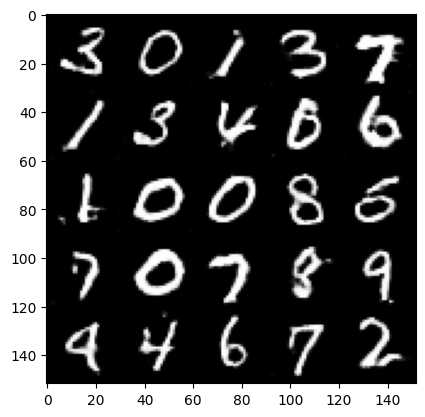

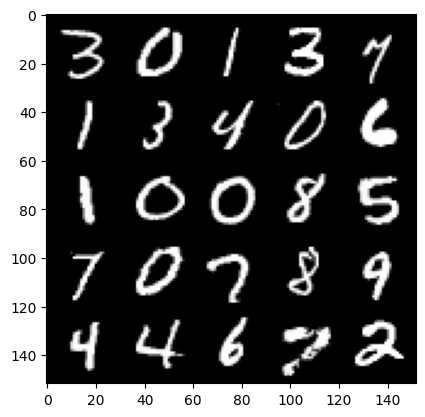

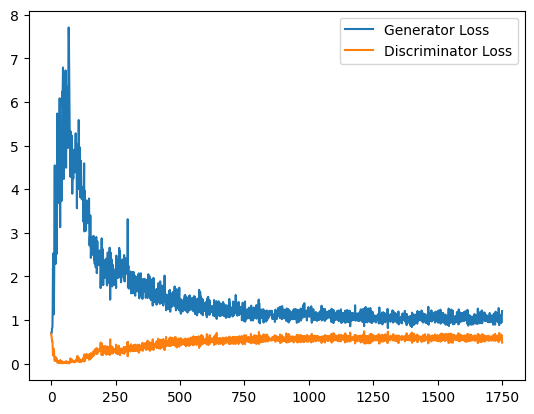

  0%|          | 0/469 [00:00<?, ?it/s]

Step 35500: Generator loss: 1.023117782831192, discriminator loss: 0.5864427883028984


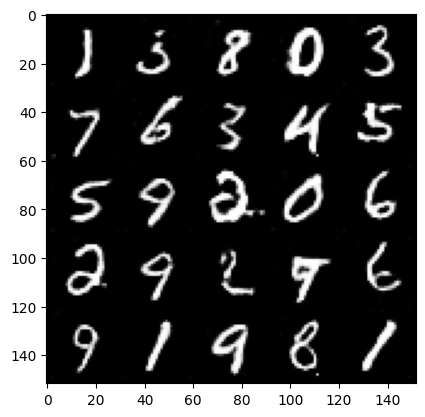

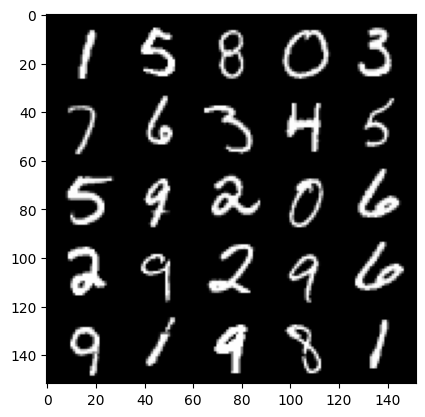

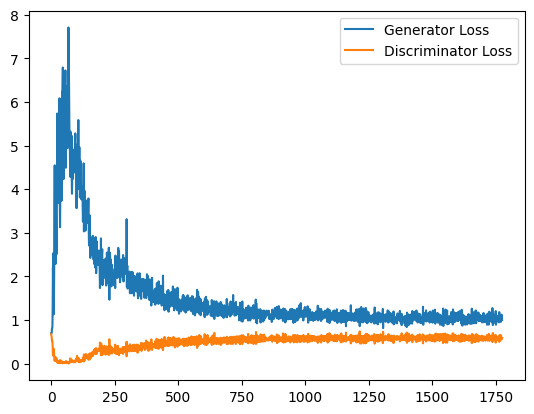

  0%|          | 0/469 [00:00<?, ?it/s]

Step 36000: Generator loss: 1.0458824143409728, discriminator loss: 0.5847938036322594


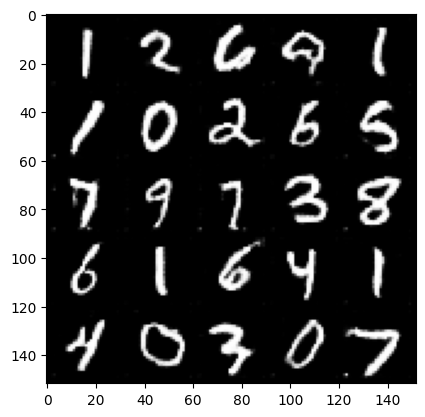

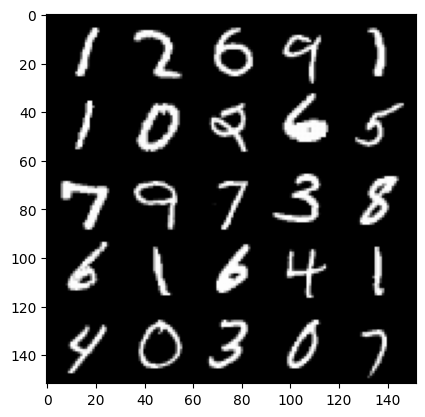

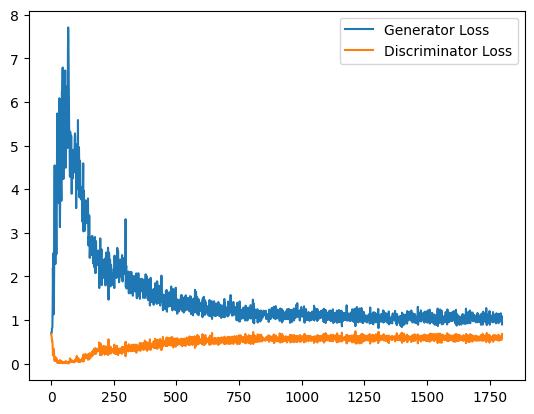

  0%|          | 0/469 [00:00<?, ?it/s]

Step 36500: Generator loss: 1.0379733018875121, discriminator loss: 0.5836069548130035


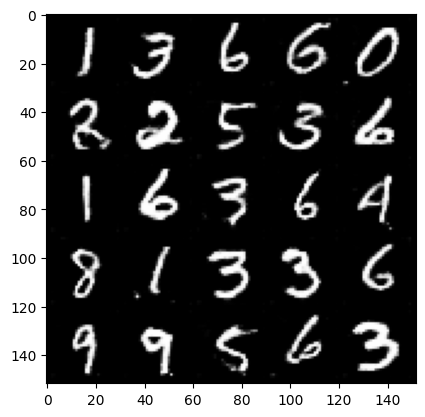

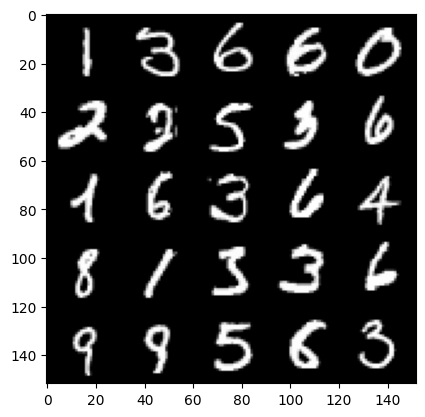

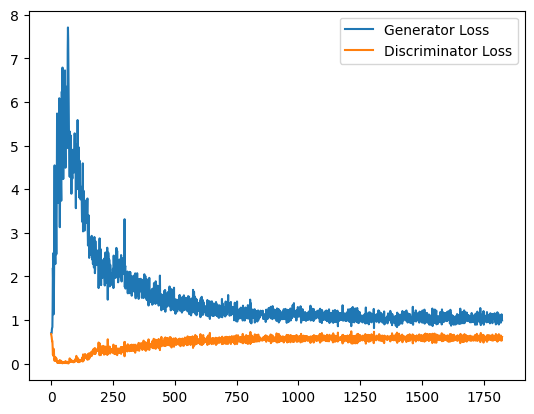

  0%|          | 0/469 [00:00<?, ?it/s]

Step 37000: Generator loss: 1.0547811089754104, discriminator loss: 0.5826868240237236


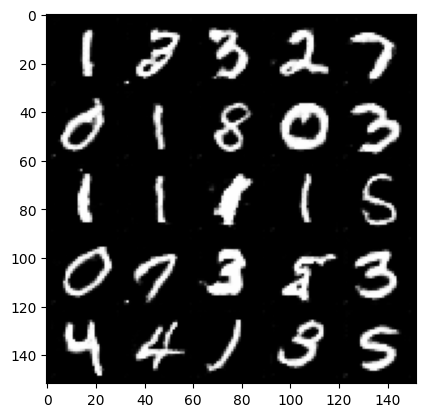

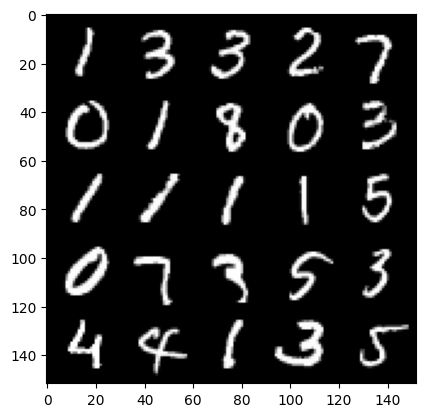

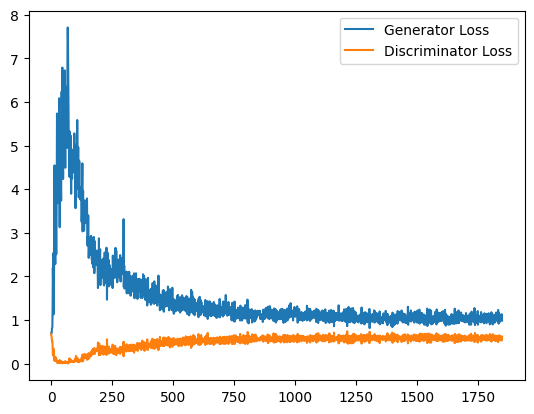

  0%|          | 0/469 [00:00<?, ?it/s]

Step 37500: Generator loss: 1.0447691626548767, discriminator loss: 0.5836782900691032


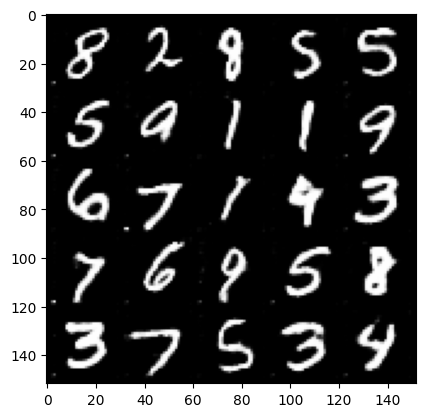

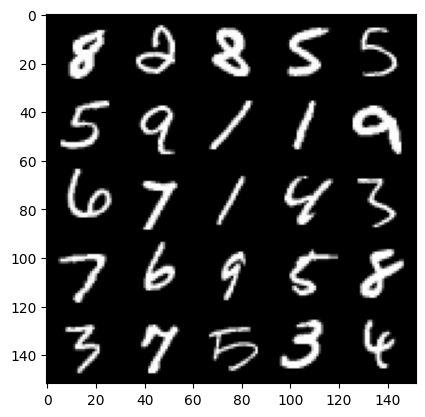

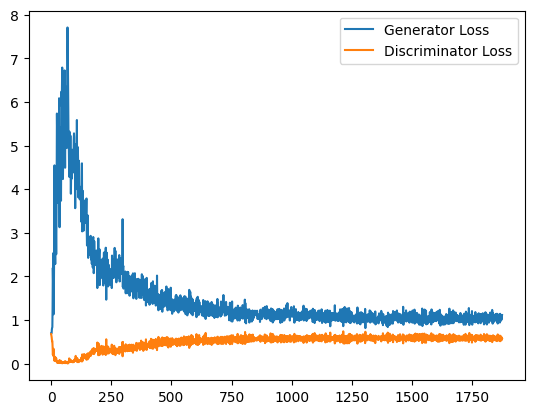

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

Step 38000: Generator loss: 1.0573622596263885, discriminator loss: 0.580896286547184


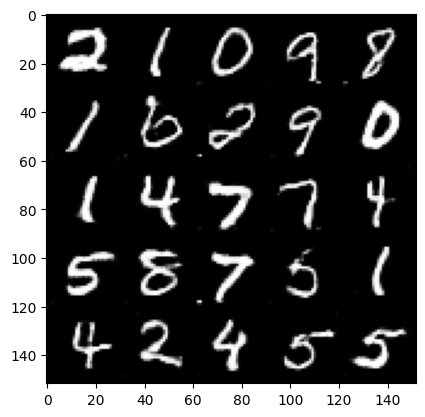

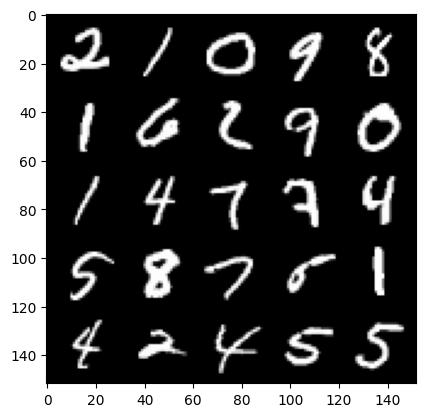

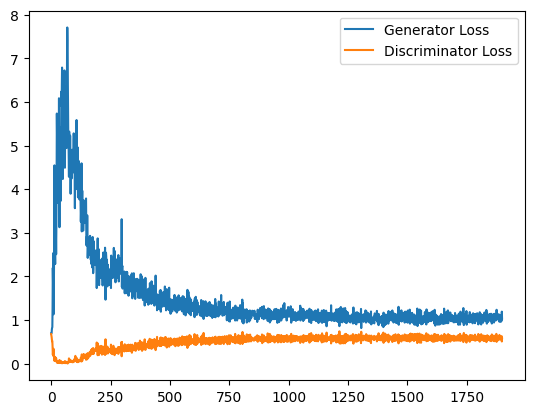

  0%|          | 0/469 [00:00<?, ?it/s]

Step 38500: Generator loss: 1.0326144119501115, discriminator loss: 0.5861897290945053


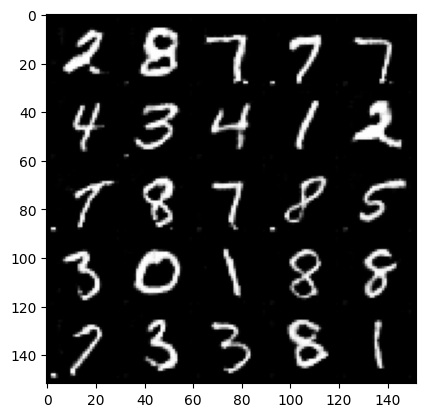

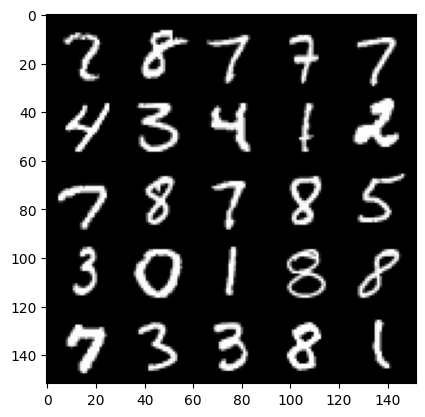

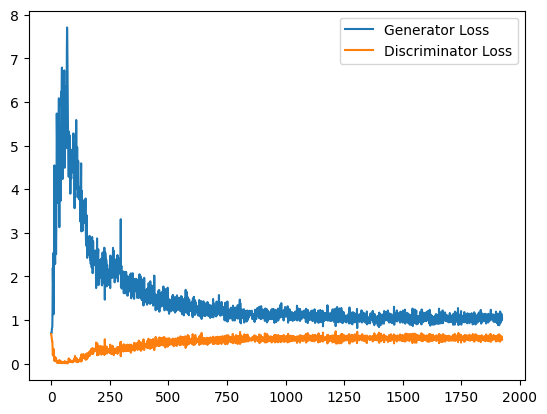

  0%|          | 0/469 [00:00<?, ?it/s]

Step 39000: Generator loss: 1.0501429624557495, discriminator loss: 0.5813959351778031


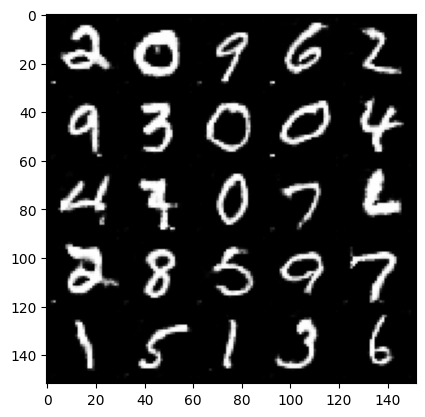

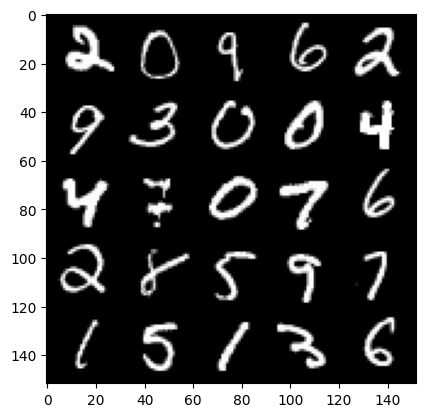

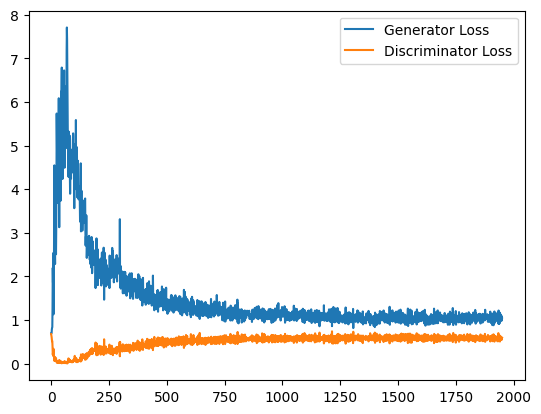

  0%|          | 0/469 [00:00<?, ?it/s]

Step 39500: Generator loss: 1.0628208496570588, discriminator loss: 0.5803654645681381


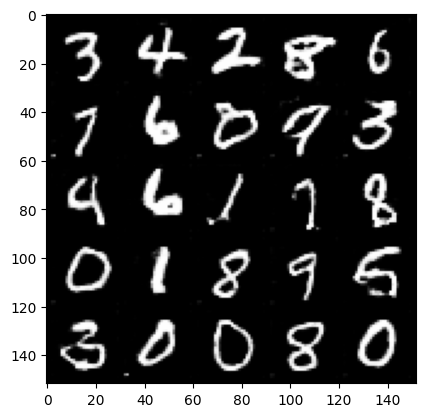

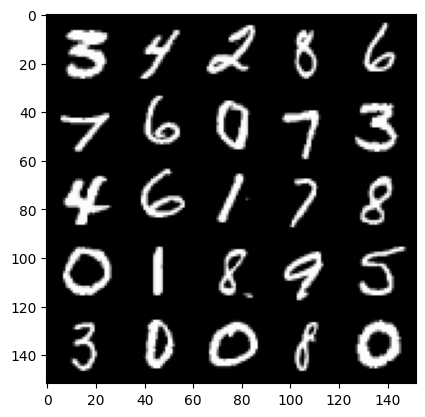

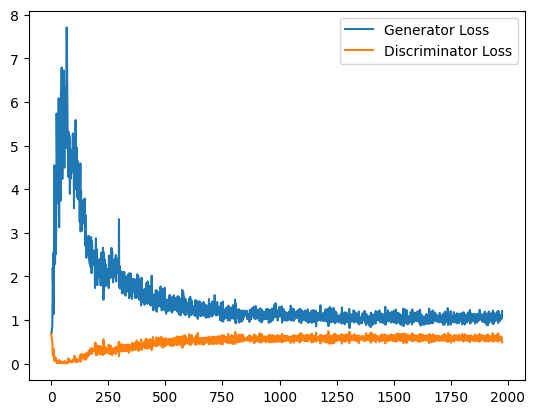

  0%|          | 0/469 [00:00<?, ?it/s]

Step 40000: Generator loss: 1.0303802943229676, discriminator loss: 0.5848238794207573


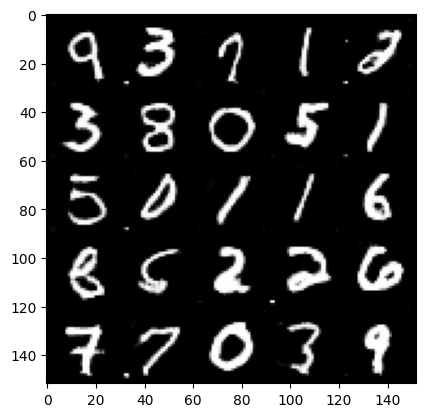

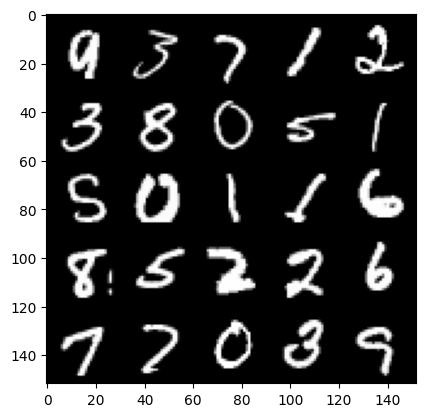

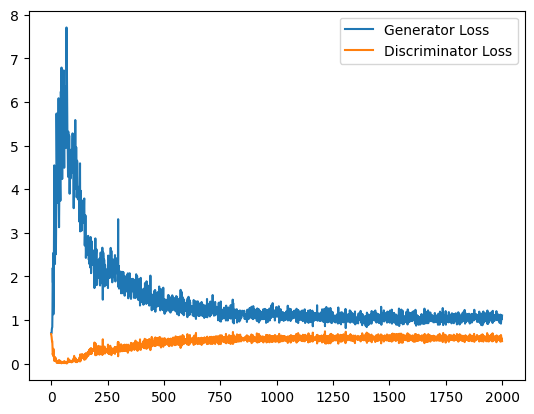

  0%|          | 0/469 [00:00<?, ?it/s]

Step 40500: Generator loss: 1.045688178420067, discriminator loss: 0.5807557750344277


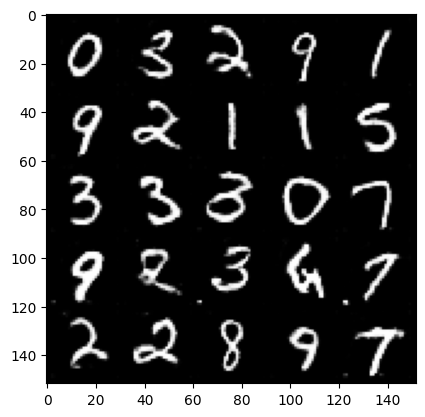

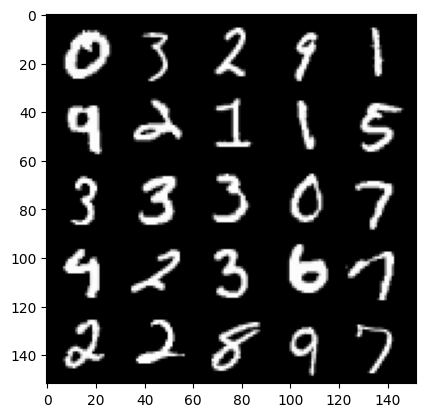

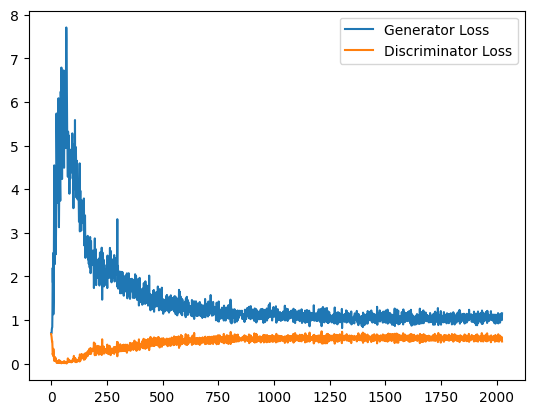

  0%|          | 0/469 [00:00<?, ?it/s]

Step 41000: Generator loss: 1.0349854048490523, discriminator loss: 0.5842292949557304


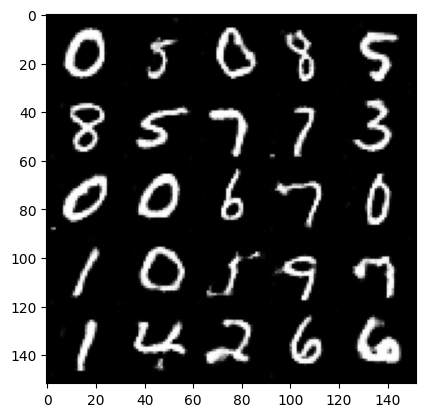

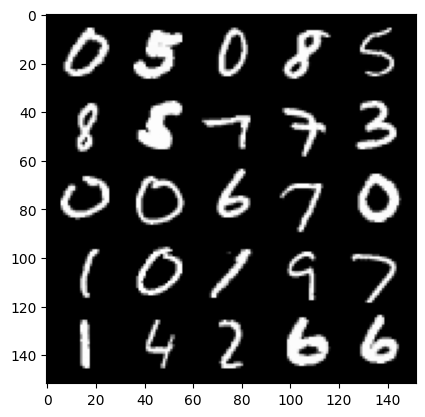

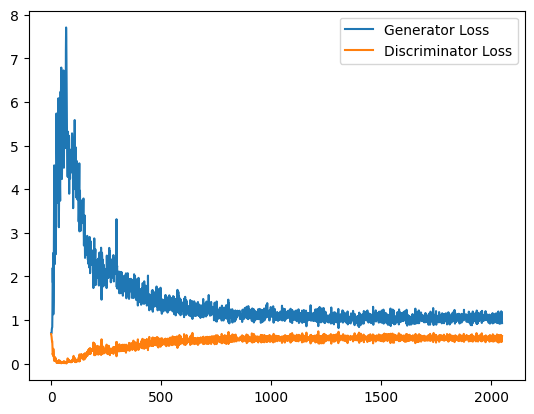

  0%|          | 0/469 [00:00<?, ?it/s]

Step 41500: Generator loss: 1.0470444931983949, discriminator loss: 0.5803522283434868


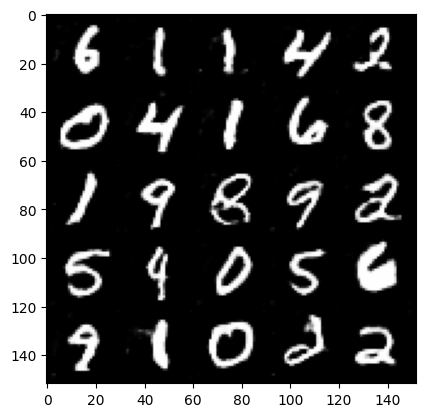

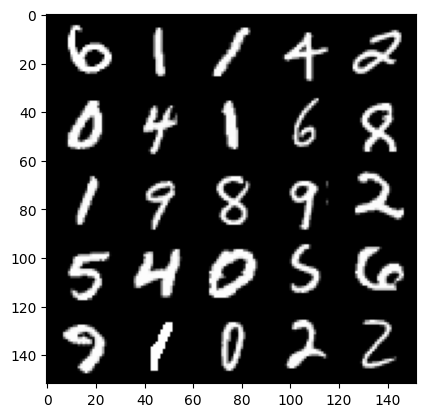

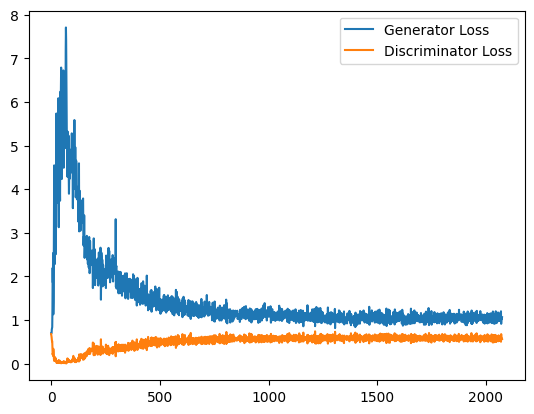

  0%|          | 0/469 [00:00<?, ?it/s]

Step 42000: Generator loss: 1.0482664642333985, discriminator loss: 0.5814807394742966


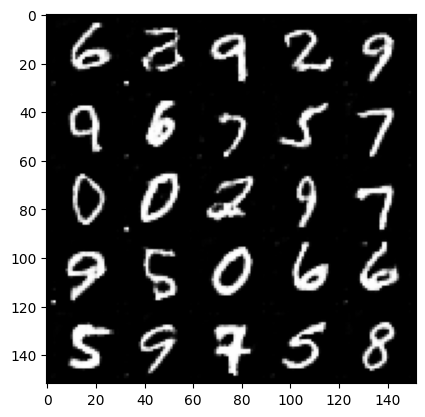

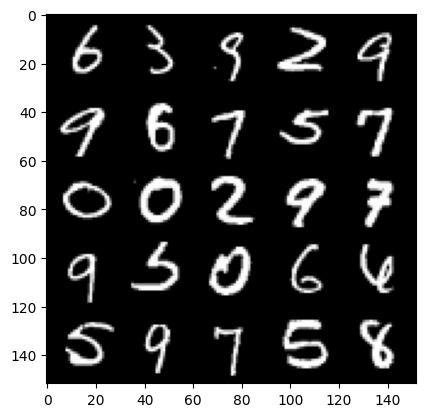

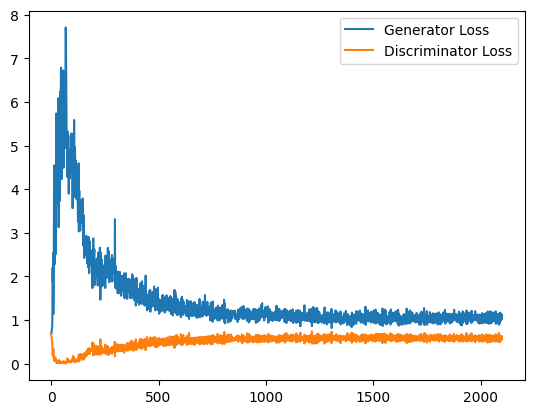

  0%|          | 0/469 [00:00<?, ?it/s]

Step 42500: Generator loss: 1.072328513264656, discriminator loss: 0.5820174047350883


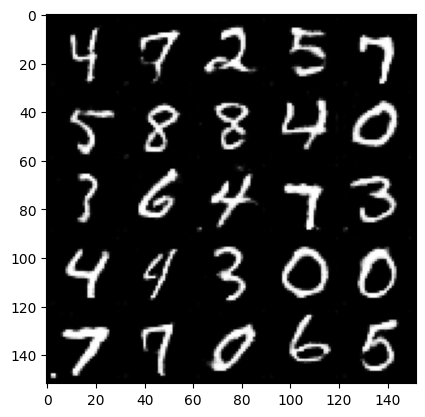

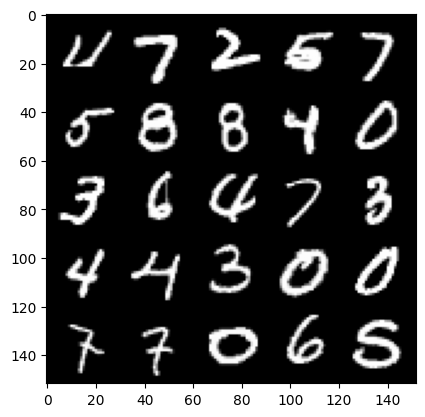

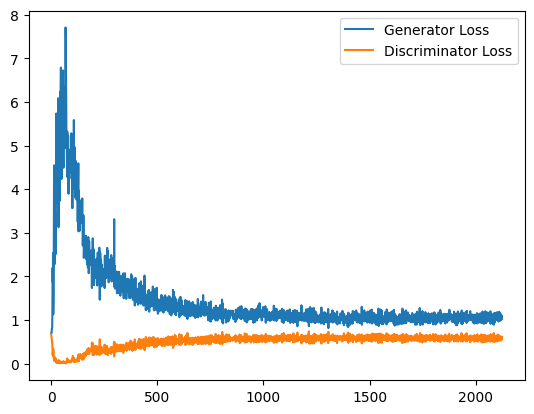

  0%|          | 0/469 [00:00<?, ?it/s]

Step 43000: Generator loss: 1.0369636787176133, discriminator loss: 0.5811091680526733


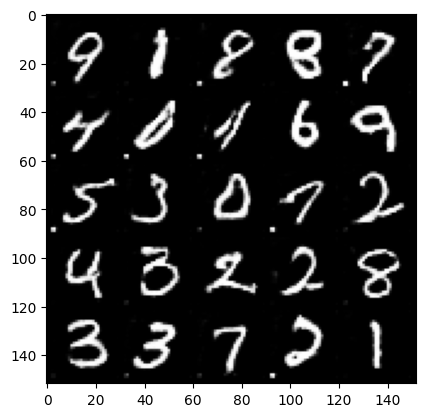

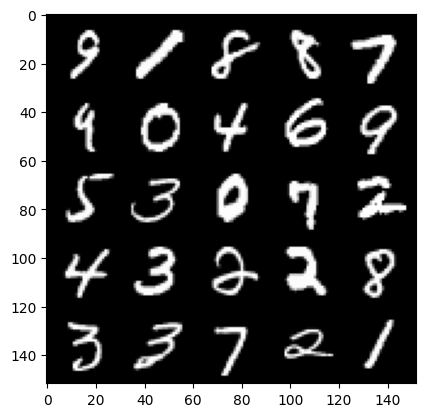

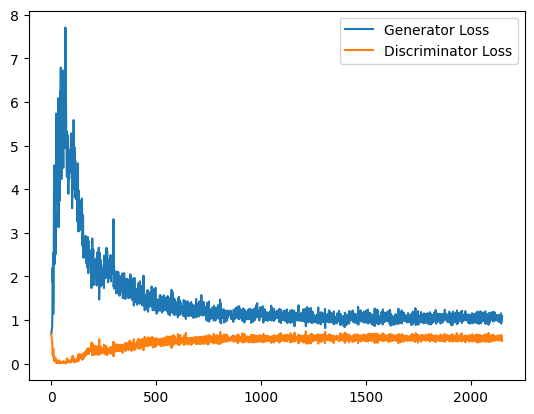

  0%|          | 0/469 [00:00<?, ?it/s]

Step 43500: Generator loss: 1.015607575893402, discriminator loss: 0.5814048193693161


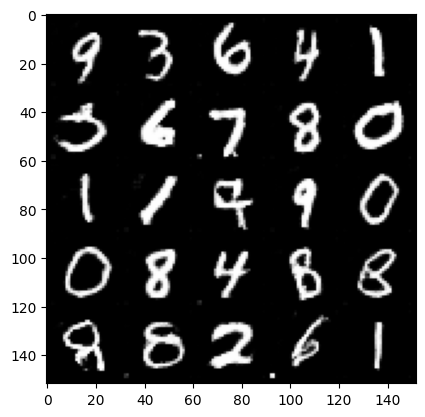

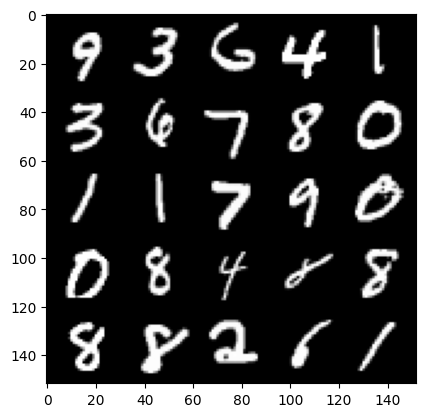

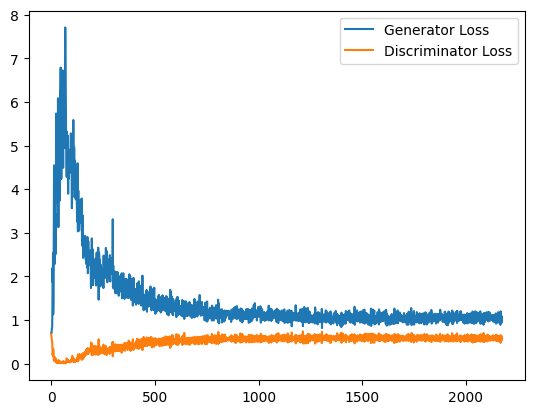

  0%|          | 0/469 [00:00<?, ?it/s]

Step 44000: Generator loss: 1.0537364511489868, discriminator loss: 0.5771943346858025


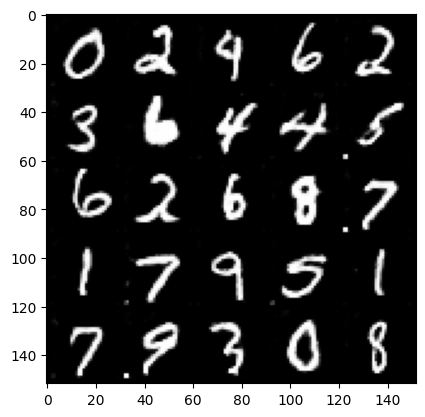

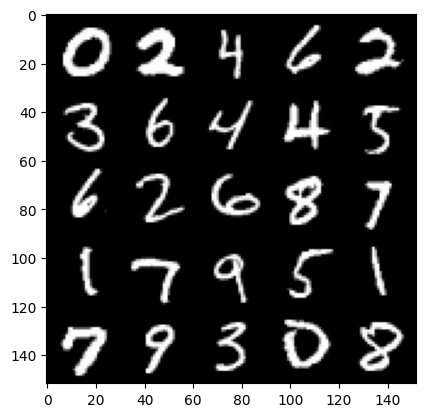

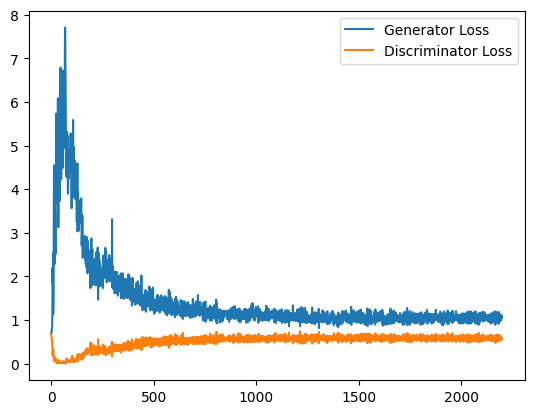

  0%|          | 0/469 [00:00<?, ?it/s]

Step 44500: Generator loss: 1.0735859311819076, discriminator loss: 0.5782325791716576


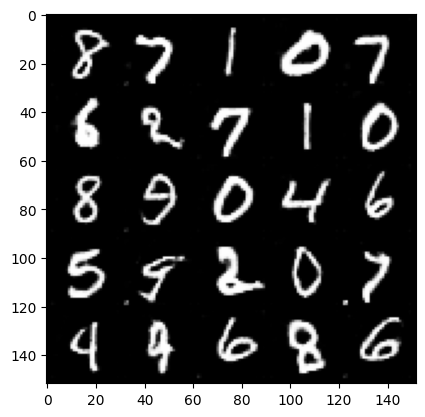

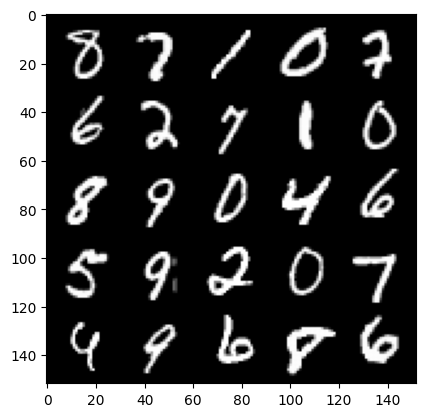

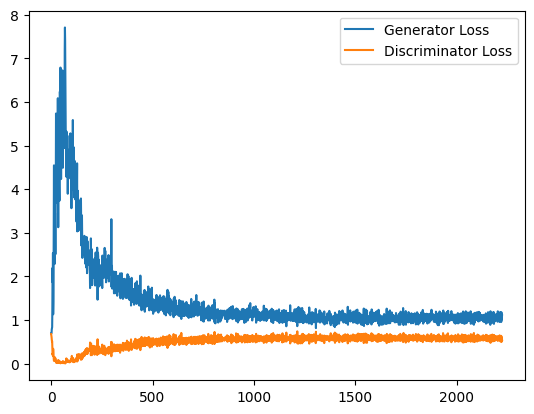

  0%|          | 0/469 [00:00<?, ?it/s]

Step 45000: Generator loss: 1.0323858799934387, discriminator loss: 0.5818596229553222


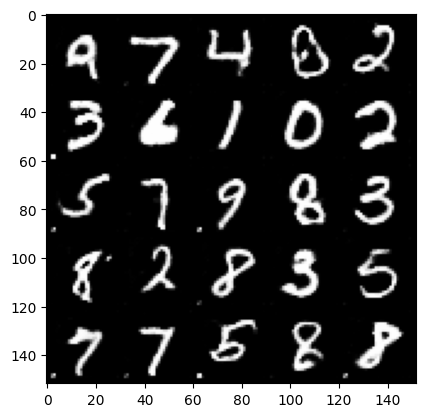

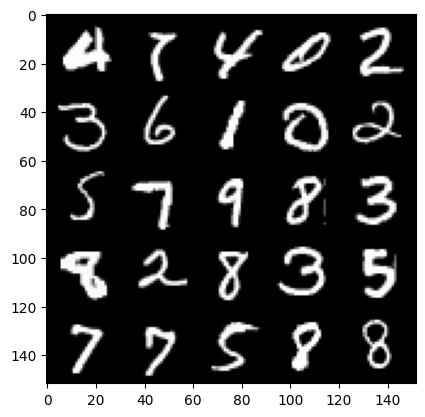

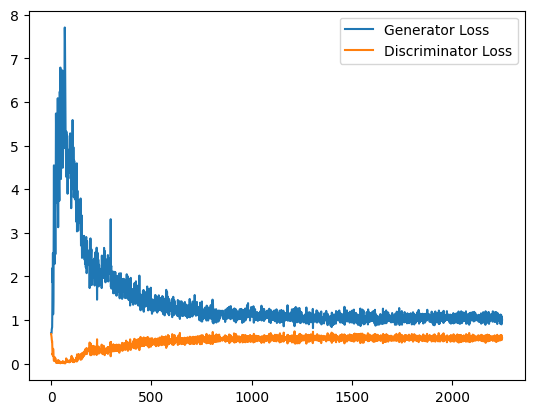

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

Step 45500: Generator loss: 1.0443812854290009, discriminator loss: 0.5766168377399444


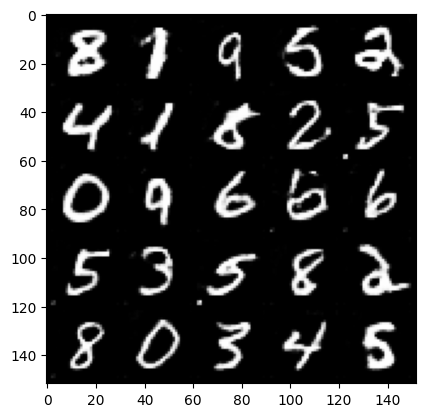

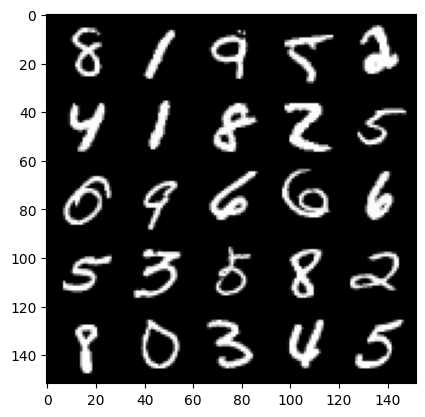

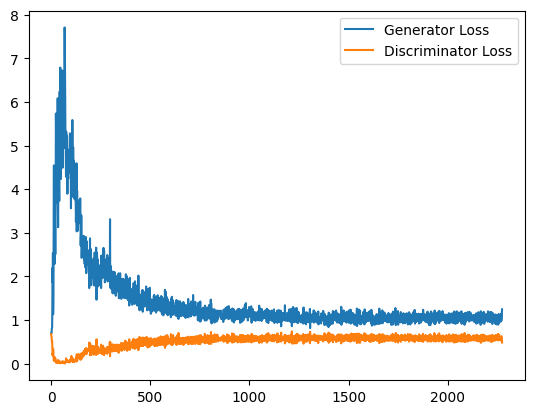

  0%|          | 0/469 [00:00<?, ?it/s]

Step 46000: Generator loss: 1.0458184913992883, discriminator loss: 0.5834000068306923


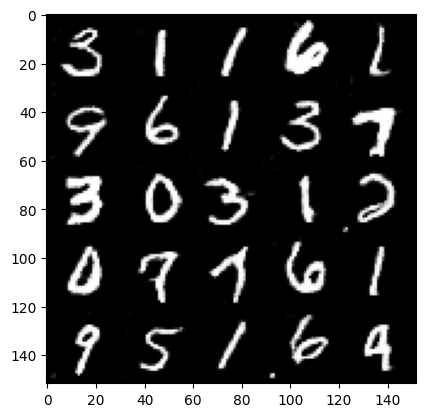

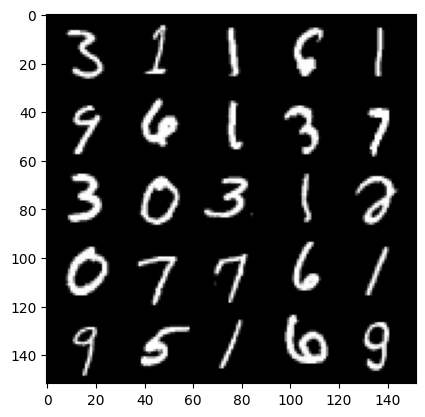

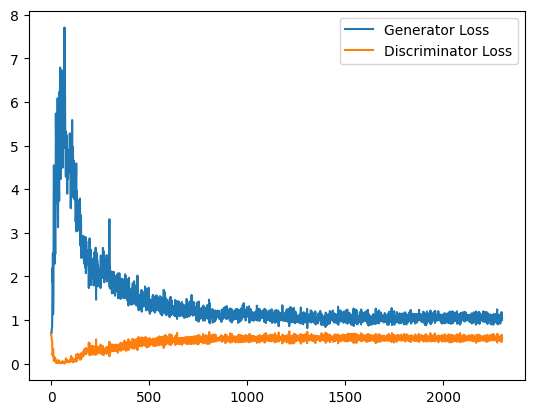

  0%|          | 0/469 [00:00<?, ?it/s]

Step 46500: Generator loss: 1.0656346868276596, discriminator loss: 0.5758778523206711


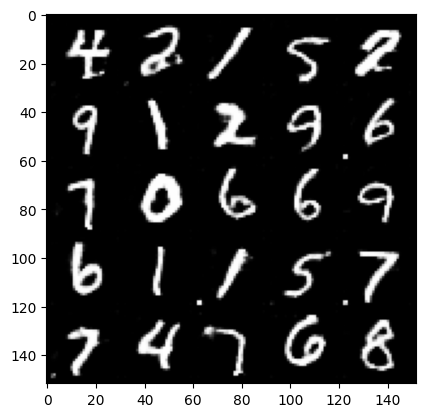

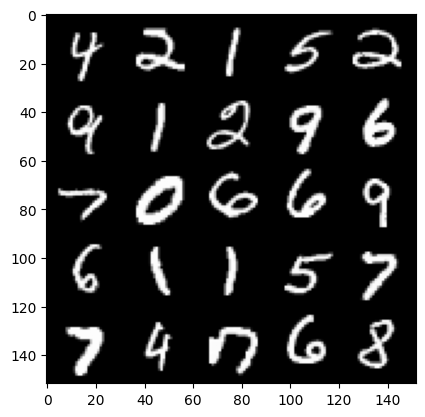

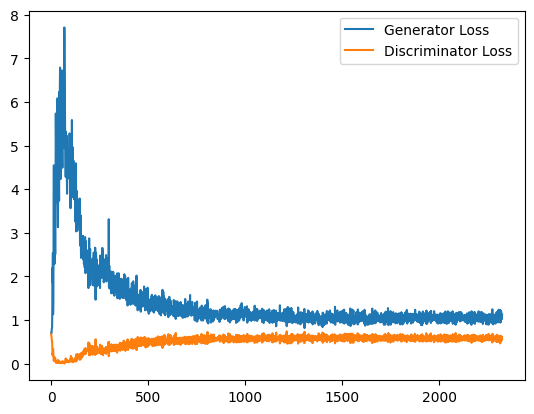

  0%|          | 0/469 [00:00<?, ?it/s]

Step 47000: Generator loss: 1.0677739177942276, discriminator loss: 0.5769114266633988


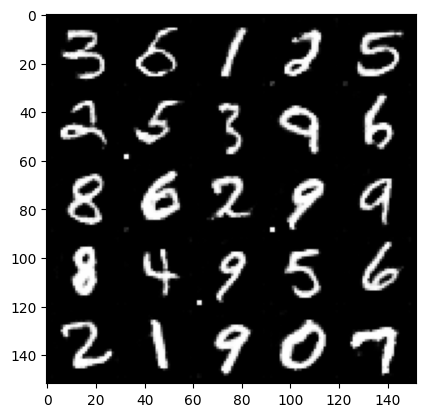

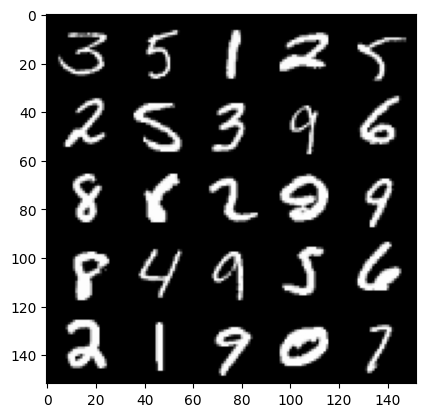

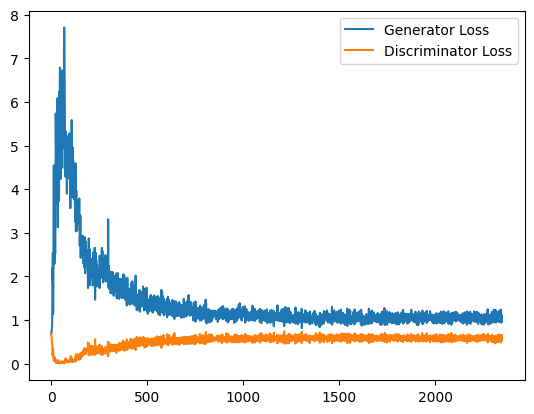

  0%|          | 0/469 [00:00<?, ?it/s]

Step 47500: Generator loss: 1.05518814766407, discriminator loss: 0.5687807307839393


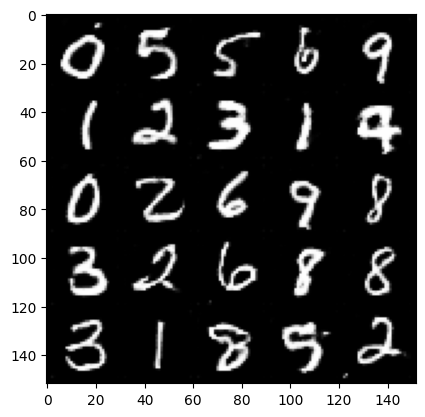

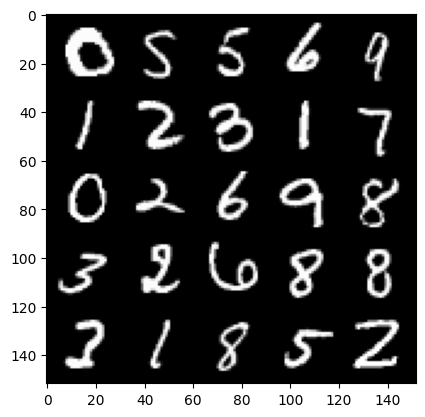

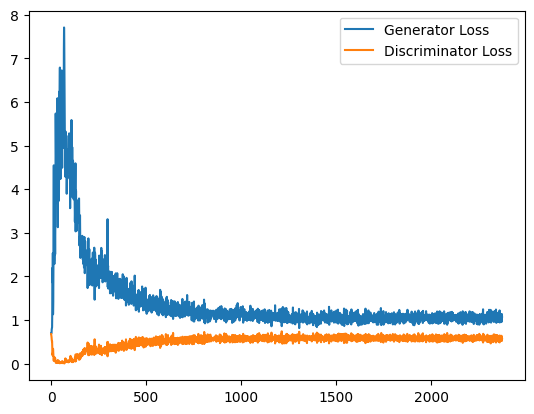

  0%|          | 0/469 [00:00<?, ?it/s]

Step 48000: Generator loss: 1.0761358740329743, discriminator loss: 0.5759877930283547


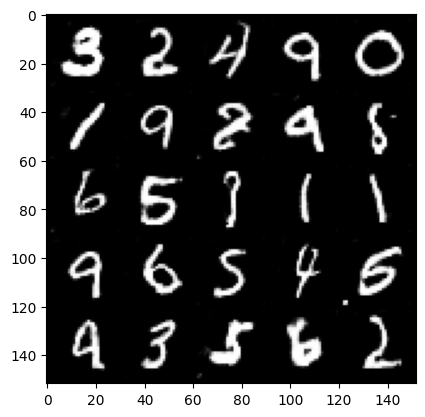

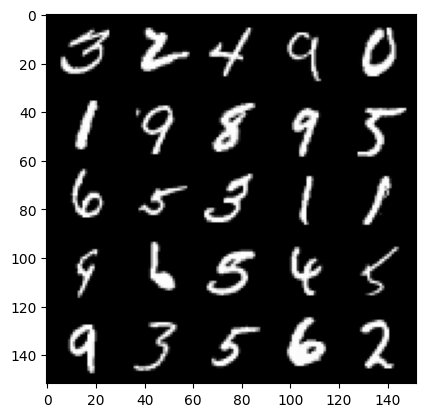

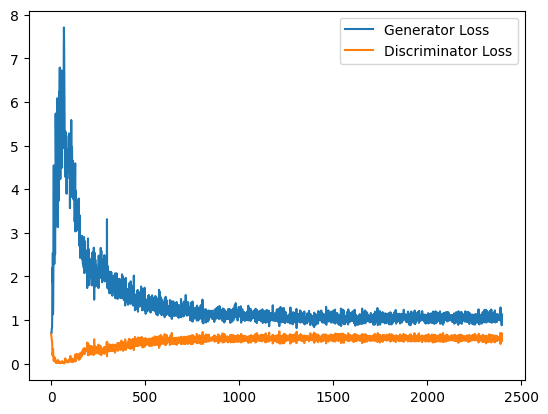

  0%|          | 0/469 [00:00<?, ?it/s]

Step 48500: Generator loss: 1.067553432226181, discriminator loss: 0.5771318953037262


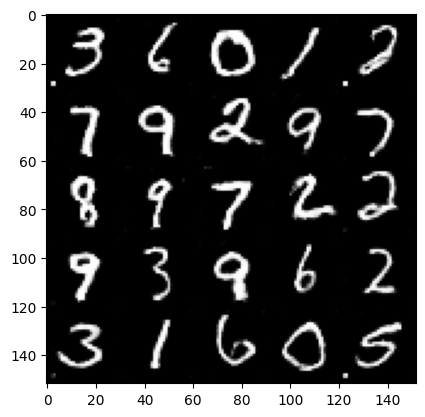

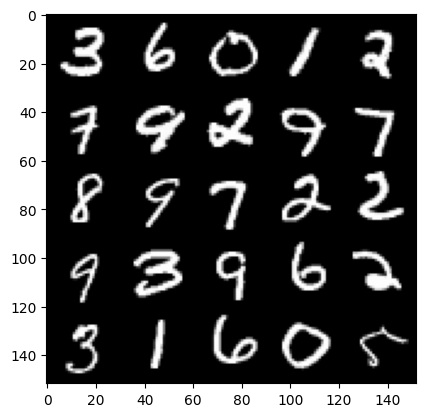

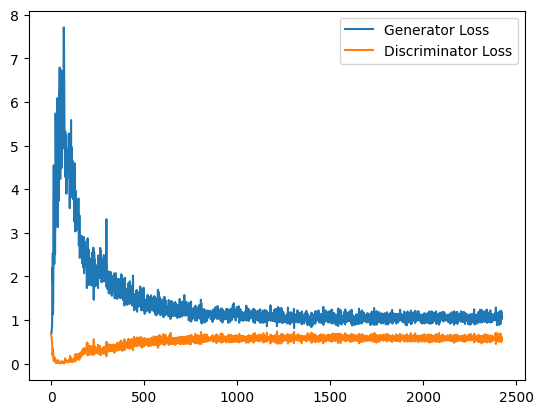

  0%|          | 0/469 [00:00<?, ?it/s]

Step 49000: Generator loss: 1.074365138888359, discriminator loss: 0.5719119740128518


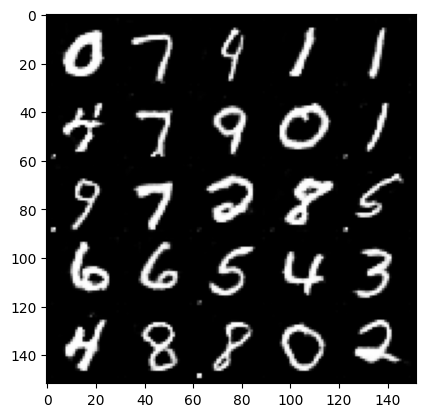

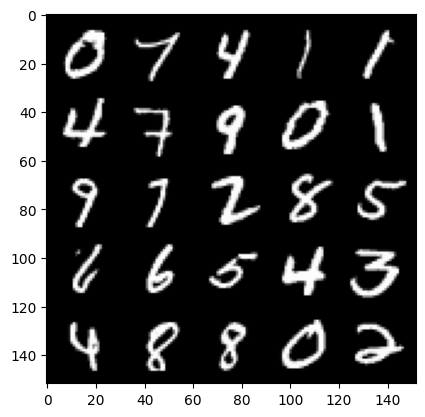

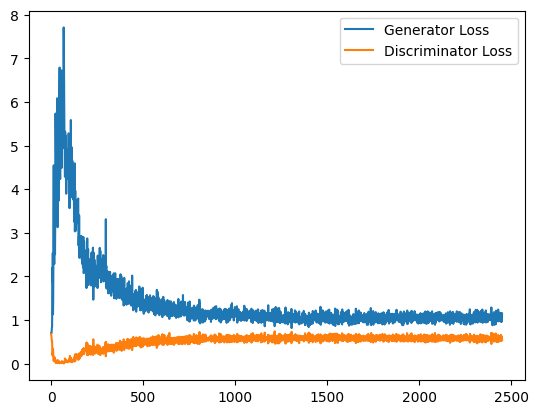

  0%|          | 0/469 [00:00<?, ?it/s]

Step 49500: Generator loss: 1.082836585521698, discriminator loss: 0.5704018800854683


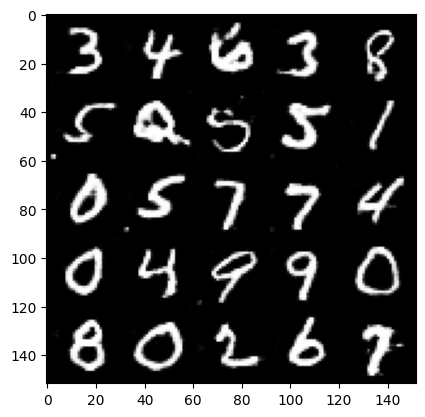

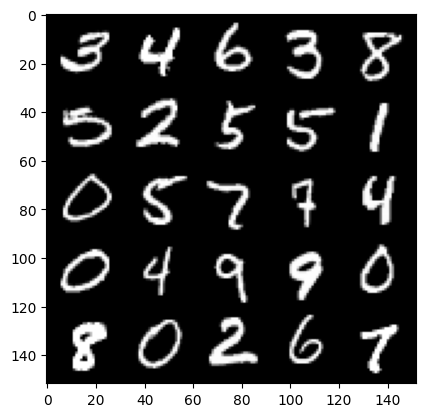

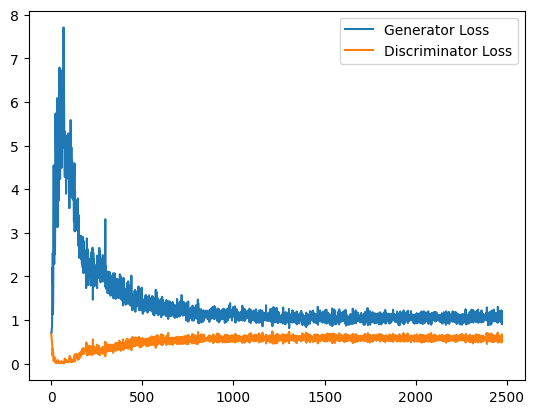

  0%|          | 0/469 [00:00<?, ?it/s]

Step 50000: Generator loss: 1.0441450546979905, discriminator loss: 0.5720341718196869


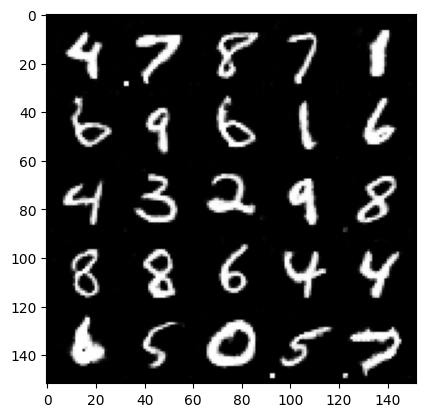

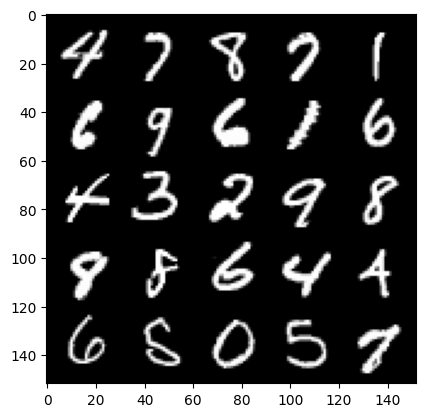

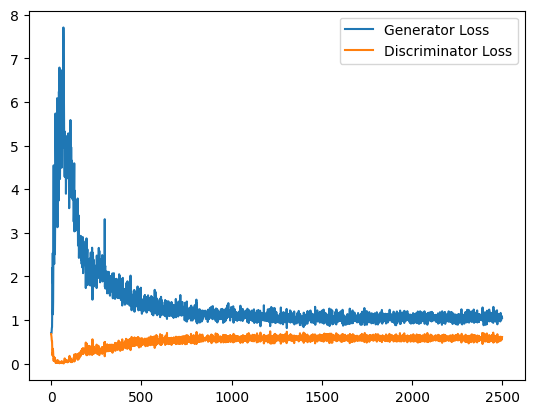

  0%|          | 0/469 [00:00<?, ?it/s]

Step 50500: Generator loss: 1.0693630468845368, discriminator loss: 0.5714689691662789


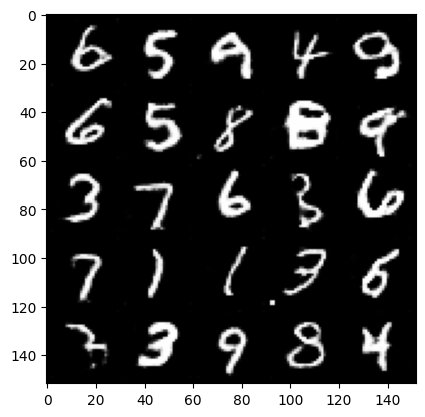

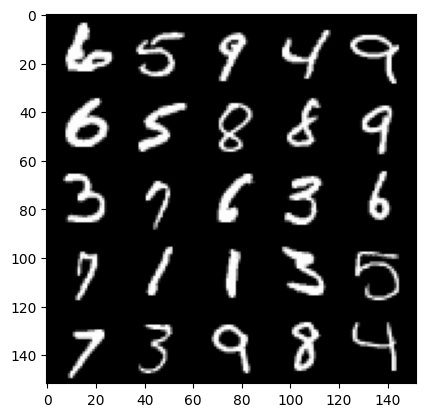

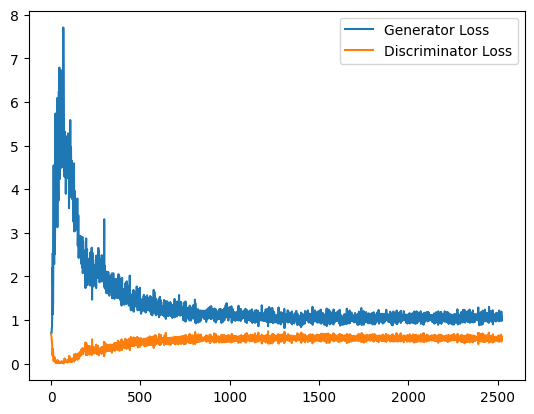

  0%|          | 0/469 [00:00<?, ?it/s]

Step 51000: Generator loss: 1.072254899740219, discriminator loss: 0.5677955348491669


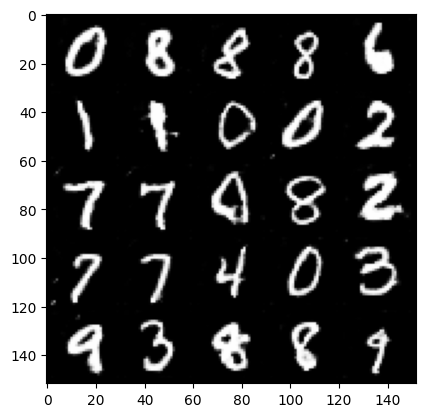

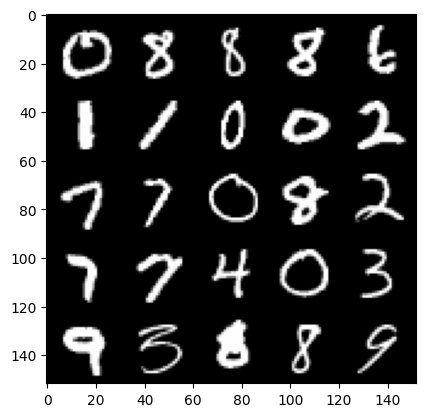

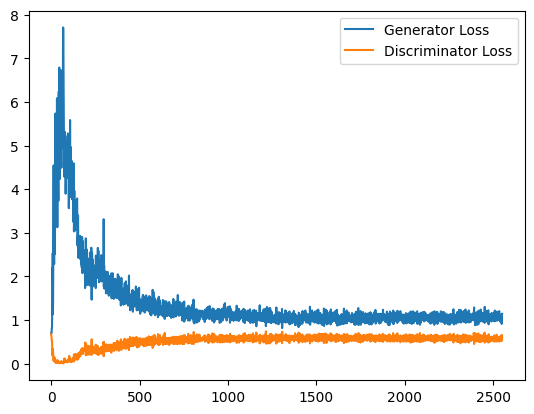

  0%|          | 0/469 [00:00<?, ?it/s]

Step 51500: Generator loss: 1.0683910547494888, discriminator loss: 0.5692116717100143


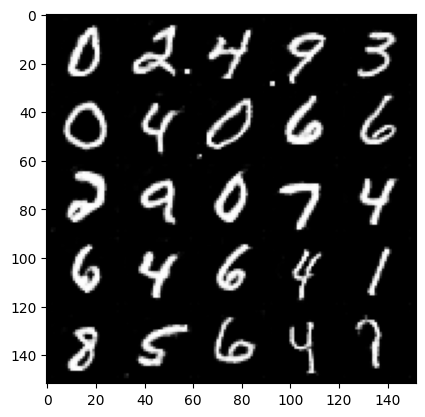

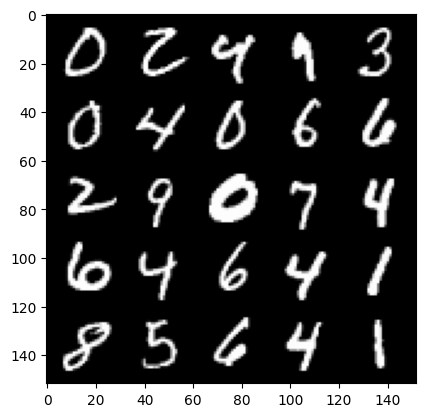

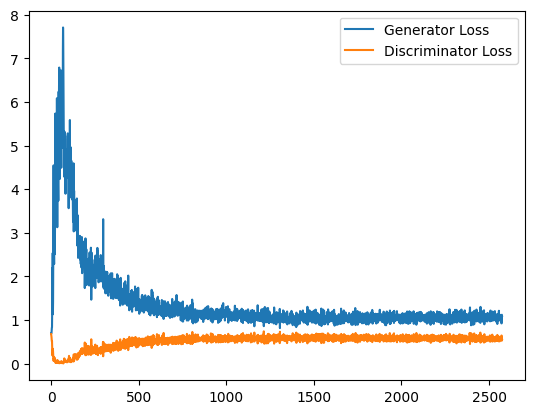

  0%|          | 0/469 [00:00<?, ?it/s]

Step 52000: Generator loss: 1.0762904781103133, discriminator loss: 0.568403894841671


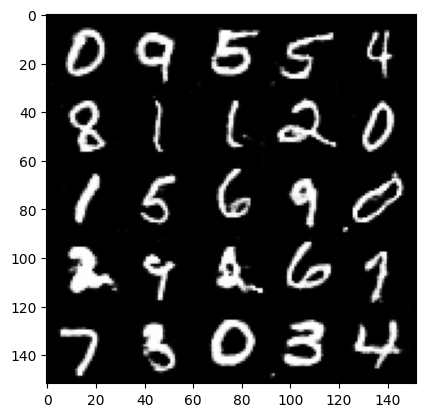

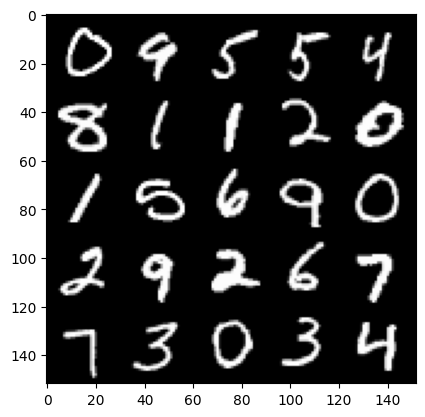

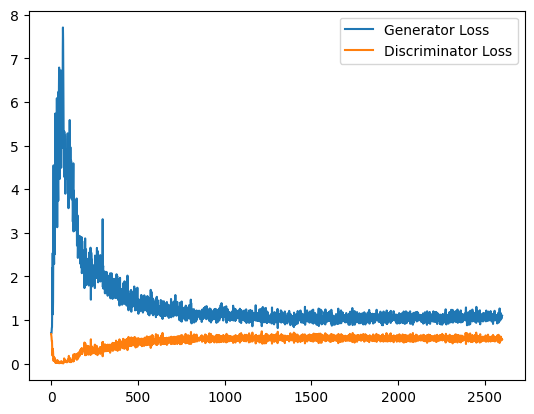

  0%|          | 0/469 [00:00<?, ?it/s]

Step 52500: Generator loss: 1.084186203479767, discriminator loss: 0.5690083767175674


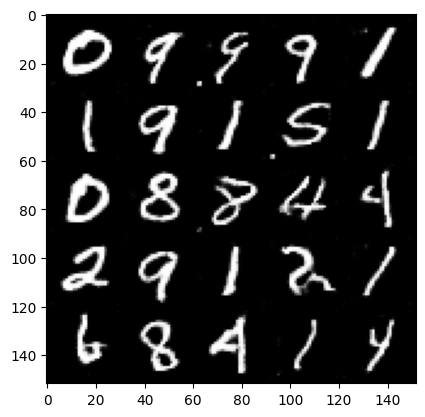

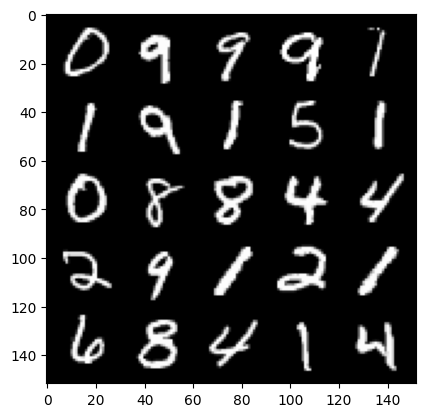

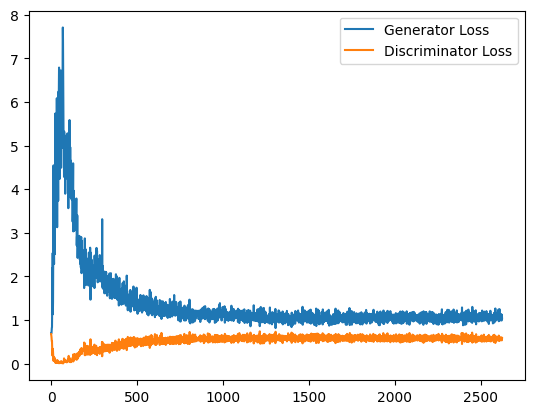

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

Step 53000: Generator loss: 1.0739887248277664, discriminator loss: 0.5639908913373947


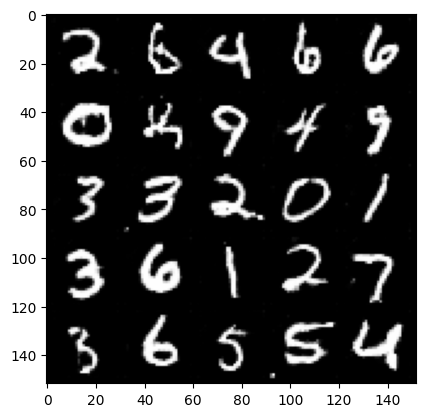

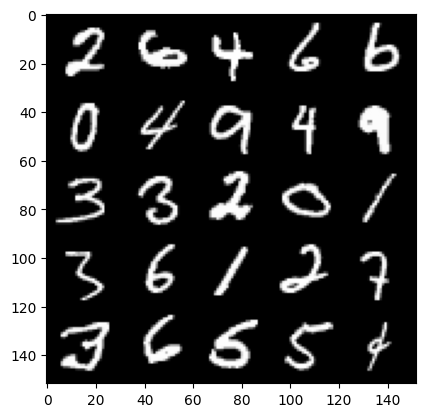

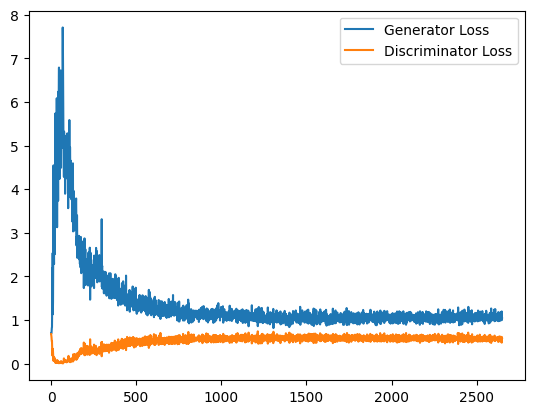

  0%|          | 0/469 [00:00<?, ?it/s]

Step 53500: Generator loss: 1.1024062057733537, discriminator loss: 0.5686156844496727


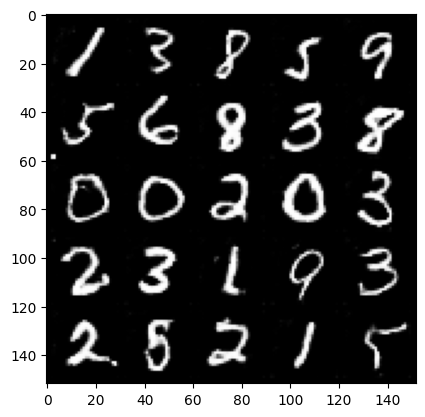

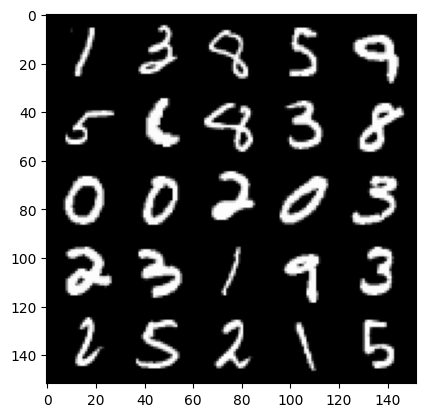

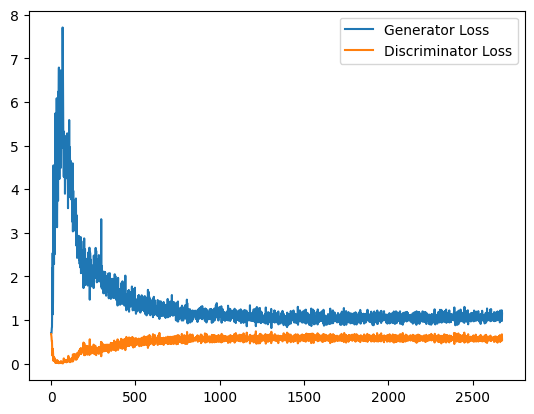

  0%|          | 0/469 [00:00<?, ?it/s]

Step 54000: Generator loss: 1.0762474479675292, discriminator loss: 0.5673861790299416


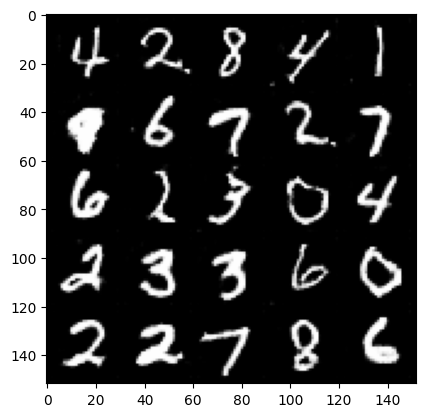

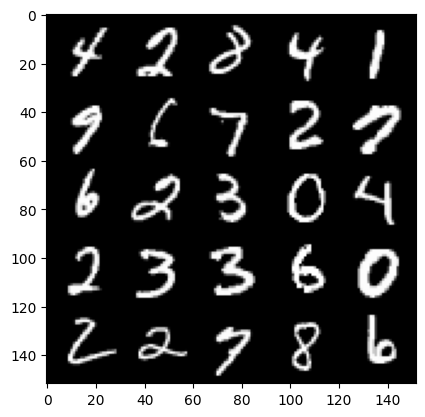

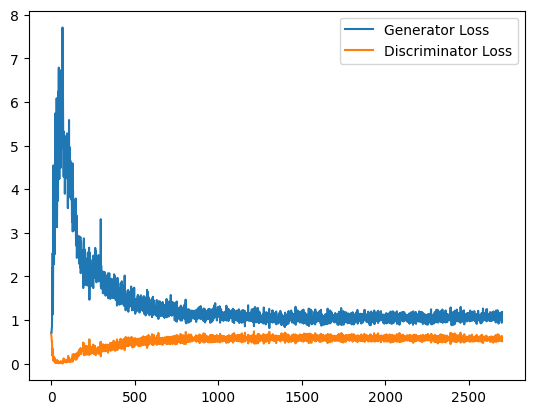

  0%|          | 0/469 [00:00<?, ?it/s]

Step 54500: Generator loss: 1.0982434457540513, discriminator loss: 0.5639853112101555


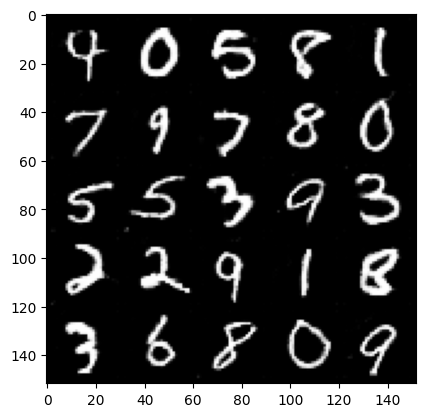

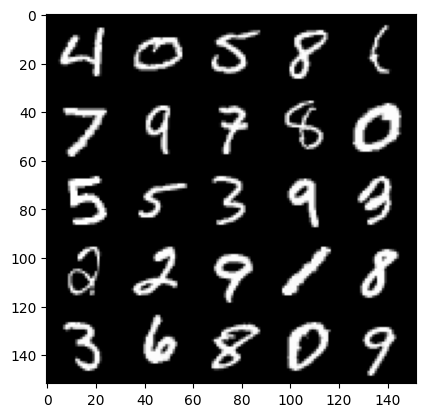

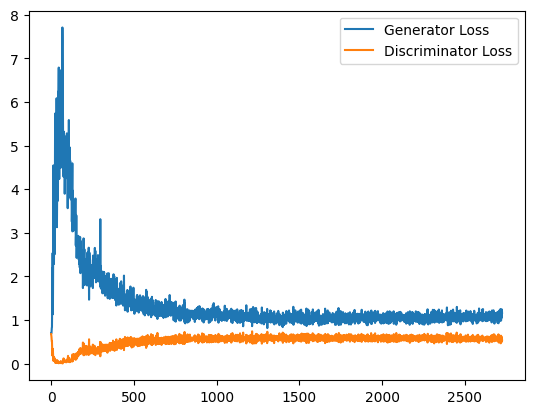

  0%|          | 0/469 [00:00<?, ?it/s]

Step 55000: Generator loss: 1.078618664264679, discriminator loss: 0.5635465818047524


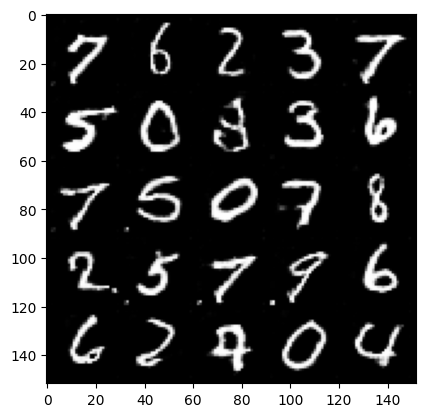

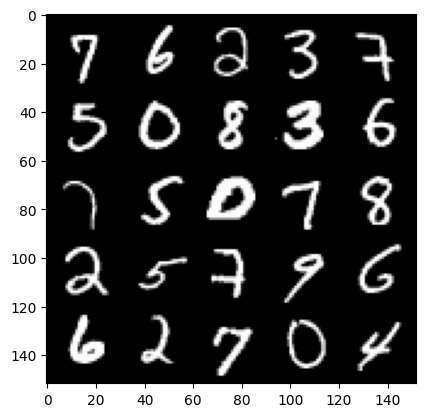

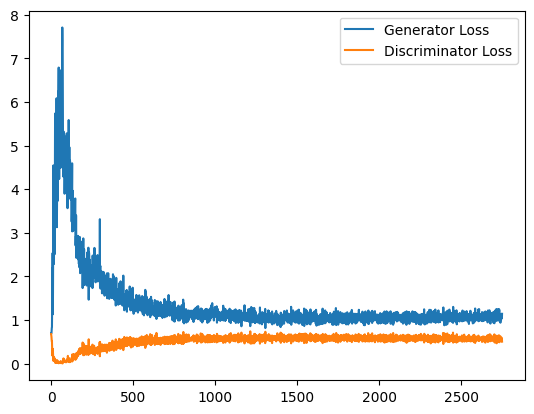

  0%|          | 0/469 [00:00<?, ?it/s]

Step 55500: Generator loss: 1.0962915774583817, discriminator loss: 0.563193450987339


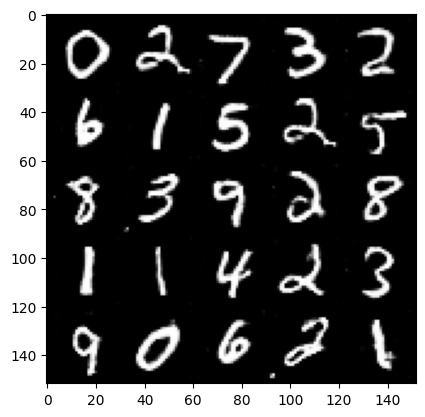

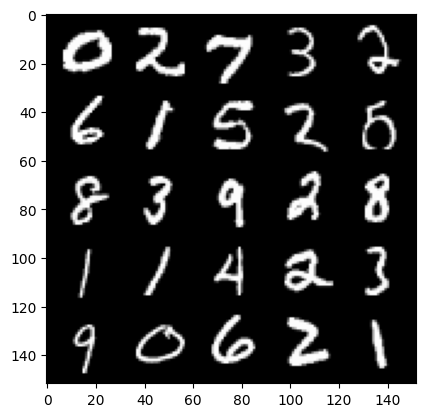

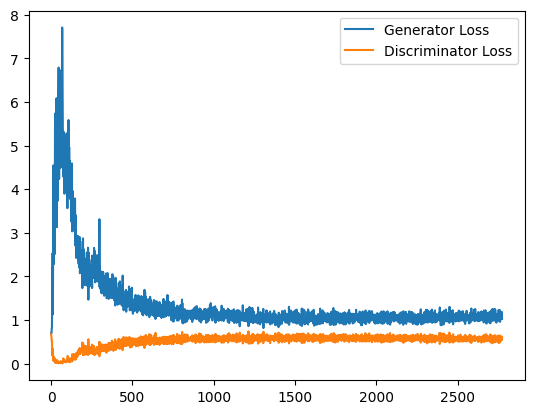

  0%|          | 0/469 [00:00<?, ?it/s]

Step 56000: Generator loss: 1.087886332511902, discriminator loss: 0.5609768753647805


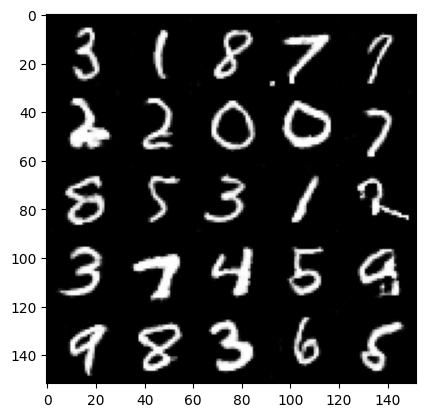

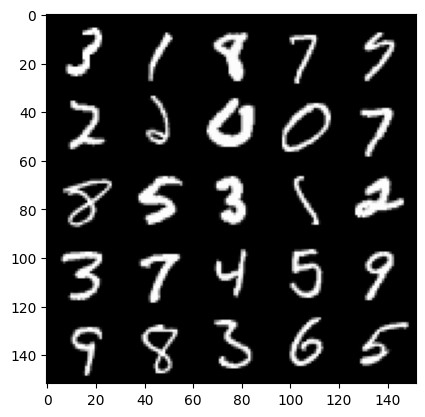

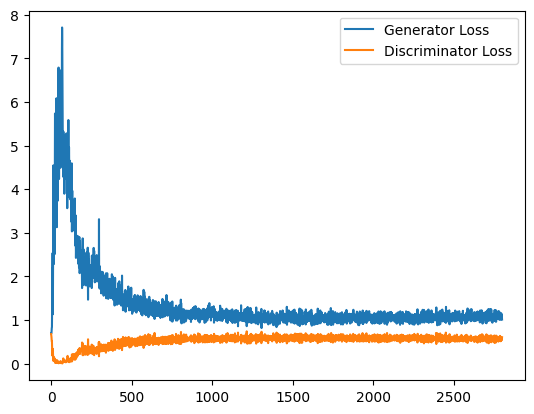

  0%|          | 0/469 [00:00<?, ?it/s]

Step 56500: Generator loss: 1.086466198682785, discriminator loss: 0.55539093708992


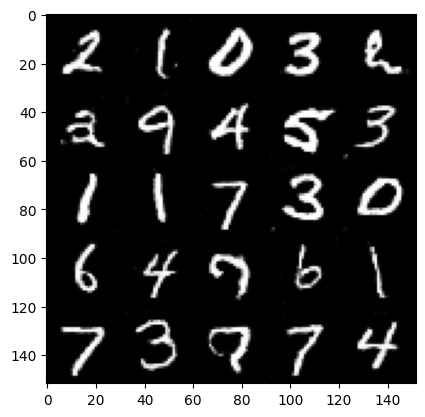

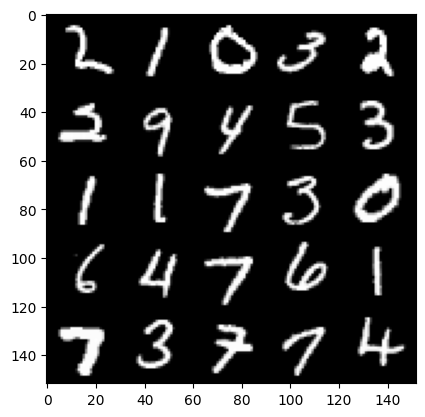

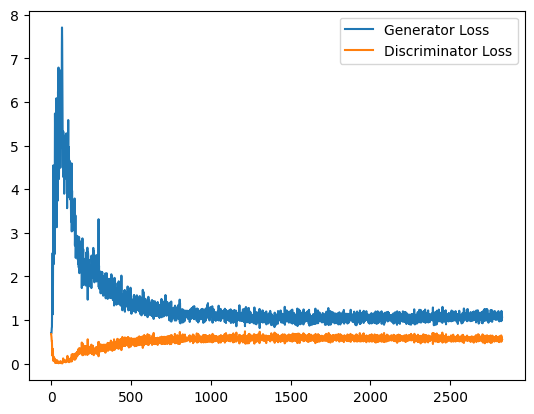

  0%|          | 0/469 [00:00<?, ?it/s]

Step 57000: Generator loss: 1.0938601310253144, discriminator loss: 0.5567654817104339


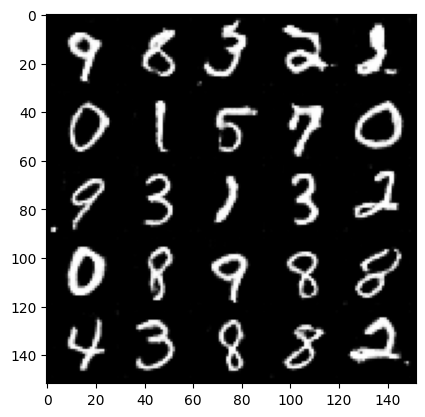

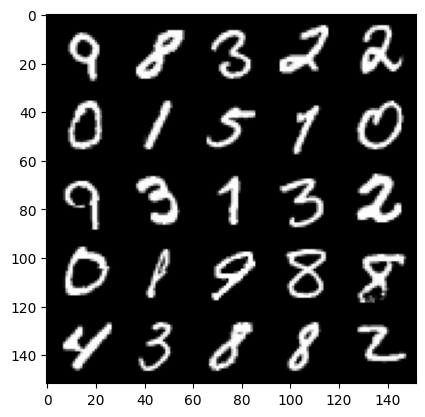

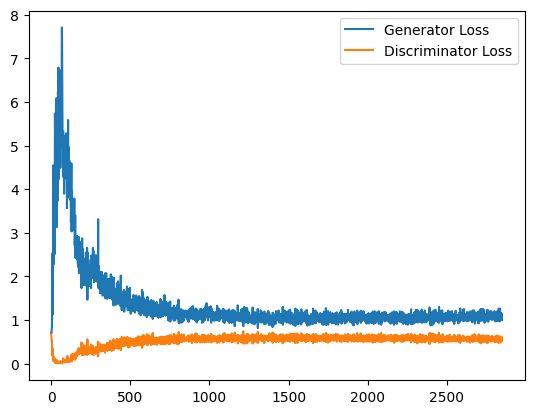

  0%|          | 0/469 [00:00<?, ?it/s]

Step 57500: Generator loss: 1.0973445895910263, discriminator loss: 0.5546002542972565


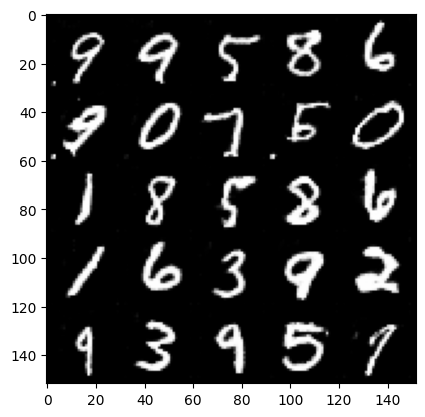

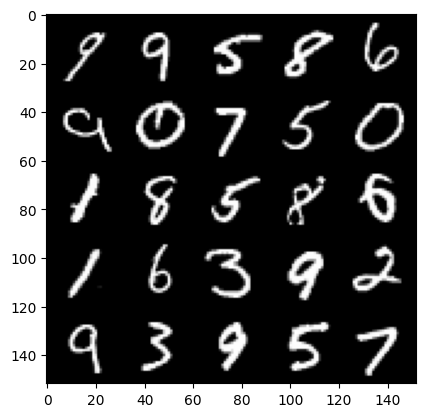

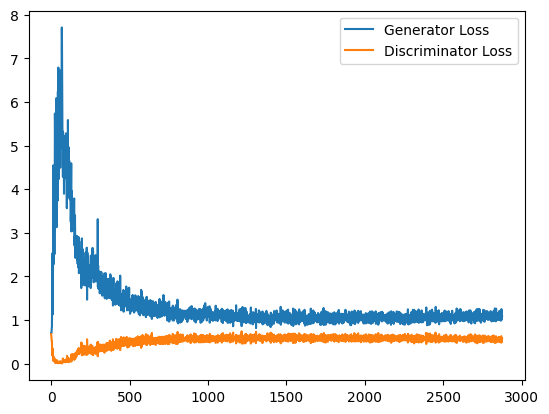

  0%|          | 0/469 [00:00<?, ?it/s]

Step 58000: Generator loss: 1.1085341665744781, discriminator loss: 0.5519645624756813


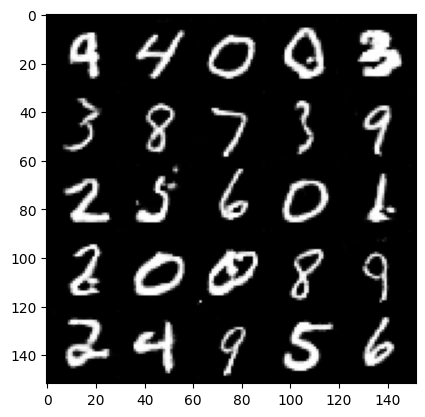

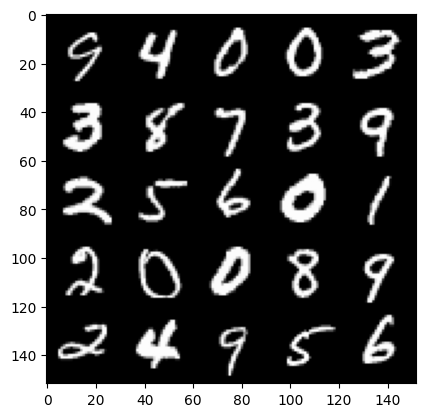

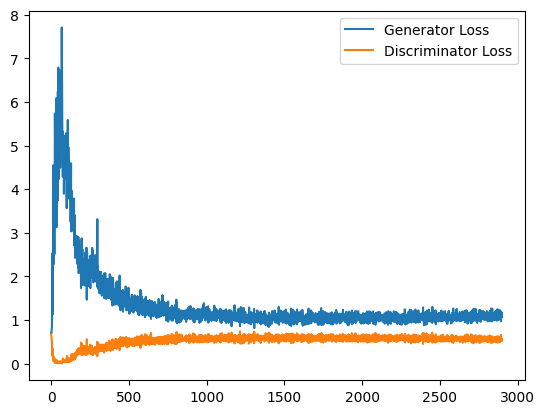

  0%|          | 0/469 [00:00<?, ?it/s]

Step 58500: Generator loss: 1.1087603231668473, discriminator loss: 0.5557761576771736


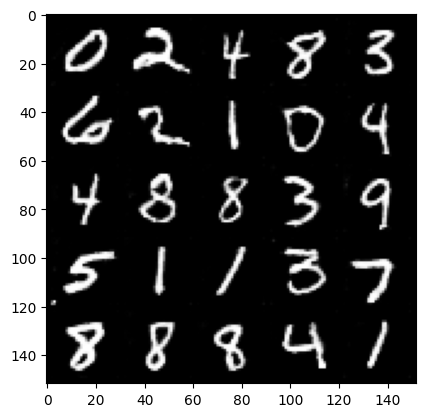

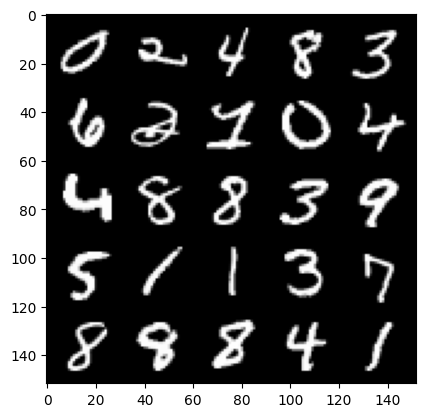

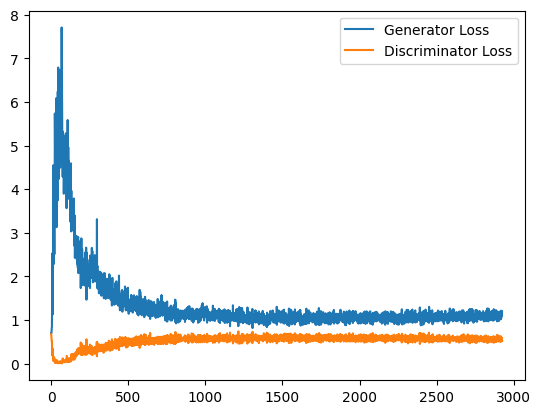

  0%|          | 0/469 [00:00<?, ?it/s]

Step 59000: Generator loss: 1.0930997138023377, discriminator loss: 0.5596356521844864


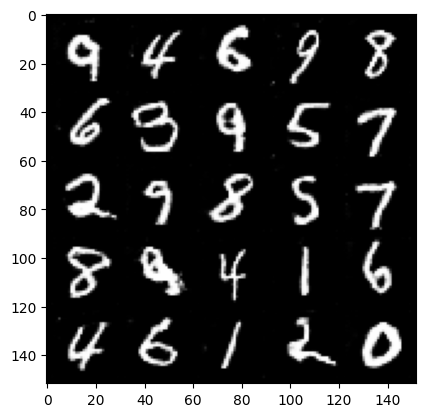

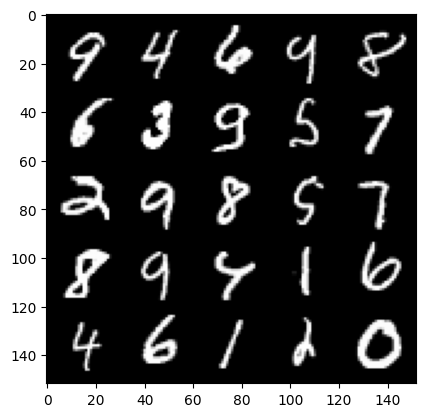

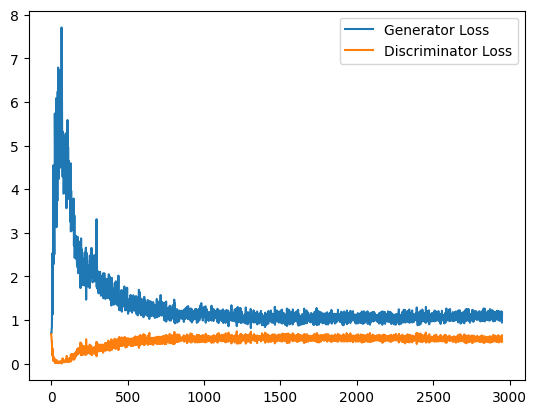

  0%|          | 0/469 [00:00<?, ?it/s]

Step 59500: Generator loss: 1.095357302904129, discriminator loss: 0.5551359804272652


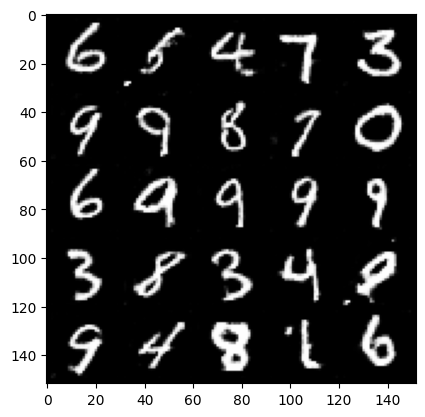

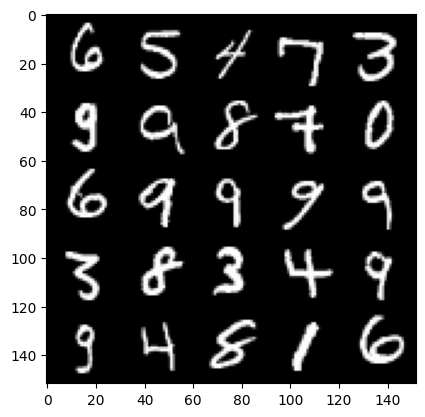

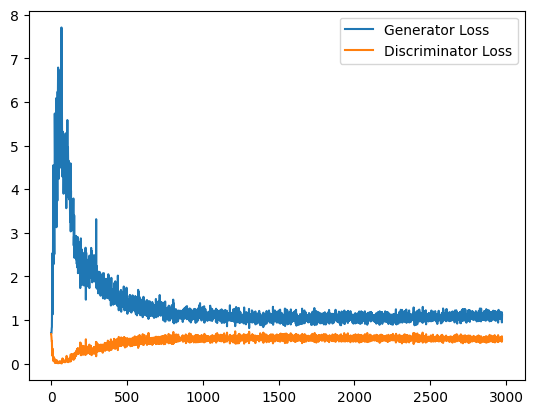

  0%|          | 0/469 [00:00<?, ?it/s]

Step 60000: Generator loss: 1.122723875761032, discriminator loss: 0.553598136484623


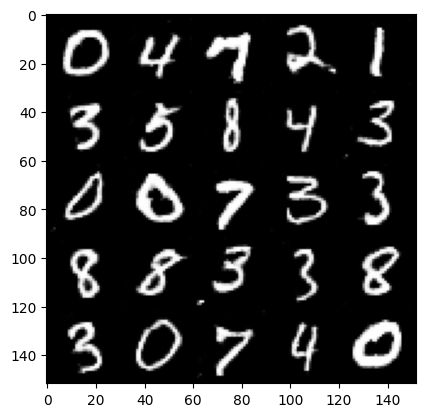

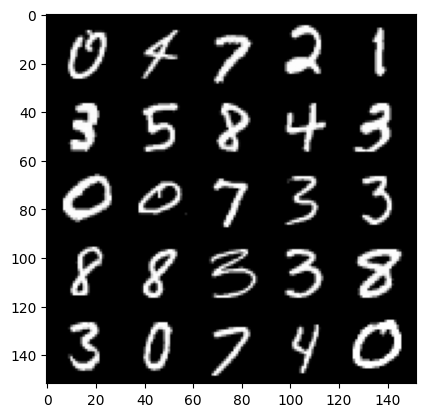

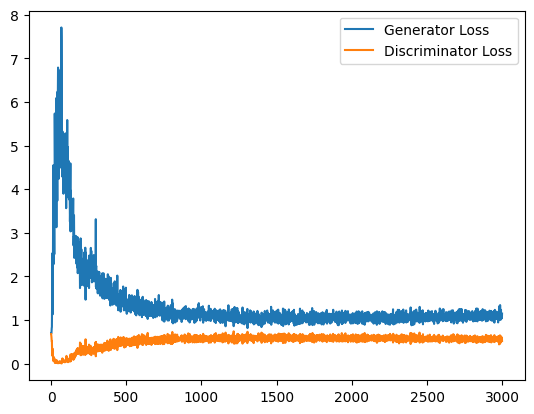

  0%|          | 0/469 [00:00<?, ?it/s]

Step 60500: Generator loss: 1.1163341509103775, discriminator loss: 0.5536251442432404


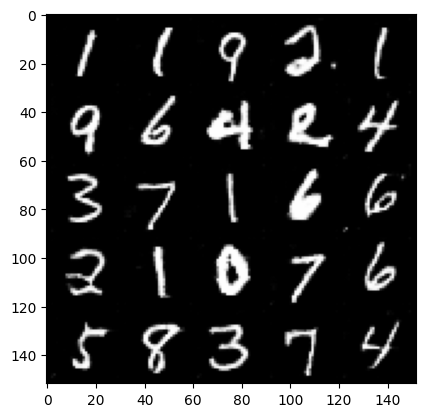

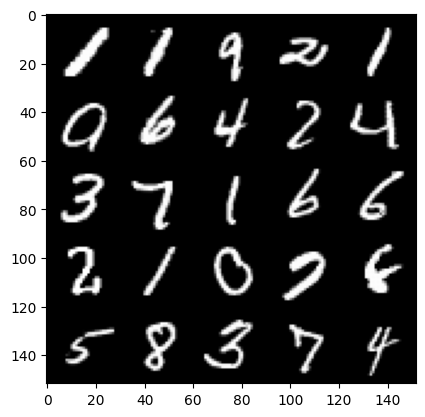

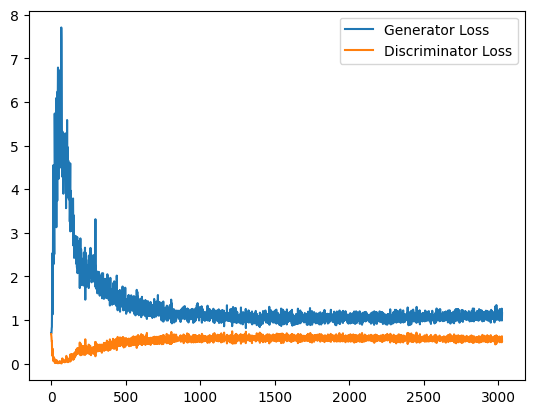

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

Step 61000: Generator loss: 1.1165739651918412, discriminator loss: 0.5597288327217103


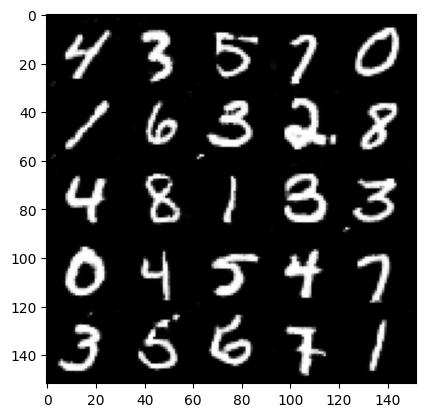

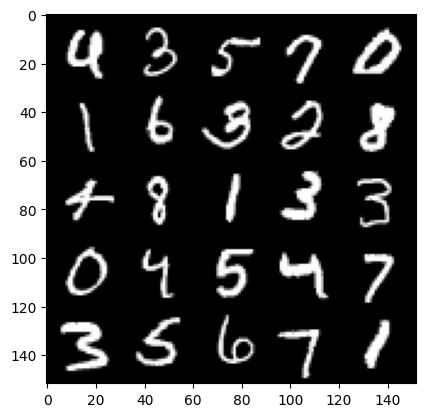

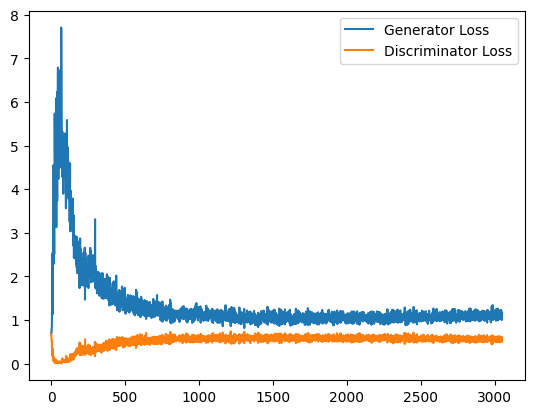

  0%|          | 0/469 [00:00<?, ?it/s]

Step 61500: Generator loss: 1.1136758217811584, discriminator loss: 0.5544396287202835


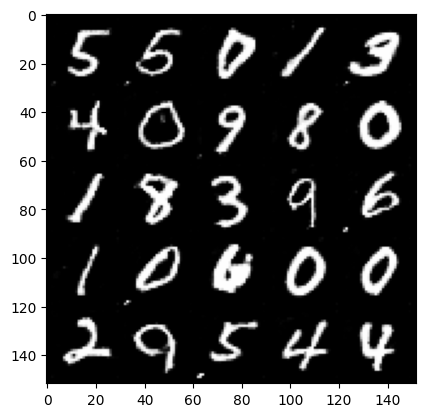

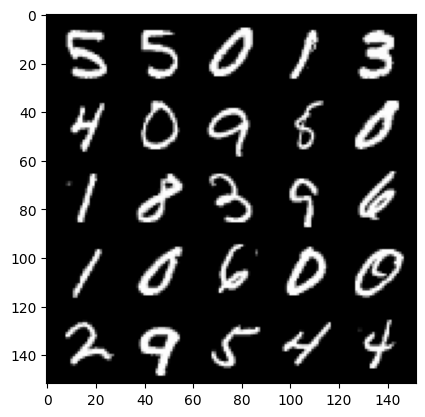

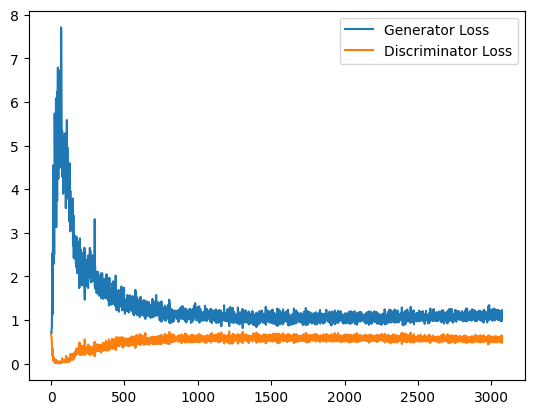

  0%|          | 0/469 [00:00<?, ?it/s]

Step 62000: Generator loss: 1.1065737750530242, discriminator loss: 0.5495557390451431


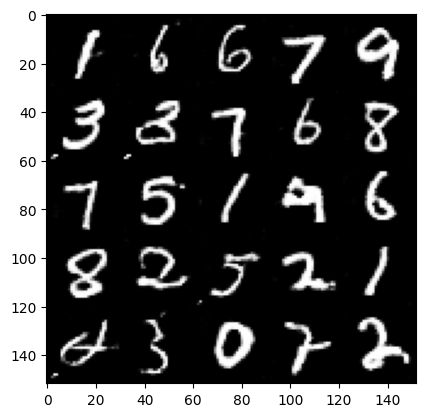

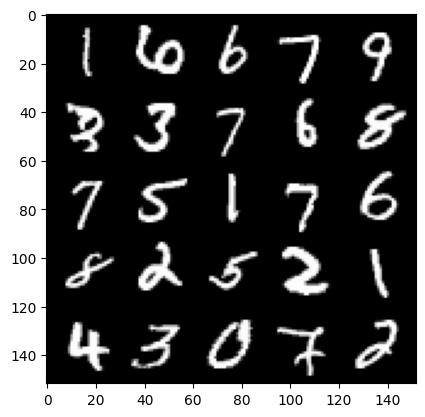

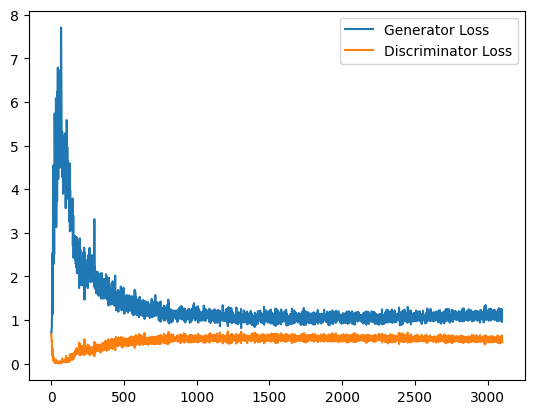

  0%|          | 0/469 [00:00<?, ?it/s]

Step 62500: Generator loss: 1.1113162471055984, discriminator loss: 0.5537482514977455


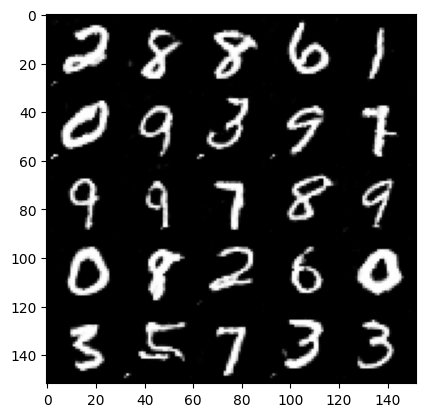

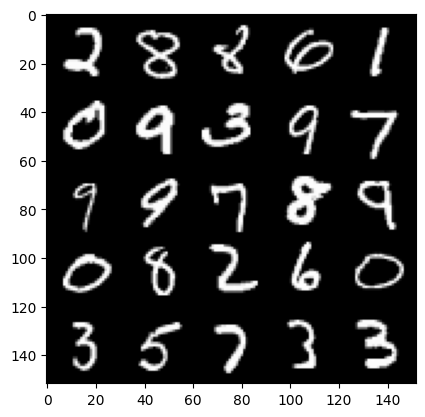

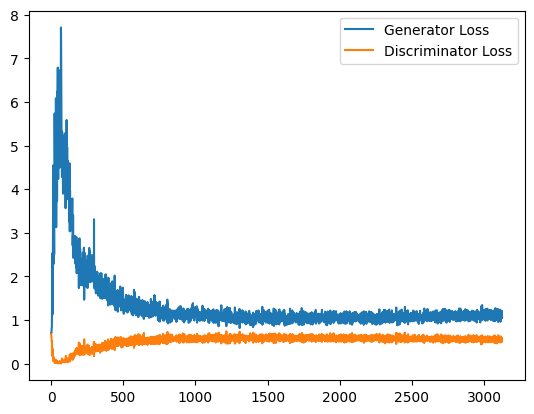

  0%|          | 0/469 [00:00<?, ?it/s]

Step 63000: Generator loss: 1.1205295892953873, discriminator loss: 0.5490901914238929


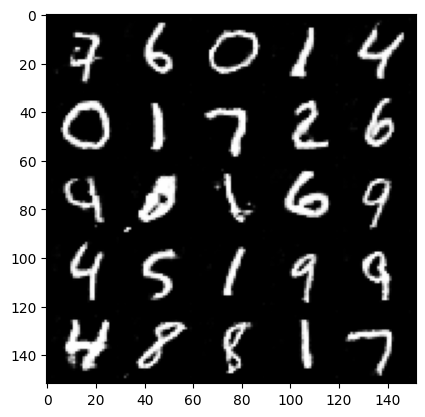

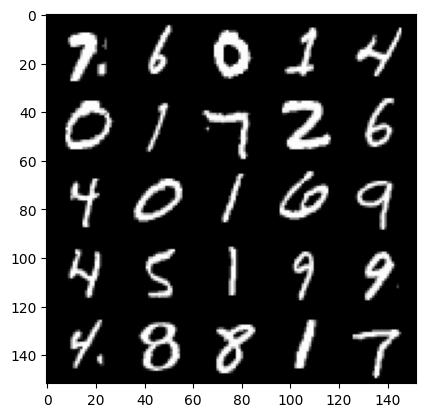

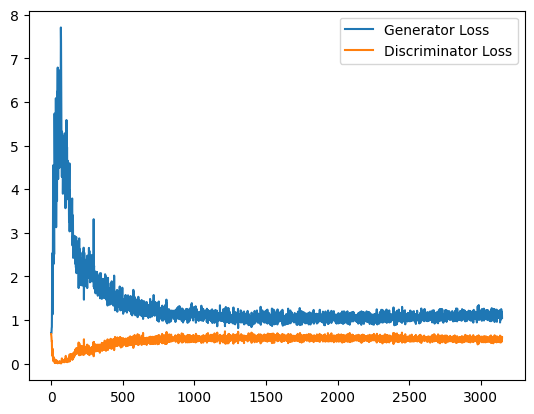

  0%|          | 0/469 [00:00<?, ?it/s]

Step 63500: Generator loss: 1.1377613925933838, discriminator loss: 0.5459479404091835


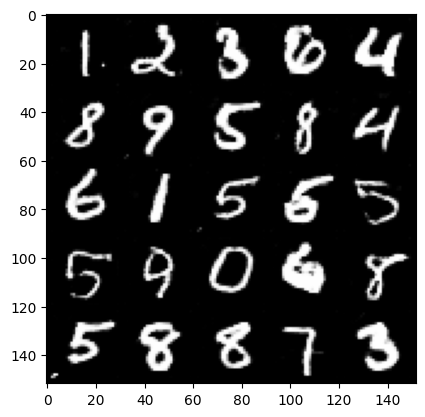

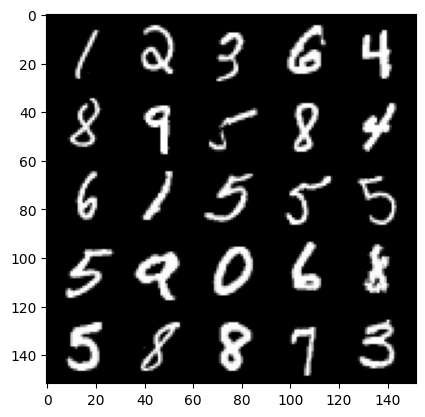

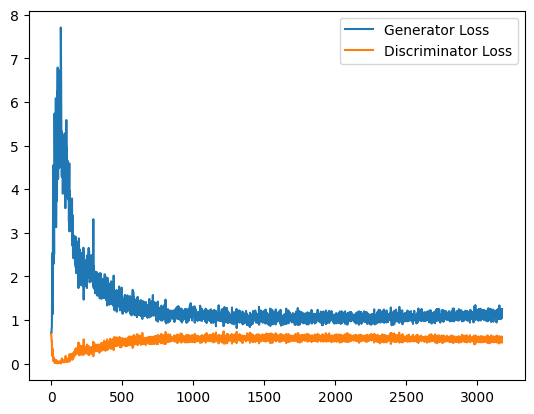

  0%|          | 0/469 [00:00<?, ?it/s]

Step 64000: Generator loss: 1.129442808866501, discriminator loss: 0.5513476695418358


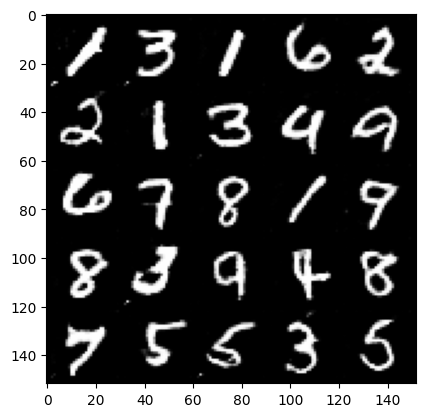

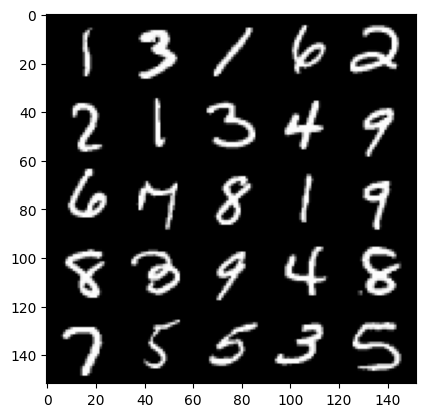

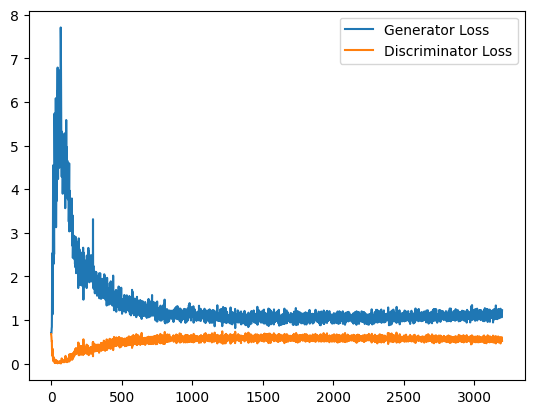

  0%|          | 0/469 [00:00<?, ?it/s]

Step 64500: Generator loss: 1.1564226778745652, discriminator loss: 0.5518853449225426


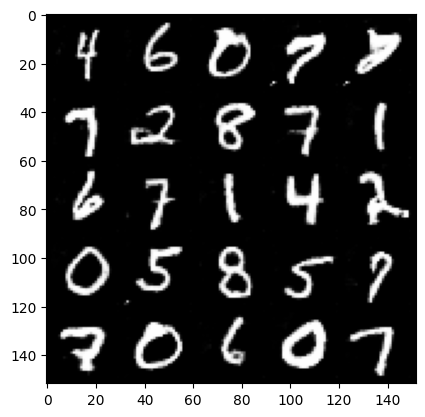

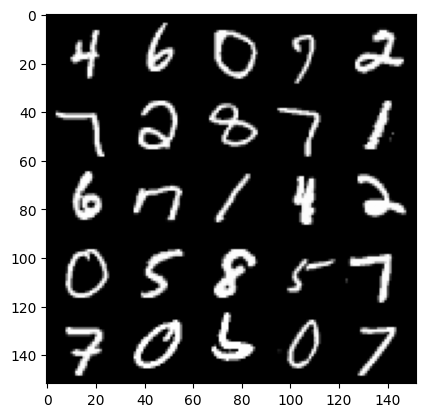

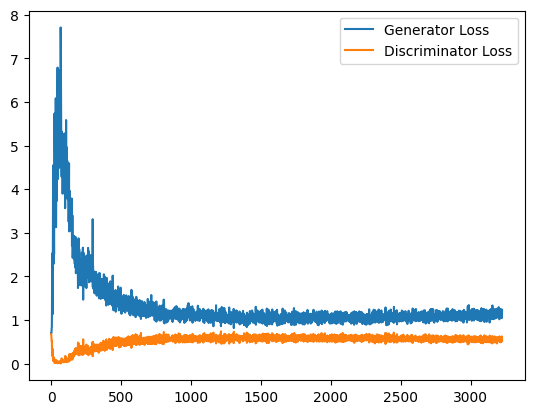

  0%|          | 0/469 [00:00<?, ?it/s]

Step 65000: Generator loss: 1.1403045686483384, discriminator loss: 0.5448005185127258


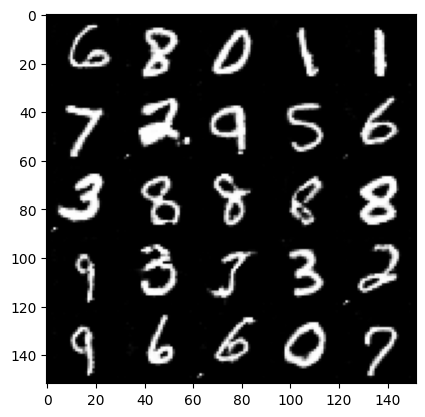

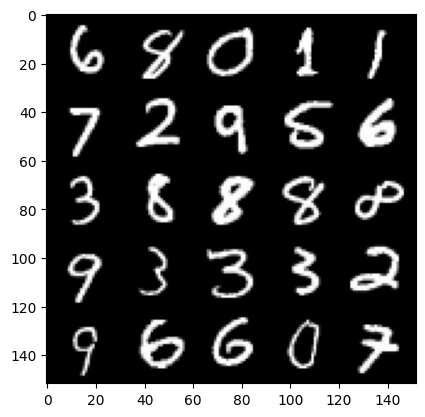

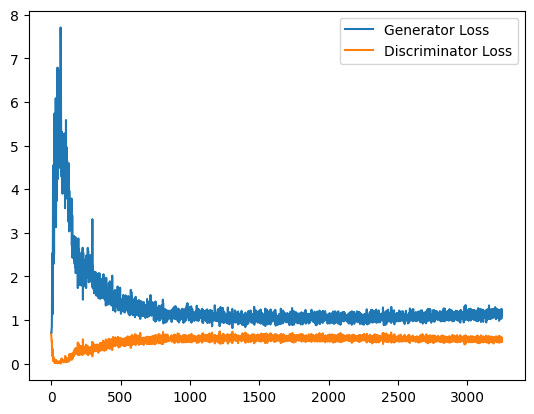

  0%|          | 0/469 [00:00<?, ?it/s]

Step 65500: Generator loss: 1.1271201115846634, discriminator loss: 0.5533553699254989


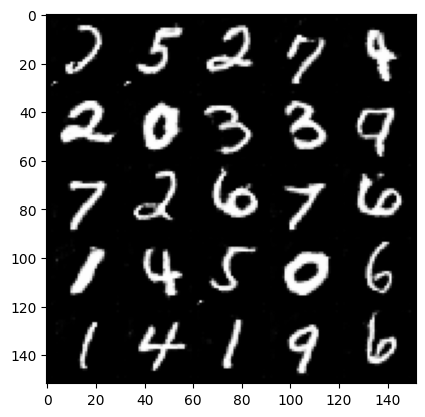

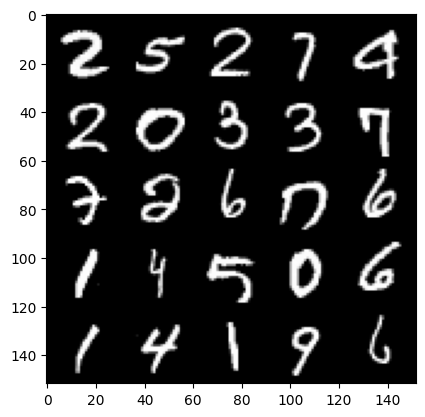

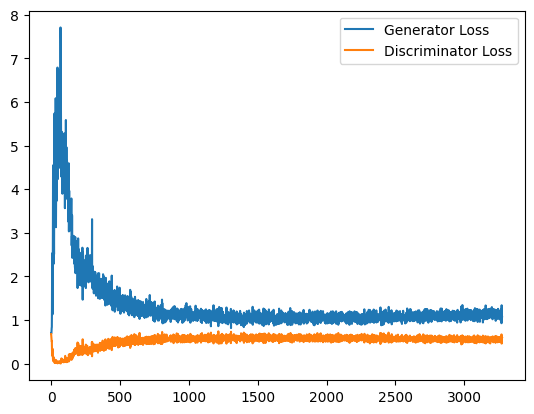

  0%|          | 0/469 [00:00<?, ?it/s]

Step 66000: Generator loss: 1.1262724587917328, discriminator loss: 0.5456973643898964


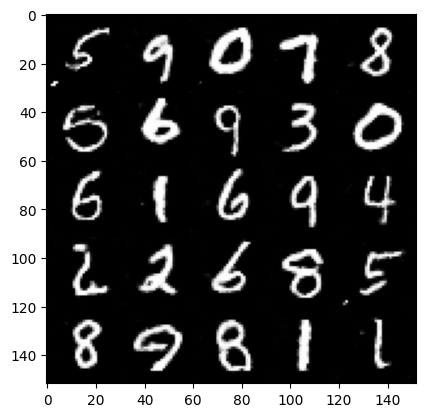

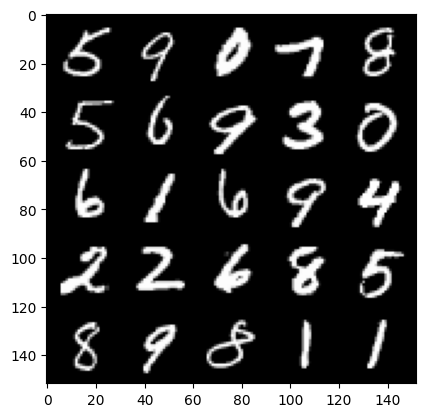

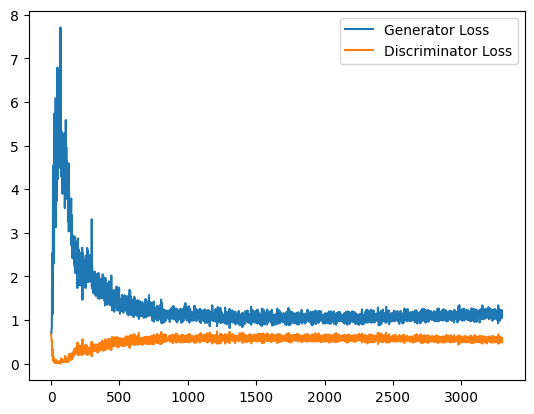

  0%|          | 0/469 [00:00<?, ?it/s]

Step 66500: Generator loss: 1.1477042318582535, discriminator loss: 0.5454809744358062


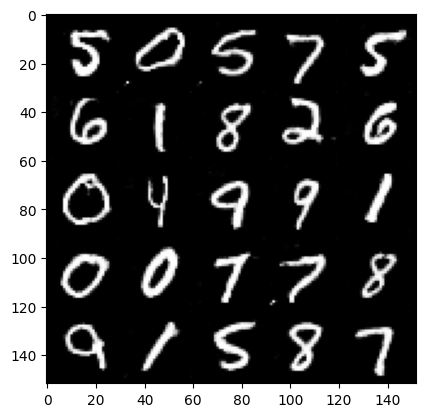

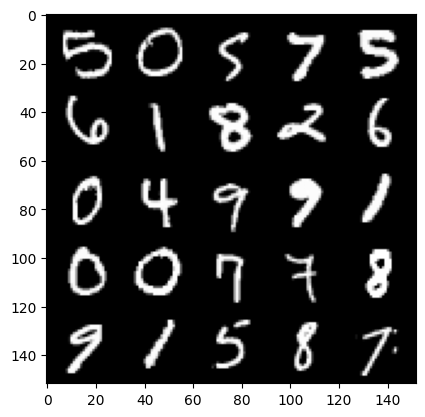

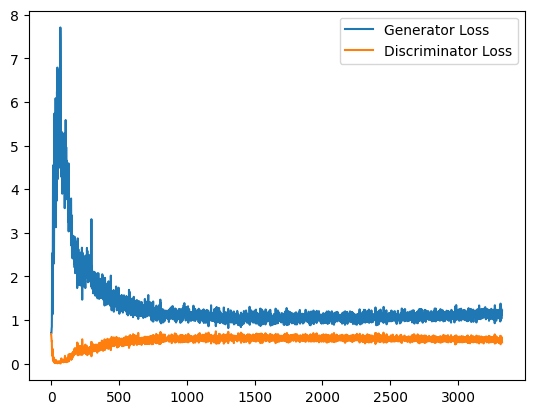

  0%|          | 0/469 [00:00<?, ?it/s]

Step 67000: Generator loss: 1.1329832571744918, discriminator loss: 0.552741960644722


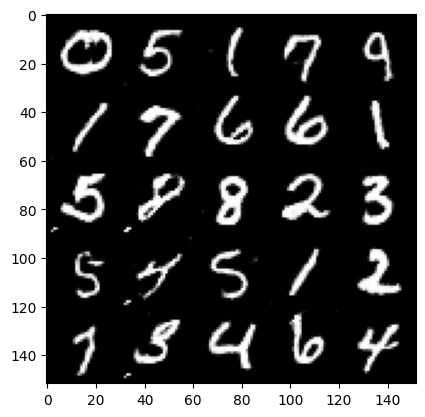

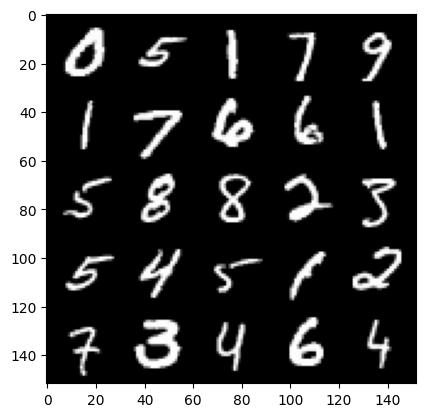

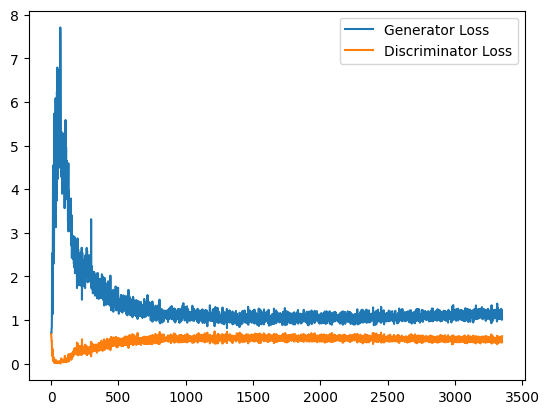

  0%|          | 0/469 [00:00<?, ?it/s]

Step 67500: Generator loss: 1.1395187256336212, discriminator loss: 0.5481598711013794


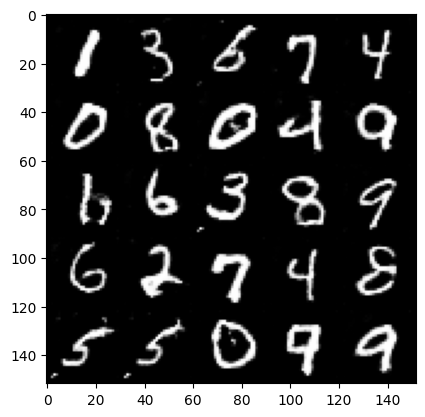

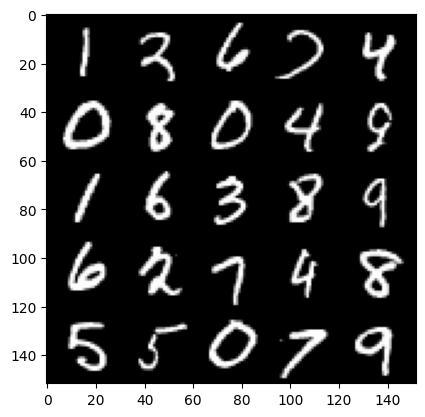

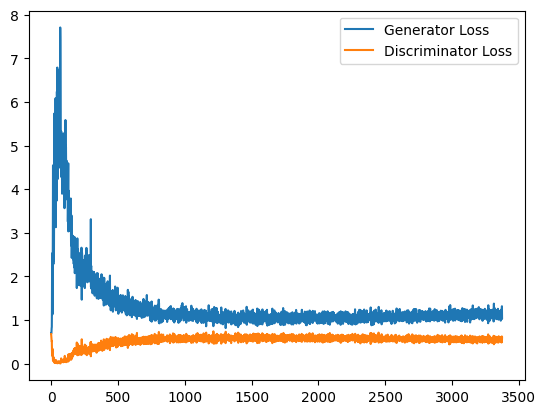

  0%|          | 0/469 [00:00<?, ?it/s]

Step 68000: Generator loss: 1.1535728707313537, discriminator loss: 0.5414705504179


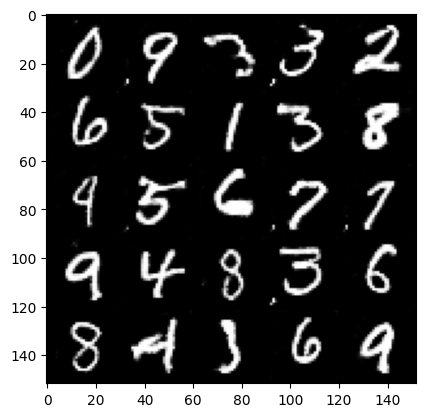

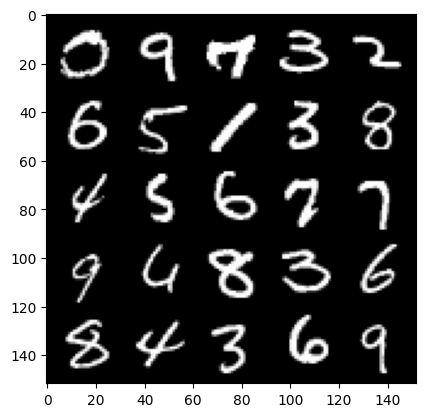

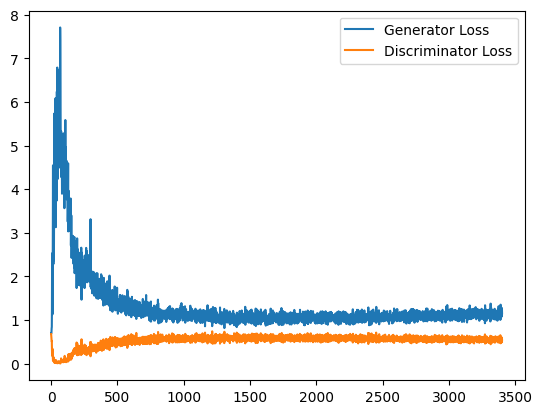

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

Step 68500: Generator loss: 1.1564299372434617, discriminator loss: 0.5432833188772201


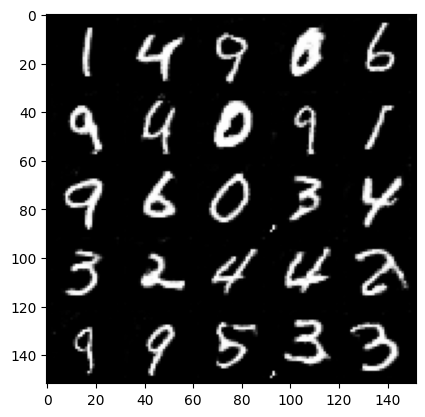

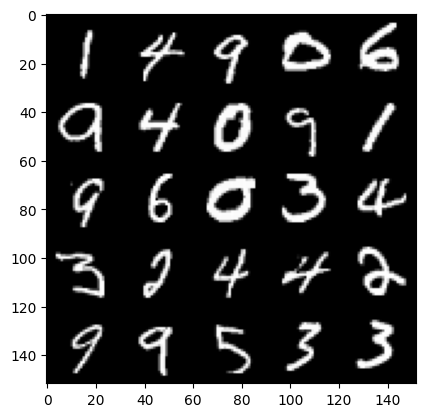

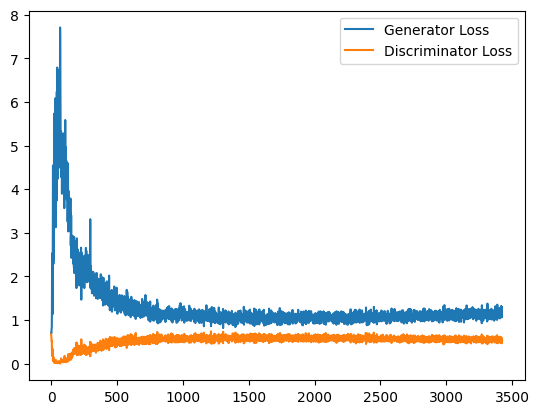

  0%|          | 0/469 [00:00<?, ?it/s]

Step 69000: Generator loss: 1.1446721393465995, discriminator loss: 0.5458268381357193


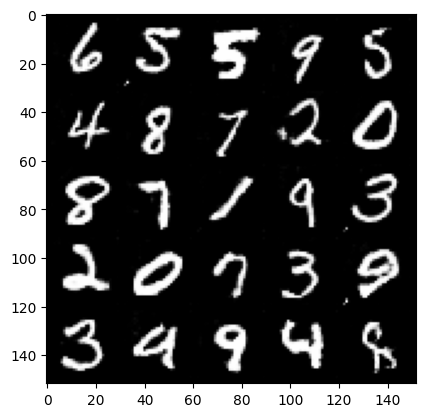

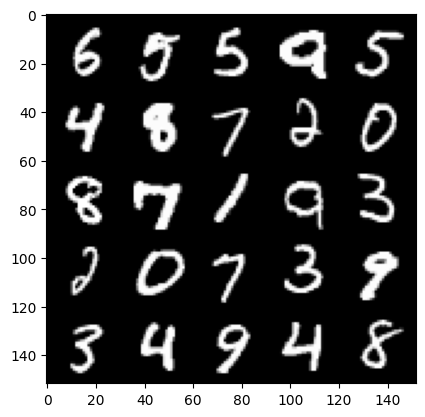

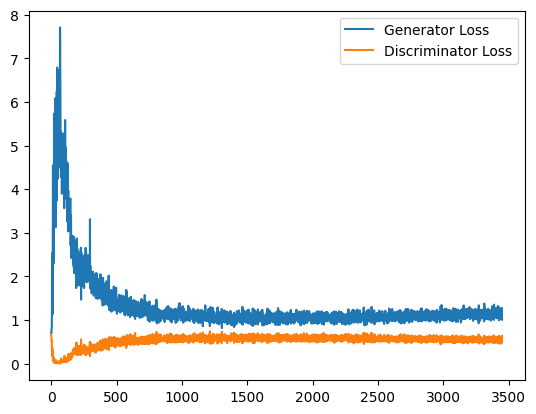

  0%|          | 0/469 [00:00<?, ?it/s]

Step 69500: Generator loss: 1.161121765613556, discriminator loss: 0.5396355255246162


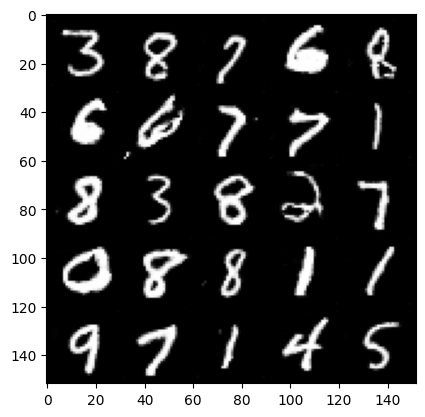

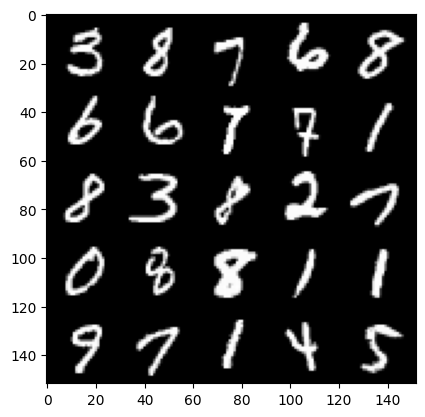

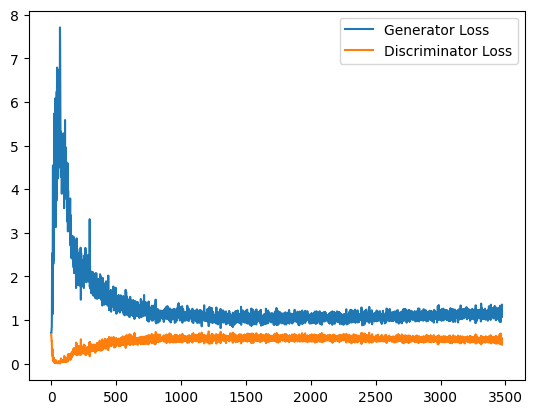

  0%|          | 0/469 [00:00<?, ?it/s]

Step 70000: Generator loss: 1.1592862647771836, discriminator loss: 0.5460266810655594


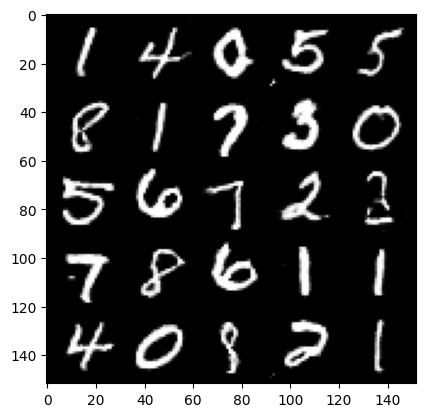

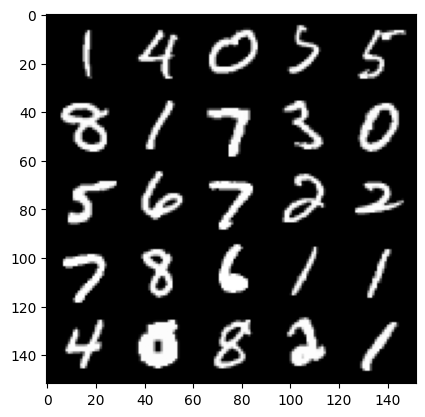

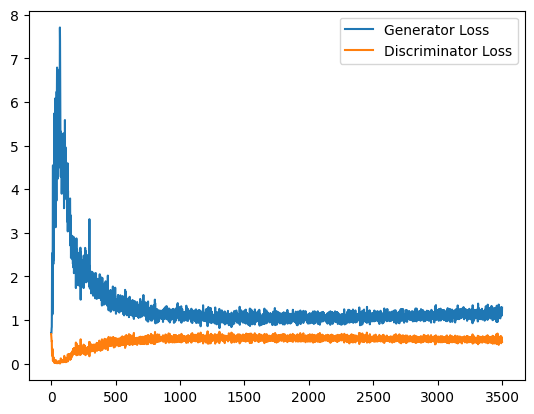

  0%|          | 0/469 [00:00<?, ?it/s]

Step 70500: Generator loss: 1.139434251189232, discriminator loss: 0.5408702715039253


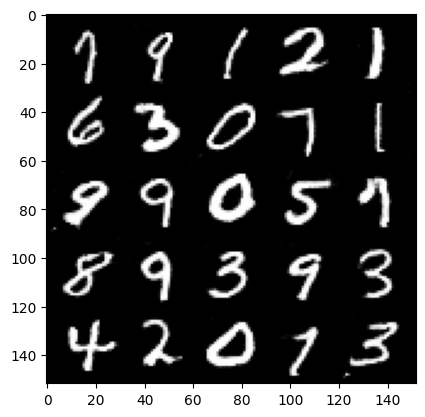

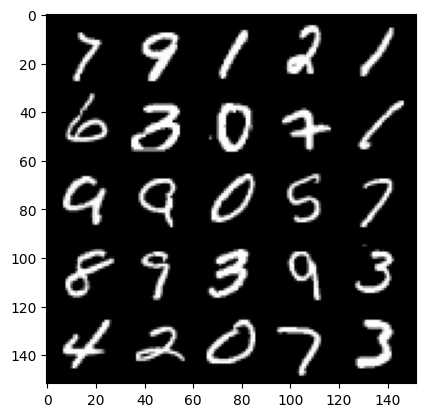

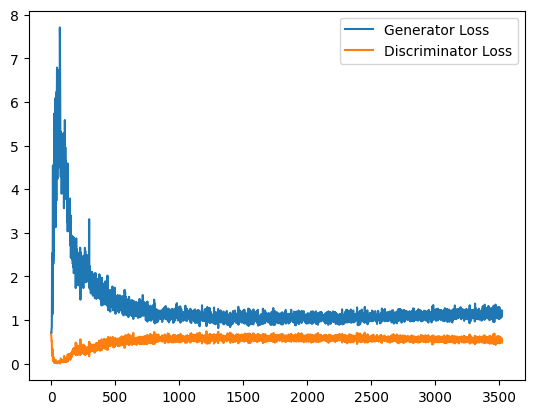

  0%|          | 0/469 [00:00<?, ?it/s]

Step 71000: Generator loss: 1.1500346904993057, discriminator loss: 0.5447649249434471


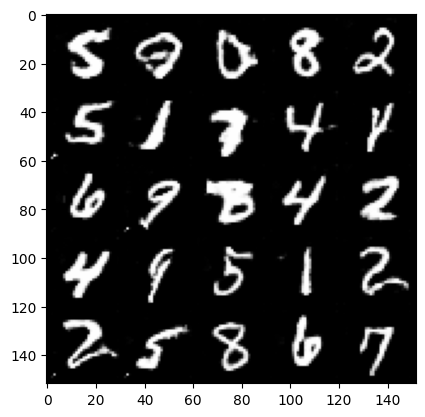

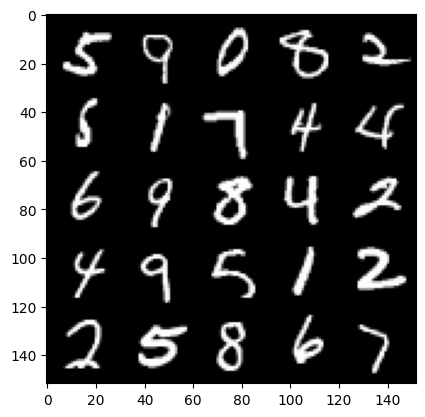

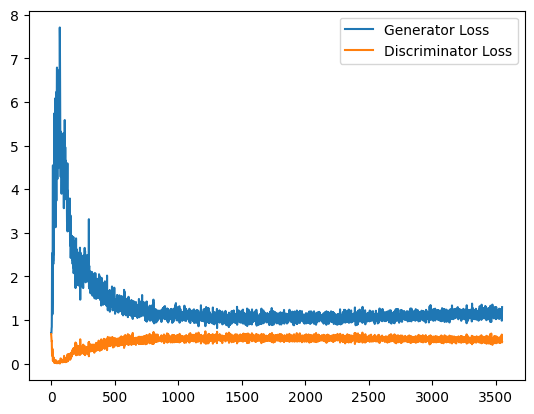

  0%|          | 0/469 [00:00<?, ?it/s]

Step 71500: Generator loss: 1.1613368228673935, discriminator loss: 0.5421679535508156


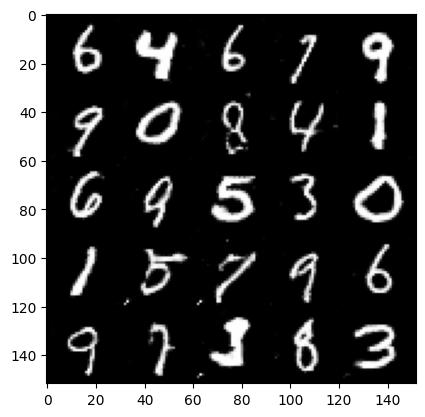

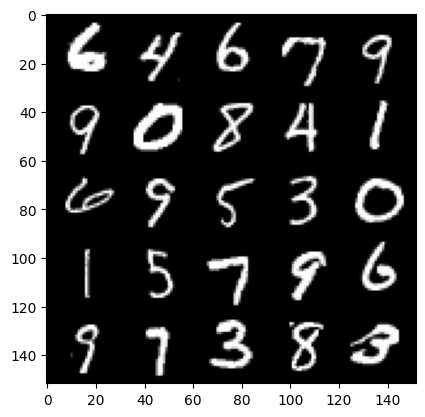

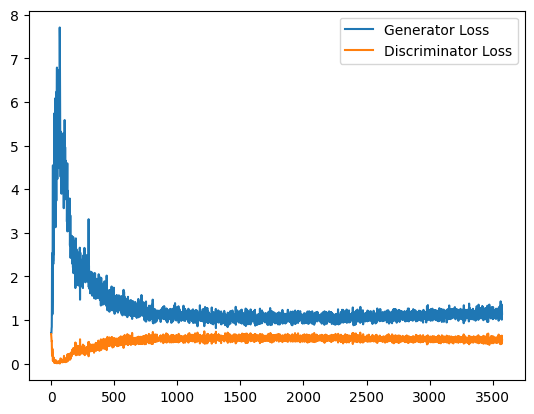

  0%|          | 0/469 [00:00<?, ?it/s]

Step 72000: Generator loss: 1.1684024286270143, discriminator loss: 0.5401208847761154


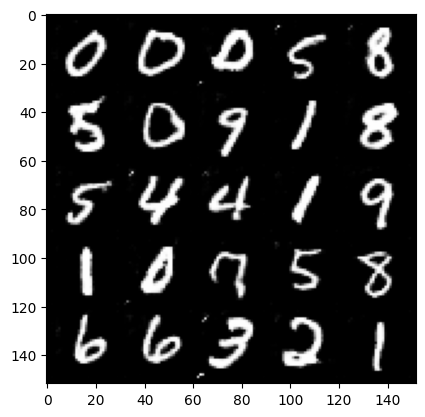

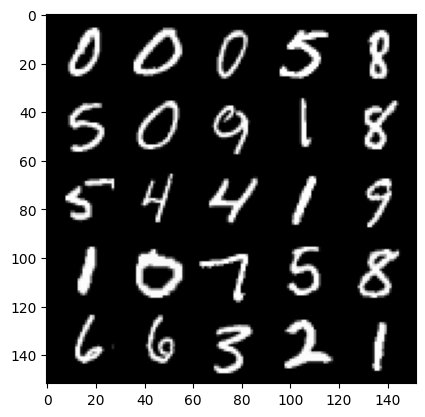

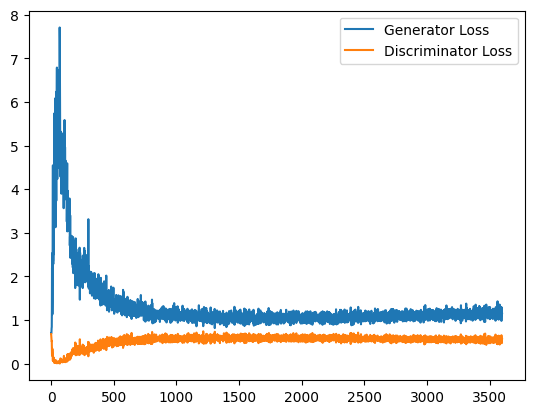

  0%|          | 0/469 [00:00<?, ?it/s]

Step 72500: Generator loss: 1.1548636454343795, discriminator loss: 0.5467850344181061


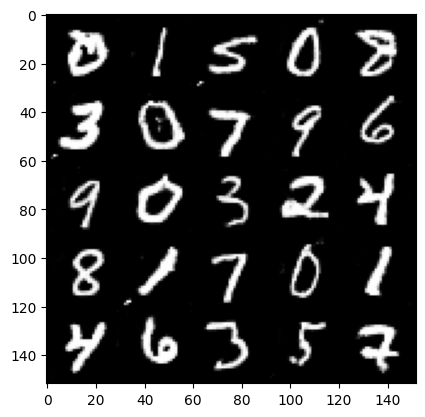

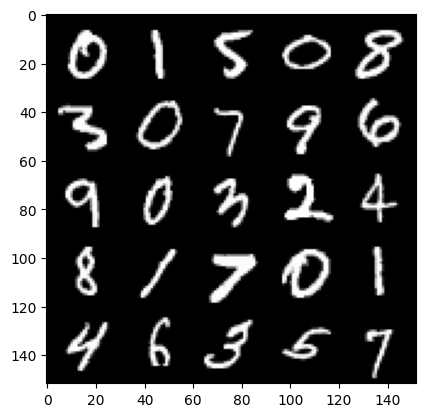

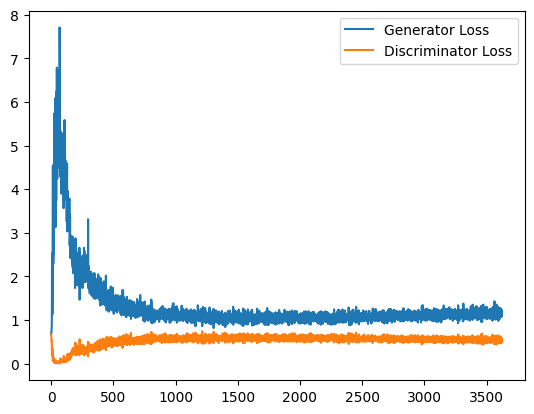

  0%|          | 0/469 [00:00<?, ?it/s]

Step 73000: Generator loss: 1.1596862630844116, discriminator loss: 0.53871834897995


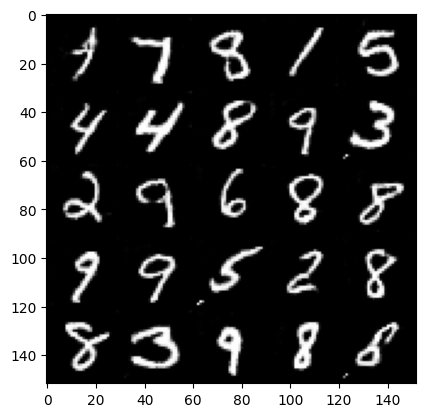

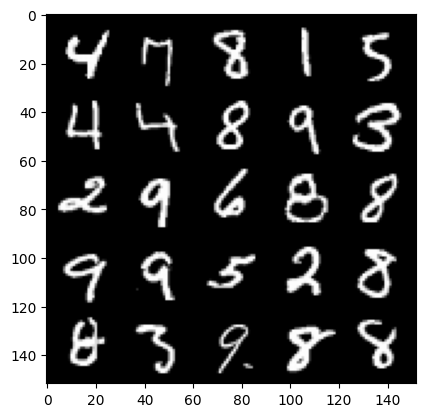

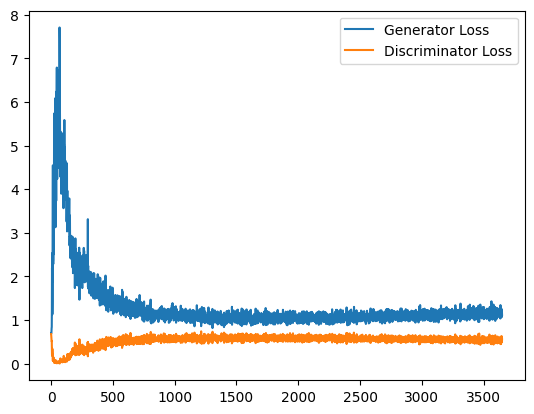

  0%|          | 0/469 [00:00<?, ?it/s]

Step 73500: Generator loss: 1.166881696820259, discriminator loss: 0.5398318045139313


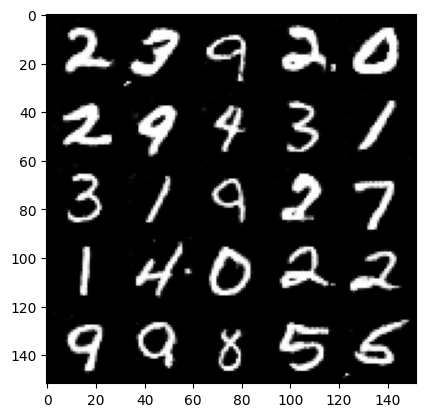

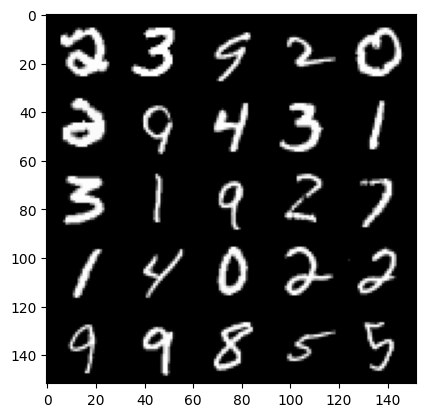

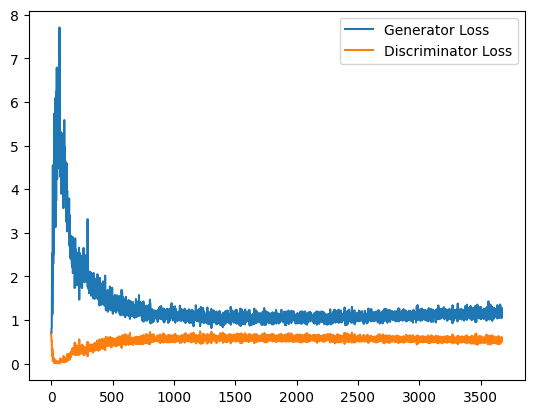

  0%|          | 0/469 [00:00<?, ?it/s]

Step 74000: Generator loss: 1.1734626653194427, discriminator loss: 0.5374460971951485


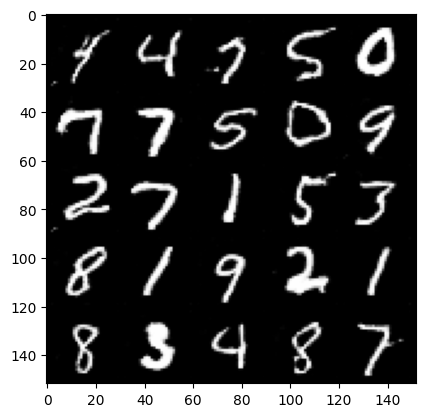

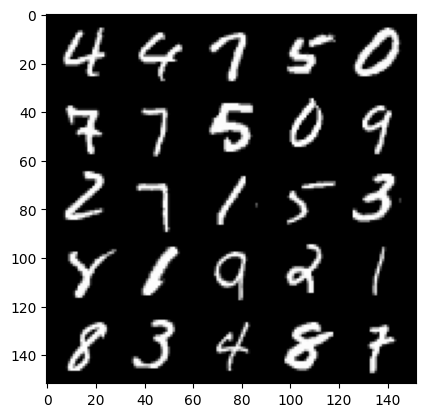

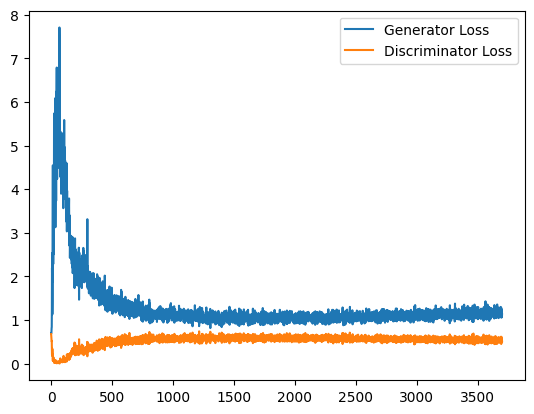

  0%|          | 0/469 [00:00<?, ?it/s]

Step 74500: Generator loss: 1.1696810173988341, discriminator loss: 0.5380747416615486


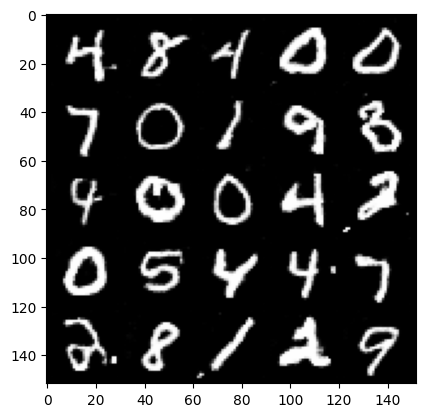

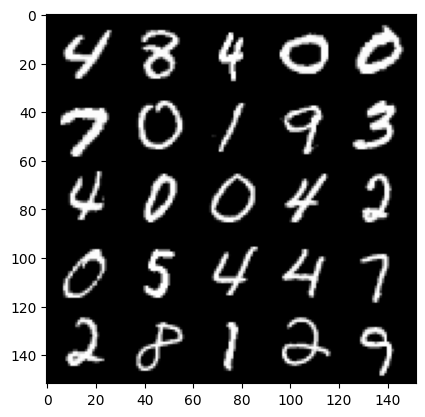

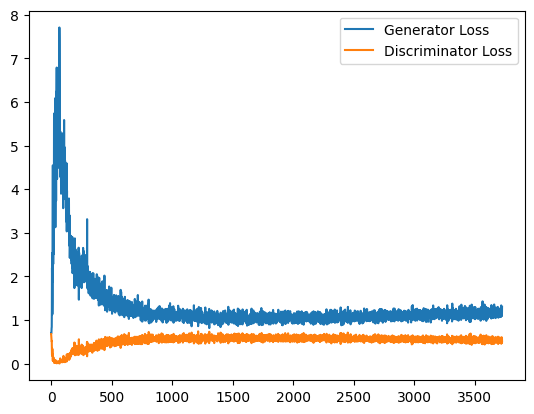

  0%|          | 0/469 [00:00<?, ?it/s]

Step 75000: Generator loss: 1.1766681480407715, discriminator loss: 0.5401086875200272


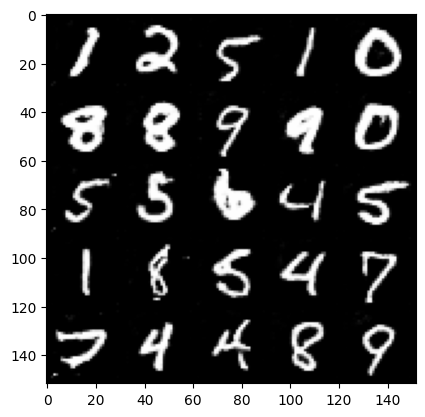

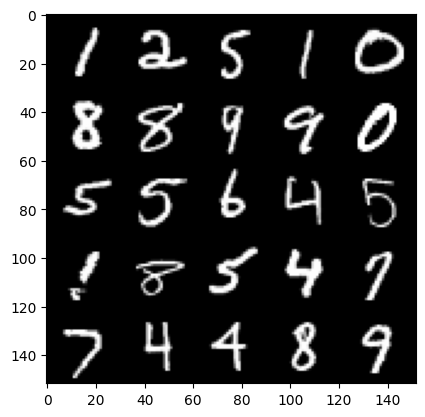

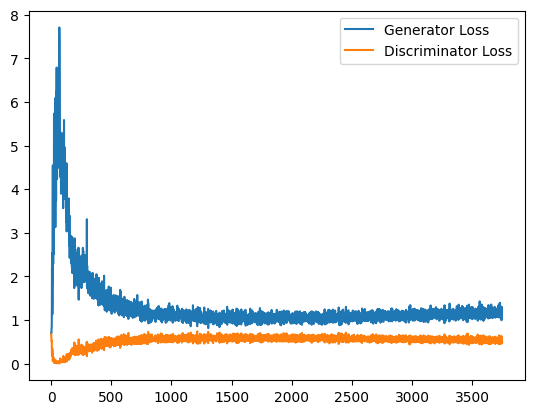

  0%|          | 0/469 [00:00<?, ?it/s]

Step 75500: Generator loss: 1.177649451971054, discriminator loss: 0.5361564808487892


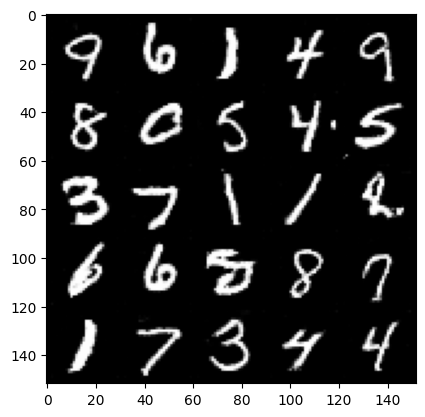

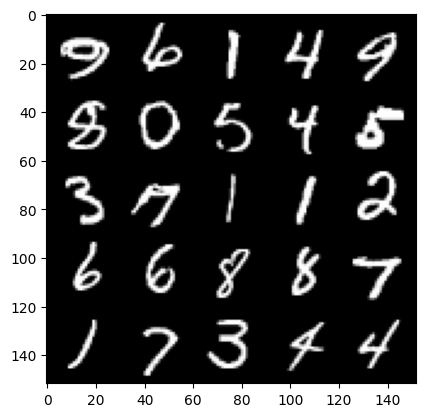

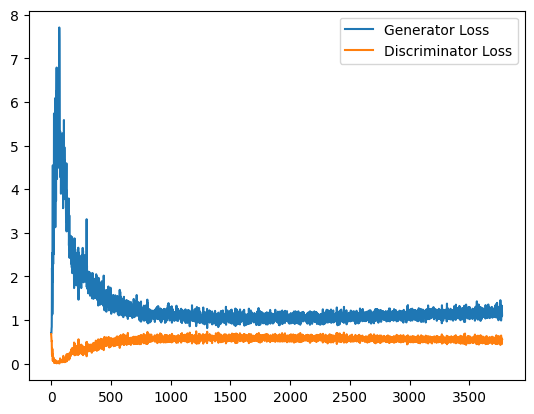

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

Step 76000: Generator loss: 1.1854832313060761, discriminator loss: 0.5377591236233711


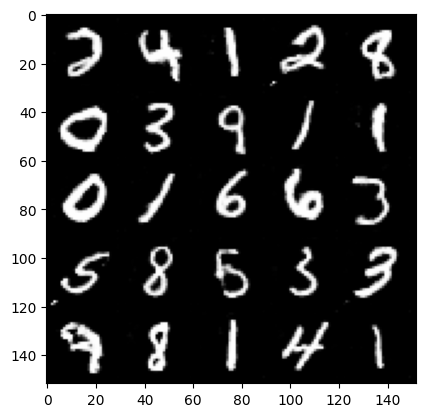

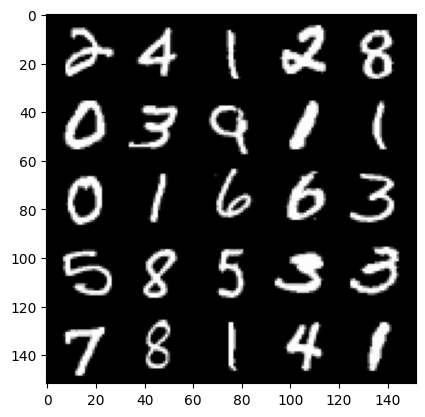

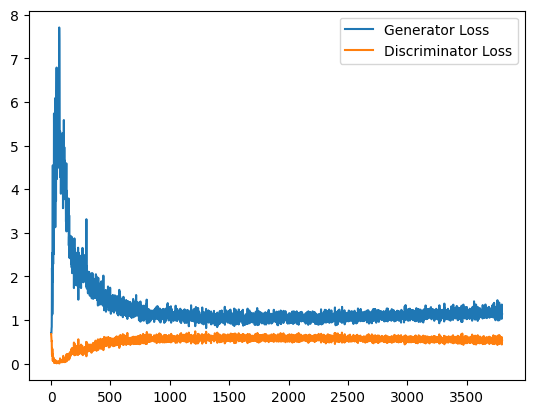

  0%|          | 0/469 [00:00<?, ?it/s]

Step 76500: Generator loss: 1.1602547671794892, discriminator loss: 0.5354065556526184


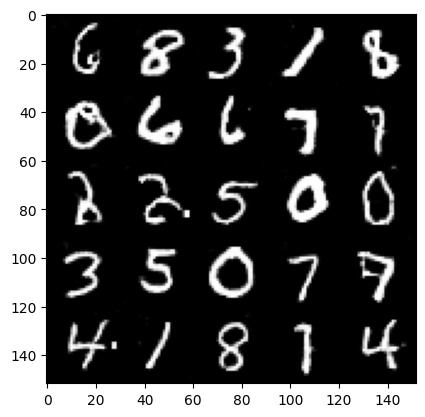

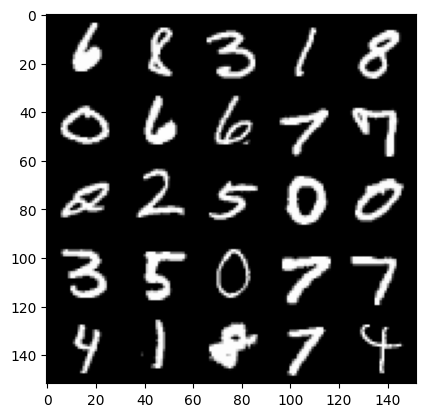

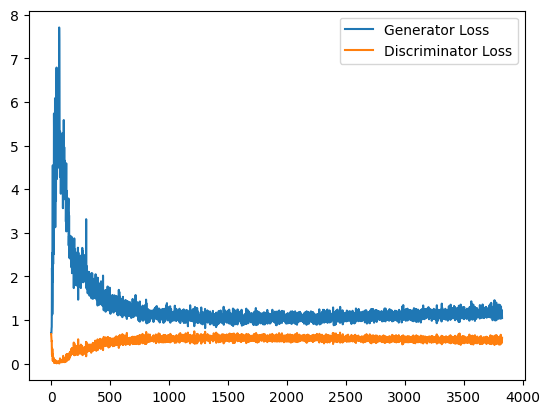

  0%|          | 0/469 [00:00<?, ?it/s]

Step 77000: Generator loss: 1.198385830283165, discriminator loss: 0.5317086327672005


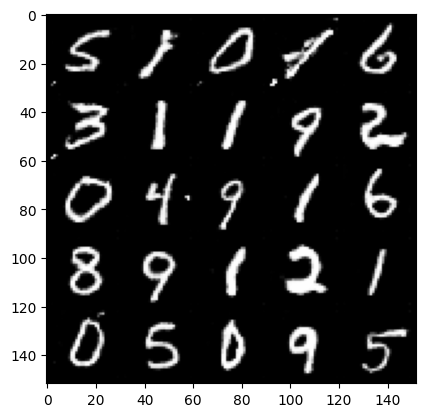

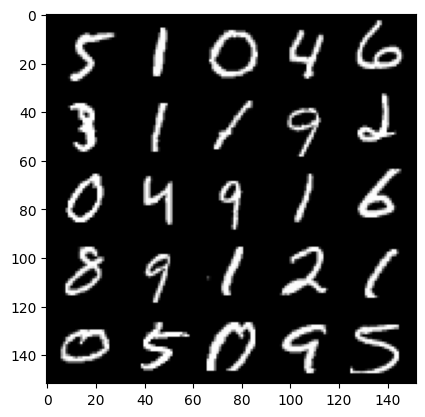

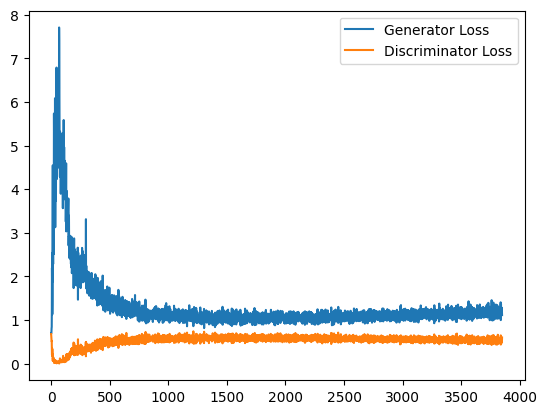

  0%|          | 0/469 [00:00<?, ?it/s]

Step 77500: Generator loss: 1.1911338920593262, discriminator loss: 0.5302066277265549


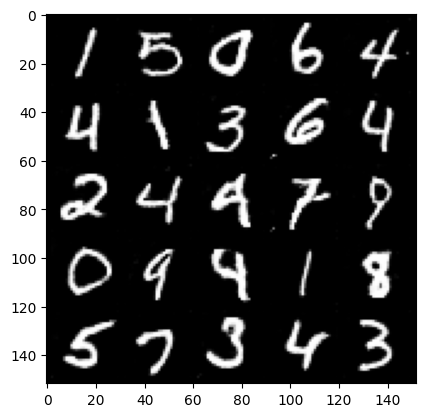

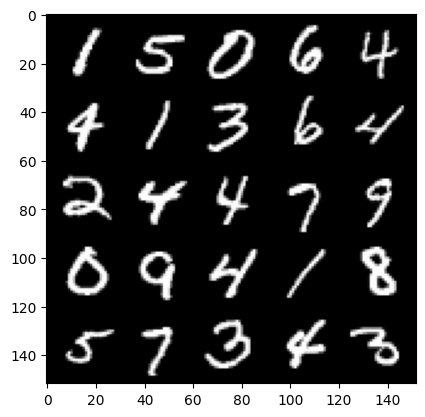

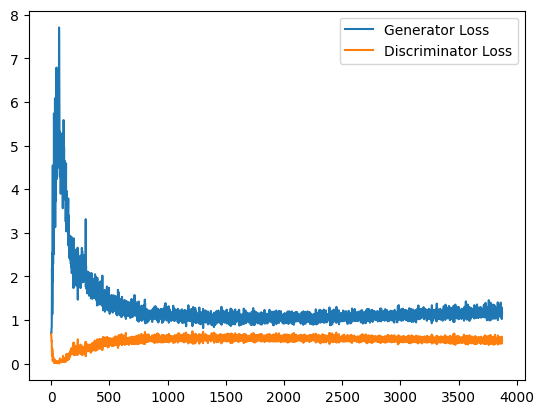

  0%|          | 0/469 [00:00<?, ?it/s]

Step 78000: Generator loss: 1.1717181007862092, discriminator loss: 0.5375882377028465


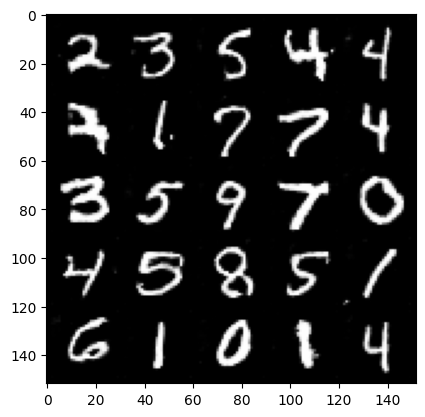

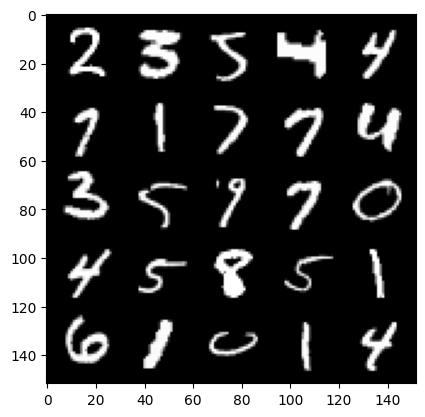

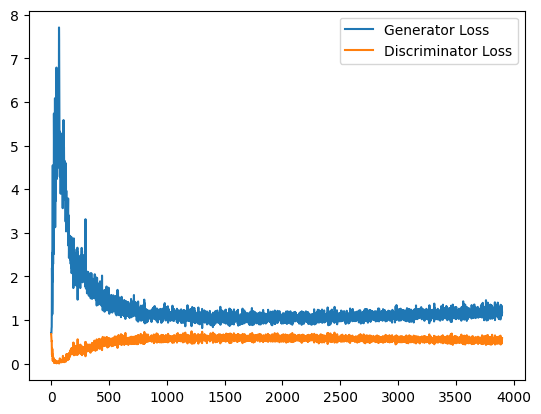

  0%|          | 0/469 [00:00<?, ?it/s]

Step 78500: Generator loss: 1.1955635316371918, discriminator loss: 0.5392813885211944


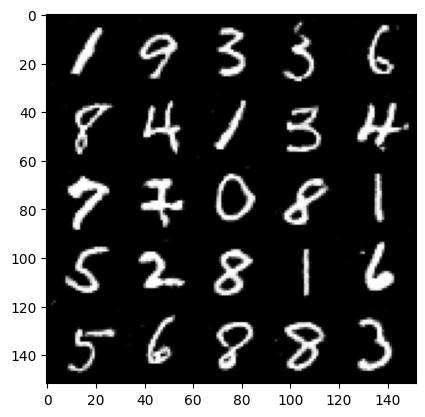

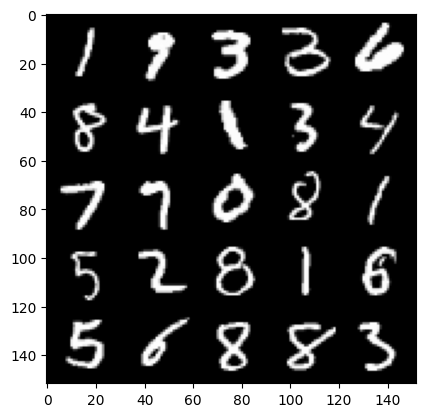

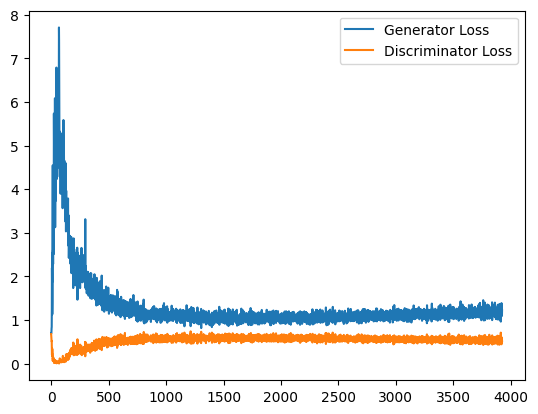

  0%|          | 0/469 [00:00<?, ?it/s]

Step 79000: Generator loss: 1.1788042249679564, discriminator loss: 0.5369810798168182


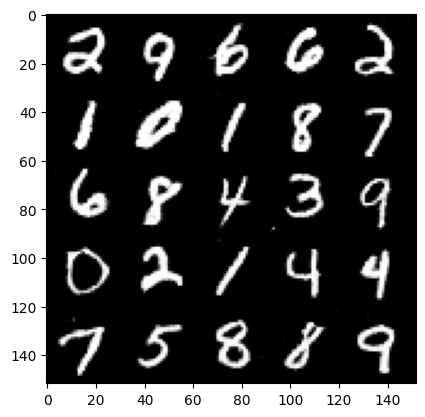

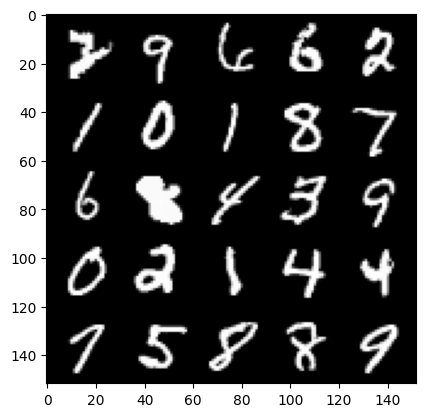

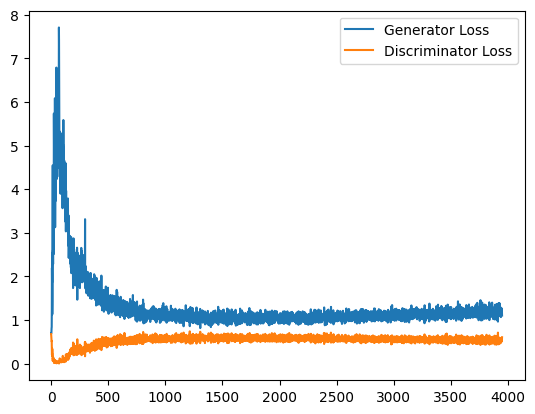

  0%|          | 0/469 [00:00<?, ?it/s]

Step 79500: Generator loss: 1.206946676850319, discriminator loss: 0.530047712802887


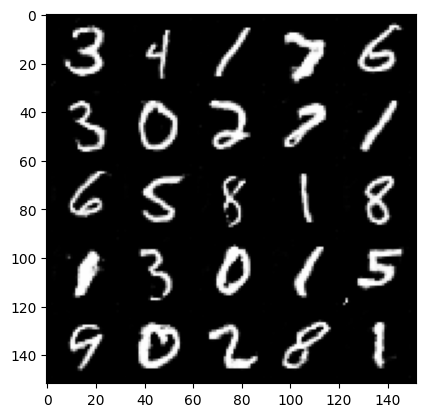

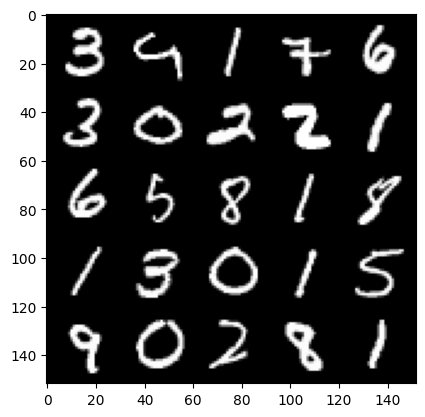

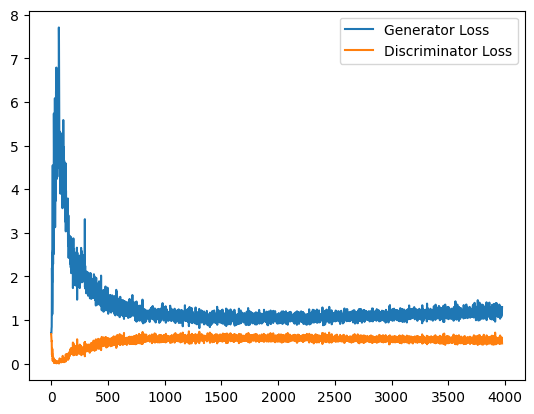

  0%|          | 0/469 [00:00<?, ?it/s]

Step 80000: Generator loss: 1.1726456655263902, discriminator loss: 0.5379929651021957


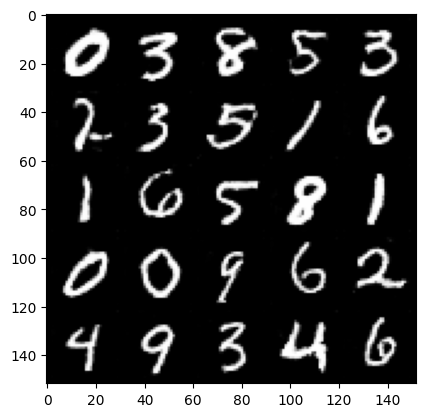

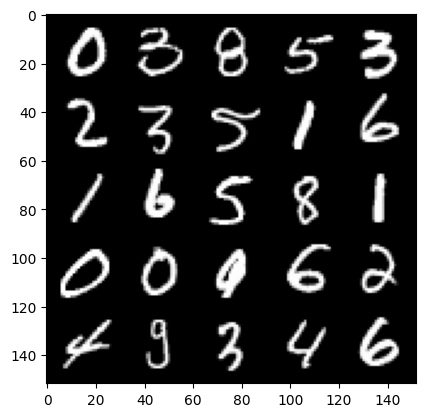

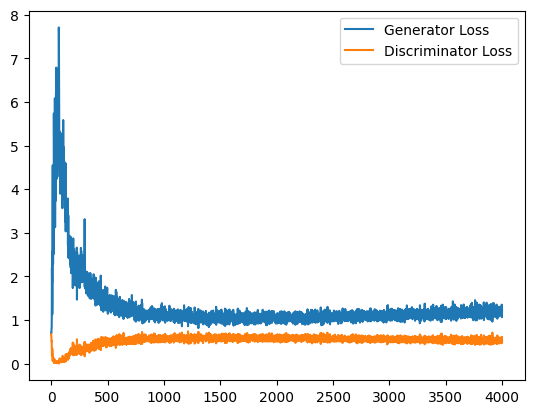

  0%|          | 0/469 [00:00<?, ?it/s]

Step 80500: Generator loss: 1.1852579690217973, discriminator loss: 0.5404464217424393


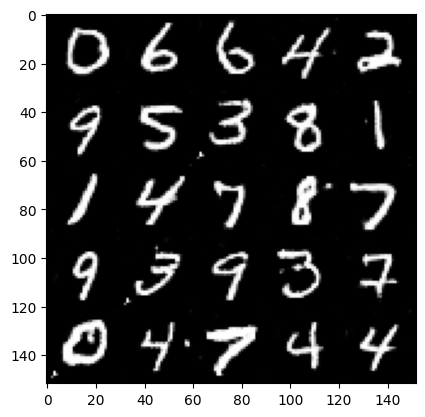

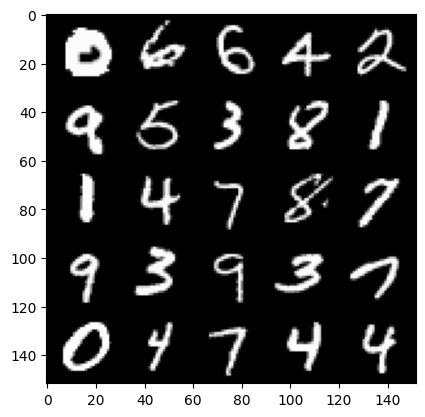

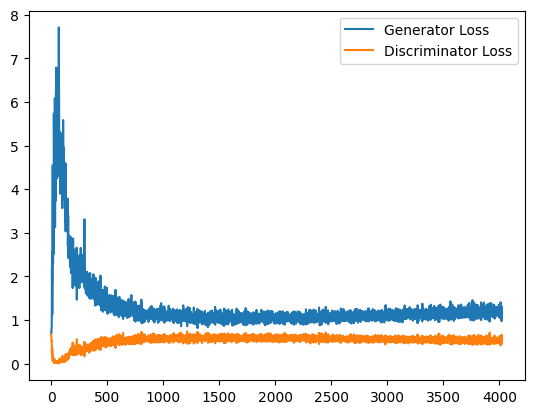

  0%|          | 0/469 [00:00<?, ?it/s]

Step 81000: Generator loss: 1.1771399421691895, discriminator loss: 0.5368408106565475


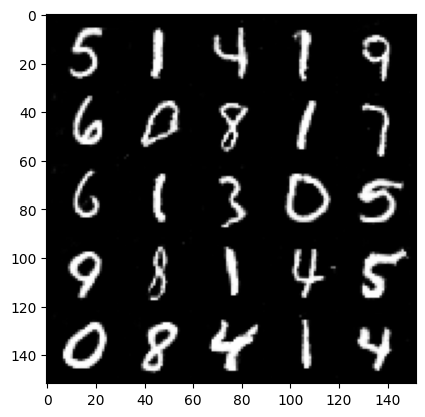

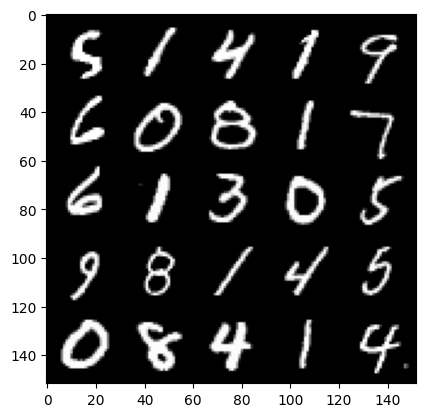

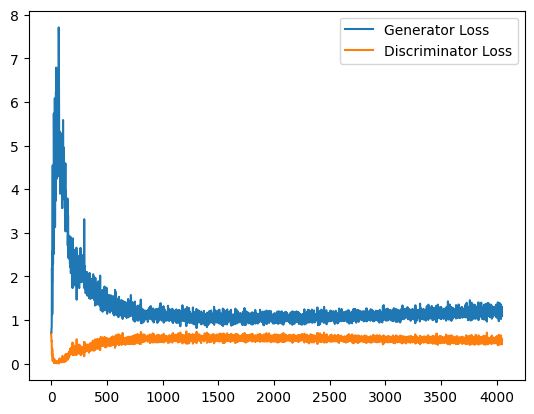

  0%|          | 0/469 [00:00<?, ?it/s]

Step 81500: Generator loss: 1.1670937848091125, discriminator loss: 0.531333720445633


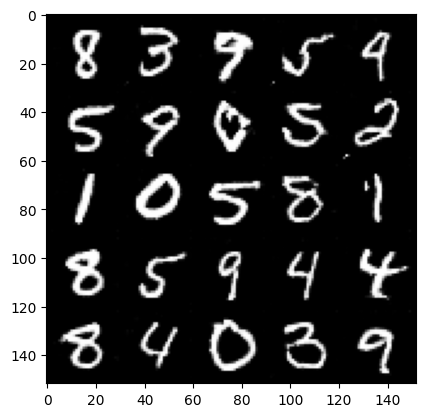

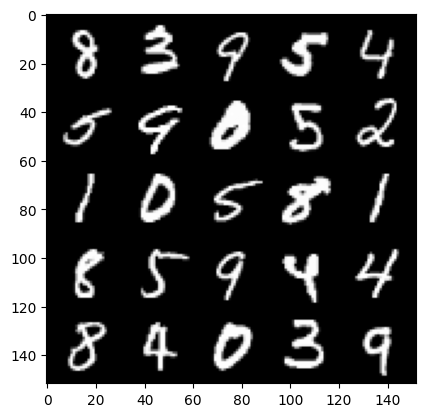

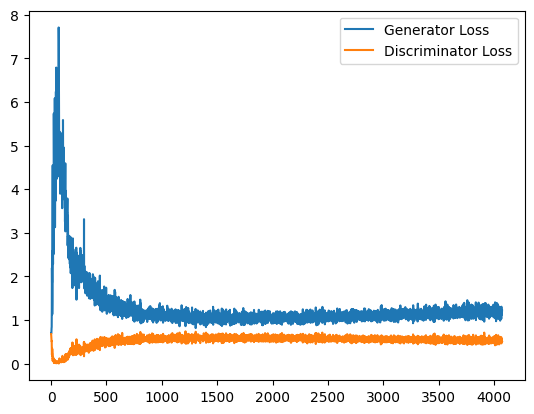

  0%|          | 0/469 [00:00<?, ?it/s]

Step 82000: Generator loss: 1.19176553440094, discriminator loss: 0.5375550511479378


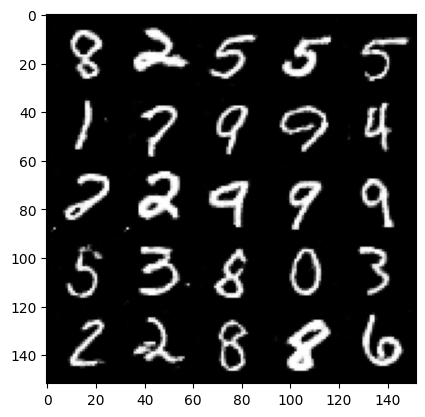

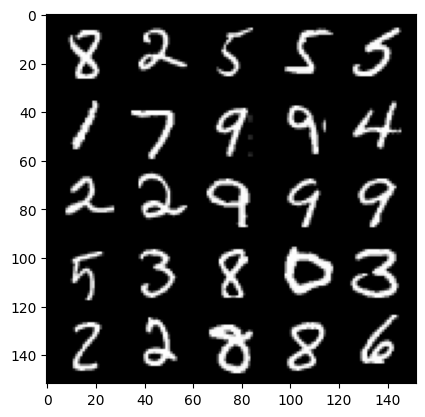

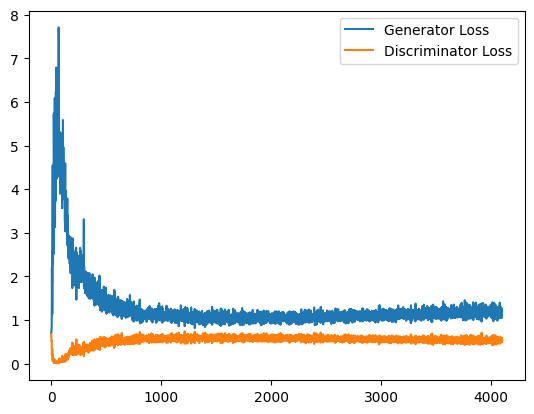

  0%|          | 0/469 [00:00<?, ?it/s]

Step 82500: Generator loss: 1.192006283044815, discriminator loss: 0.5332693254947662


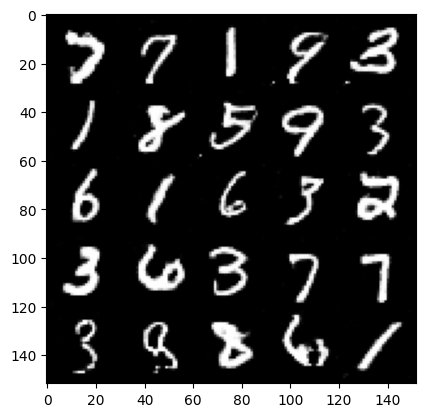

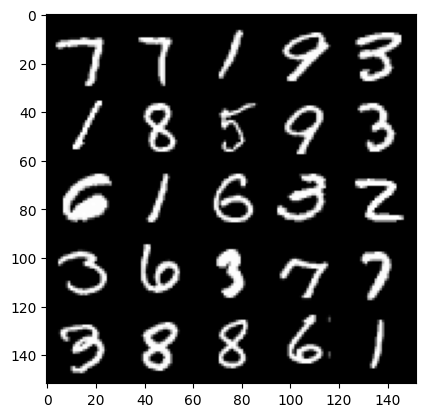

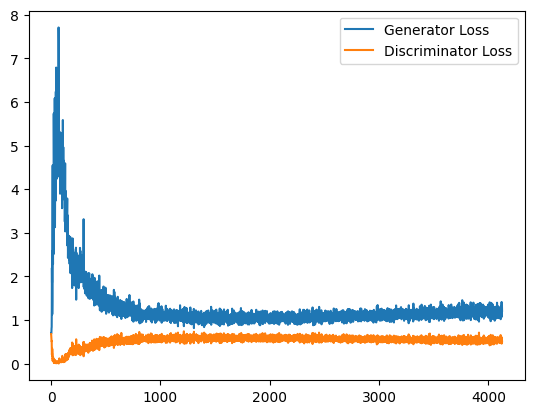

  0%|          | 0/469 [00:00<?, ?it/s]

Step 83000: Generator loss: 1.1770054605007172, discriminator loss: 0.532489687860012


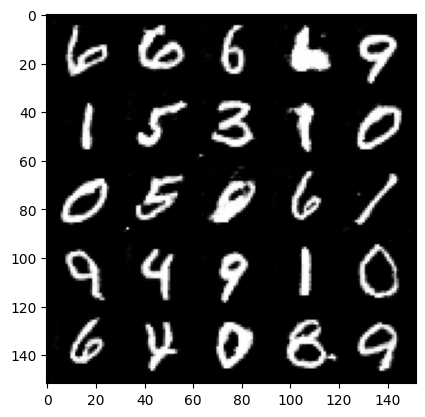

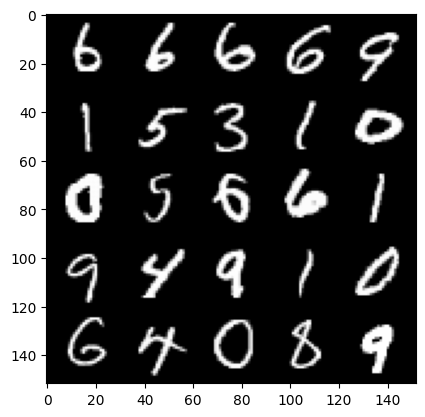

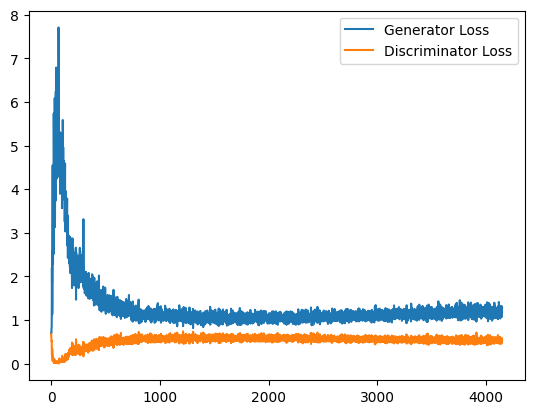

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

Step 83500: Generator loss: 1.2082143861055374, discriminator loss: 0.5354333644509316


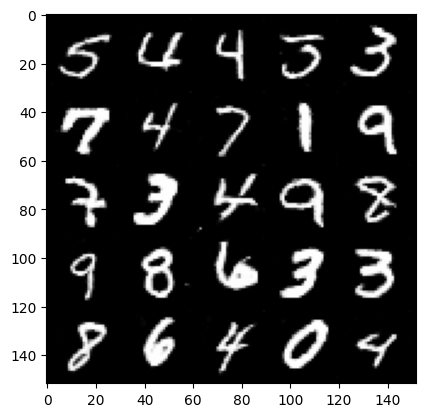

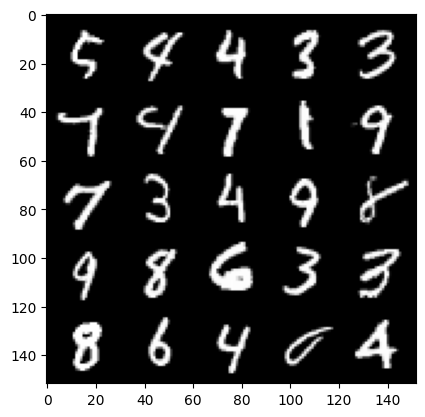

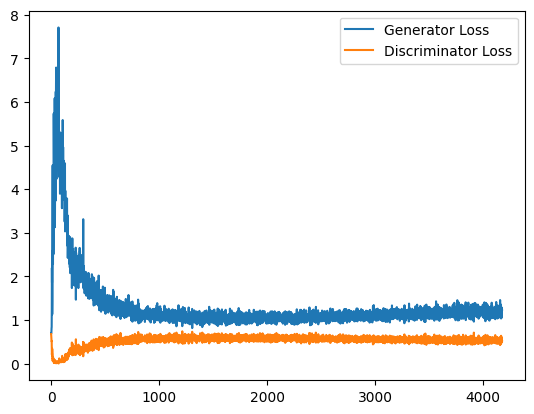

  0%|          | 0/469 [00:00<?, ?it/s]

Step 84000: Generator loss: 1.2063357880115508, discriminator loss: 0.5322659634947777


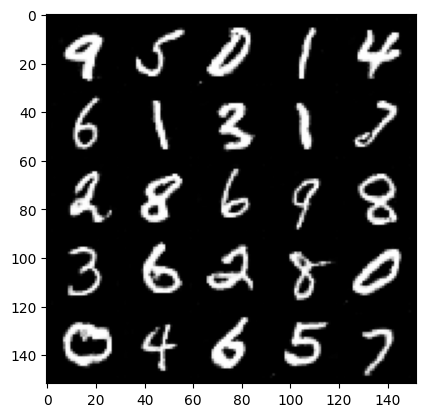

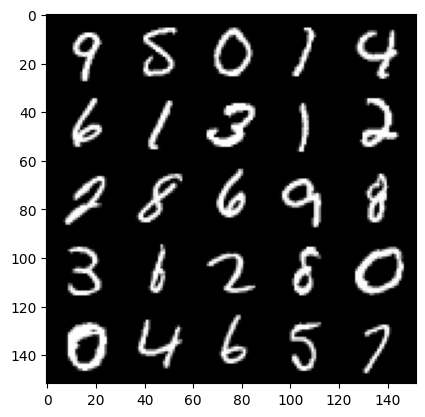

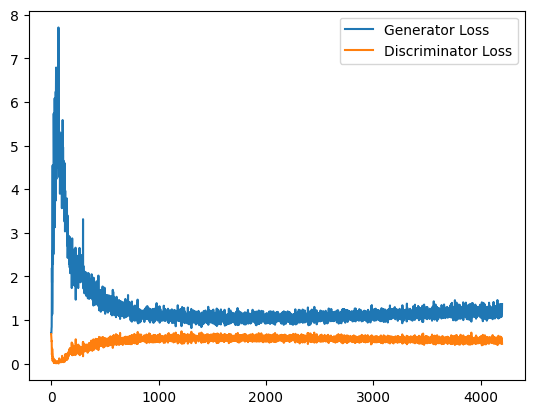

  0%|          | 0/469 [00:00<?, ?it/s]

Step 84500: Generator loss: 1.1931228553056716, discriminator loss: 0.533769204378128


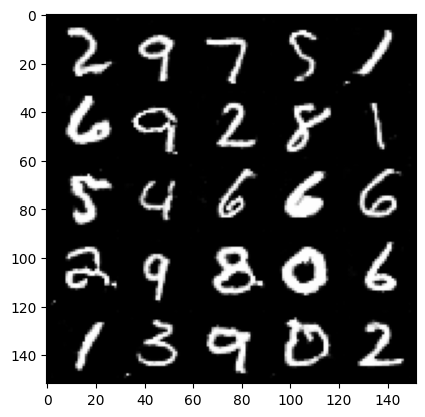

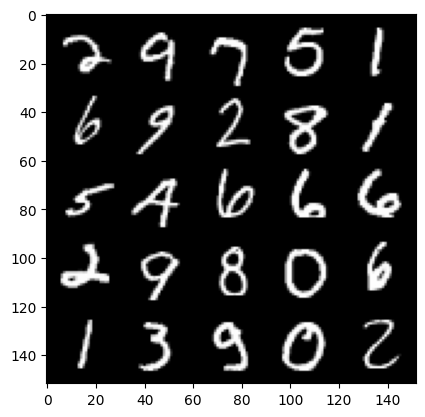

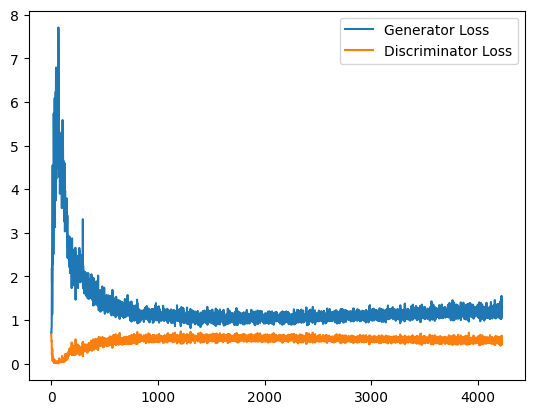

  0%|          | 0/469 [00:00<?, ?it/s]

Step 85000: Generator loss: 1.2000985219478608, discriminator loss: 0.5397477384209632


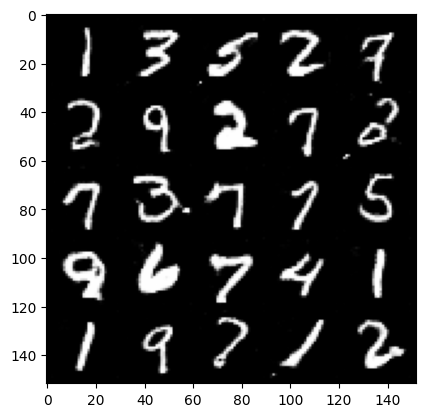

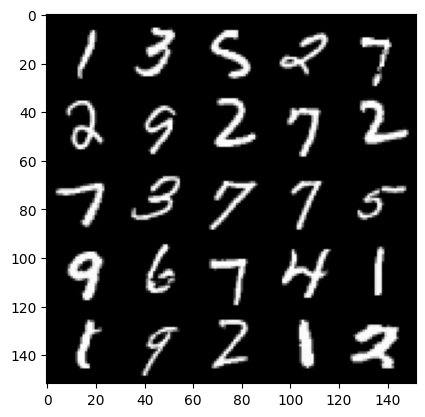

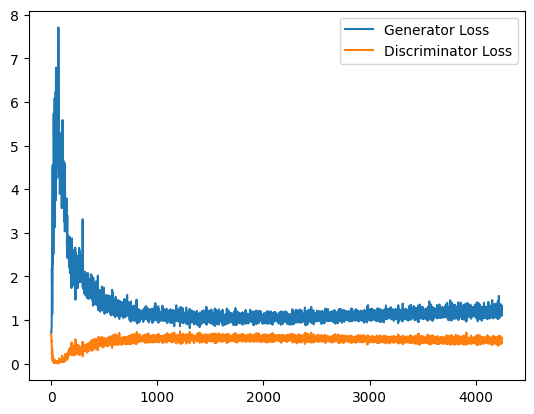

  0%|          | 0/469 [00:00<?, ?it/s]

Step 85500: Generator loss: 1.181920008301735, discriminator loss: 0.5323658308982849


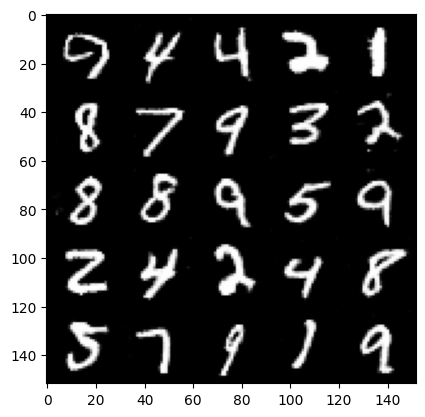

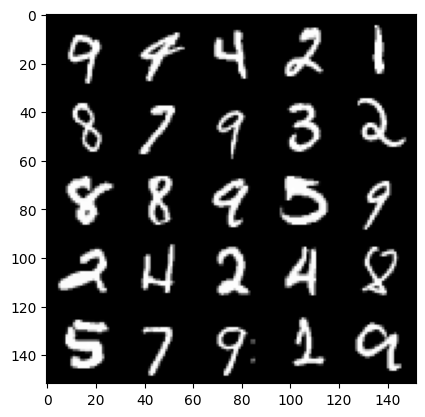

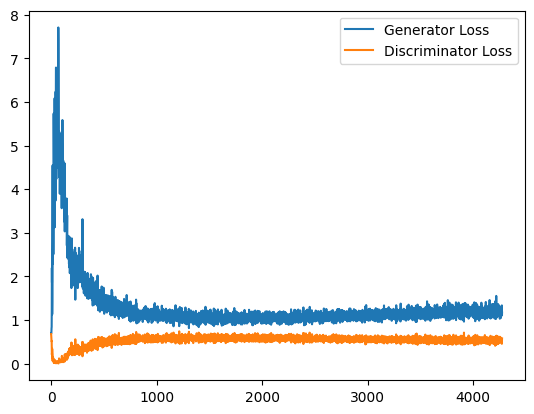

  0%|          | 0/469 [00:00<?, ?it/s]

Step 86000: Generator loss: 1.1869063477516175, discriminator loss: 0.5316940958499908


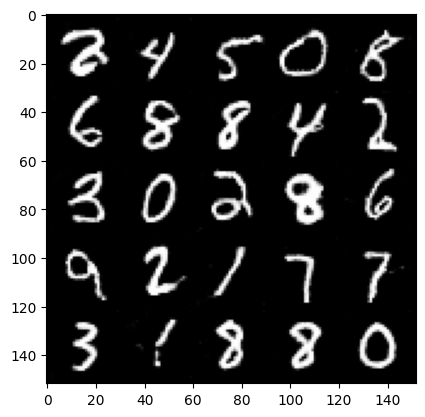

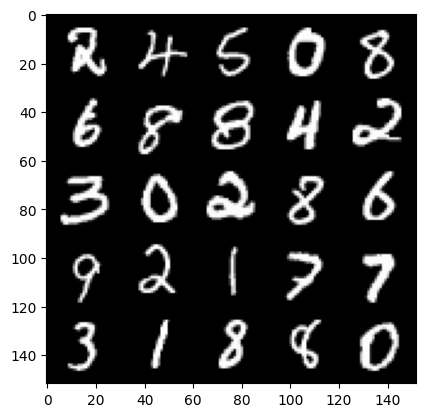

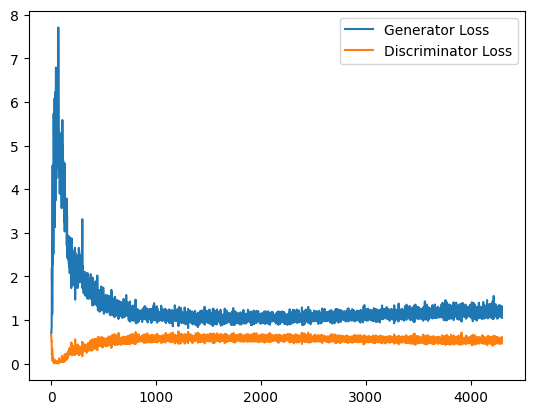

  0%|          | 0/469 [00:00<?, ?it/s]

Step 86500: Generator loss: 1.1854064439535141, discriminator loss: 0.5318542098402977


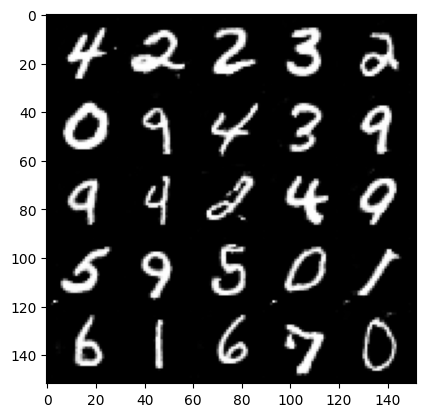

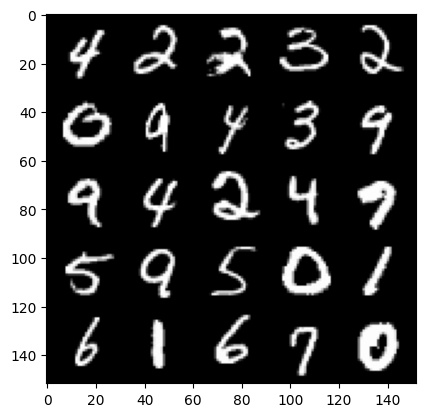

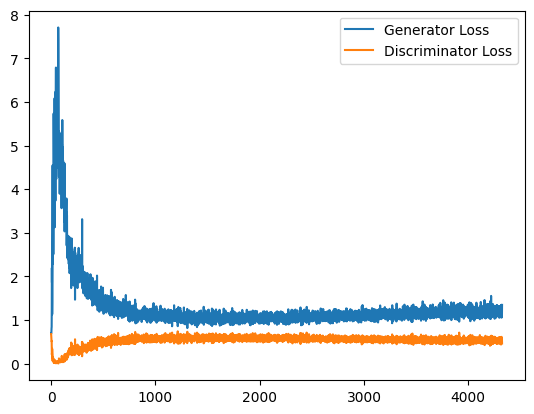

  0%|          | 0/469 [00:00<?, ?it/s]

Step 87000: Generator loss: 1.20229532456398, discriminator loss: 0.5320859903693199


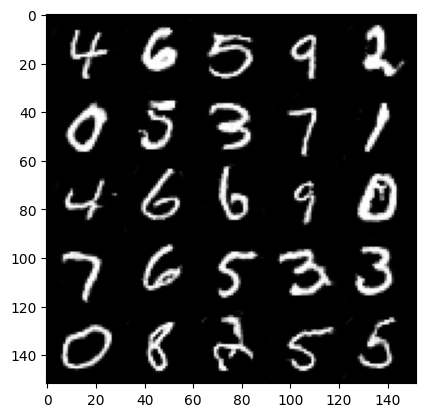

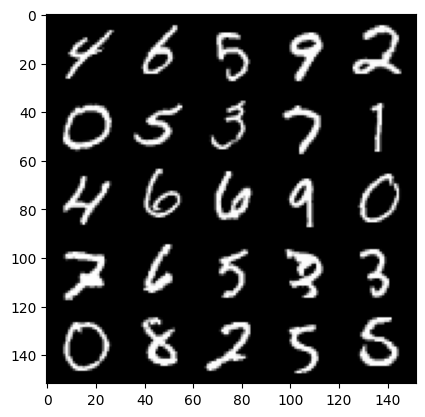

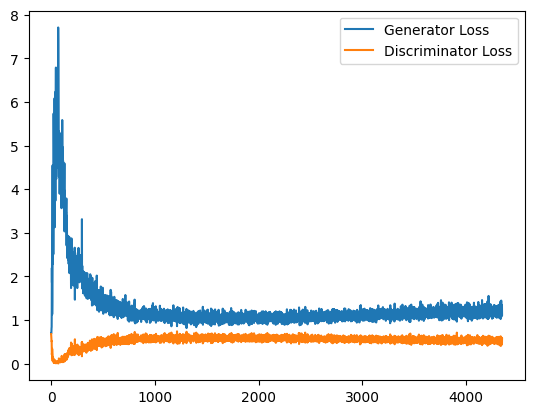

  0%|          | 0/469 [00:00<?, ?it/s]

Step 87500: Generator loss: 1.2000946046113967, discriminator loss: 0.5312363718152047


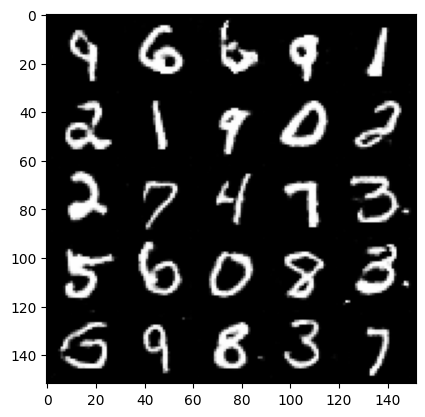

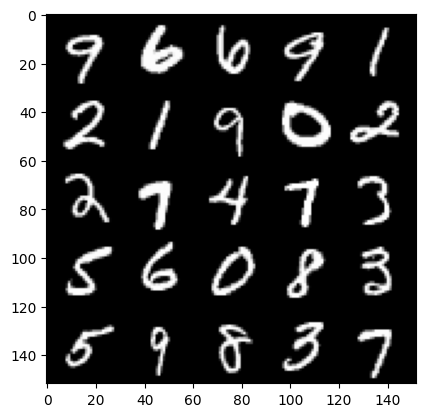

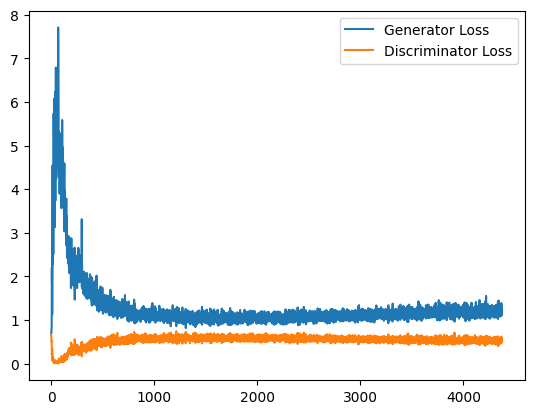

  0%|          | 0/469 [00:00<?, ?it/s]

Step 88000: Generator loss: 1.2016926875114442, discriminator loss: 0.5406354417204857


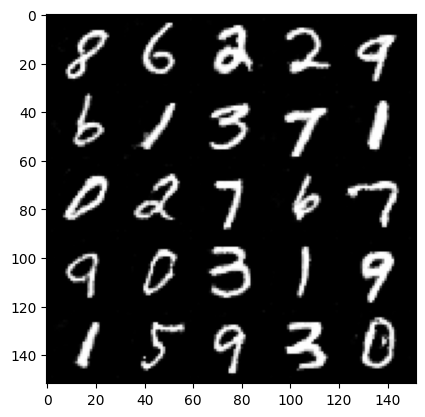

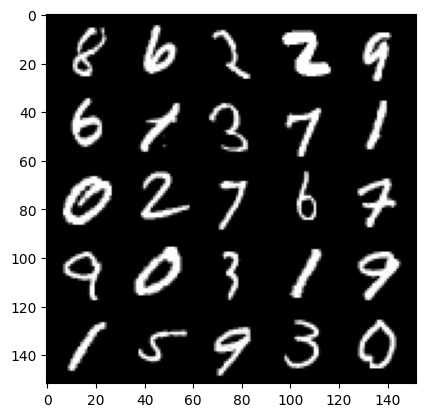

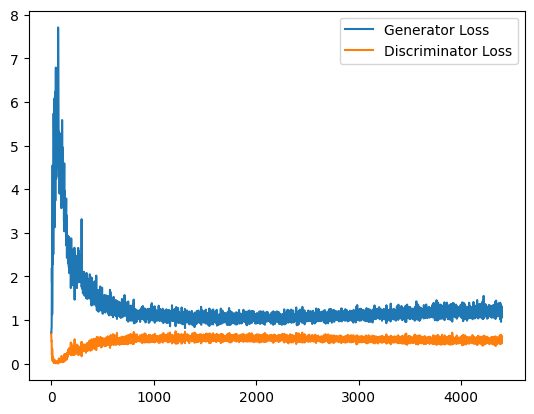

  0%|          | 0/469 [00:00<?, ?it/s]

Step 88500: Generator loss: 1.2267655826807022, discriminator loss: 0.5322005767822265


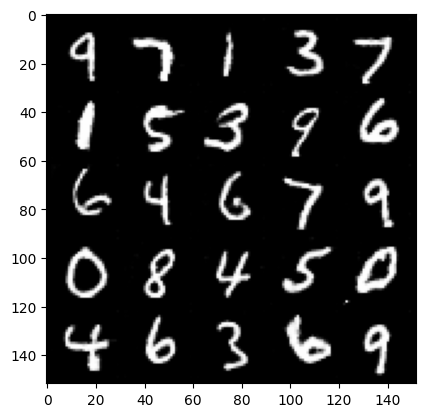

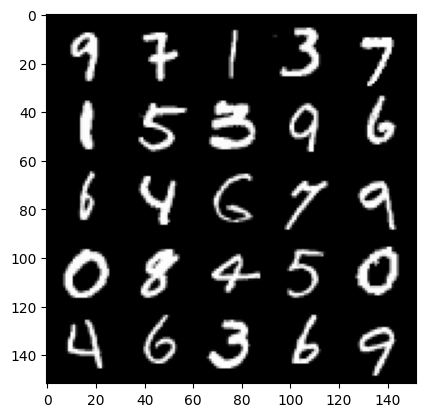

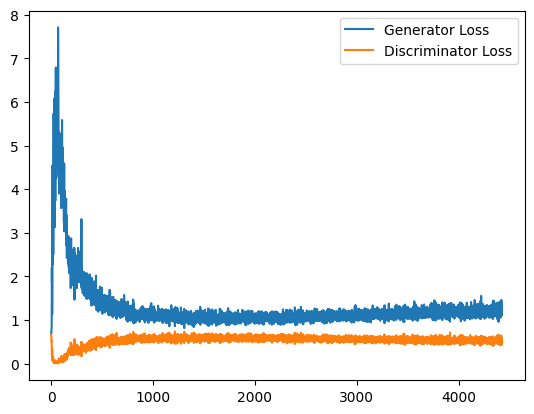

  0%|          | 0/469 [00:00<?, ?it/s]

Step 89000: Generator loss: 1.1869821405410768, discriminator loss: 0.5345634022355079


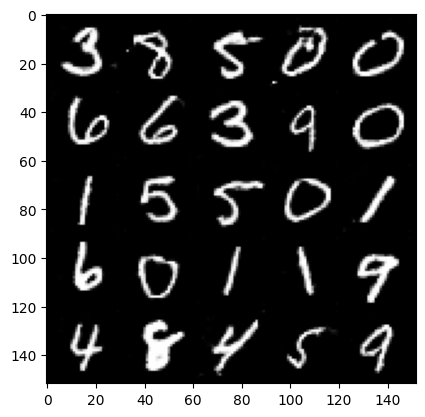

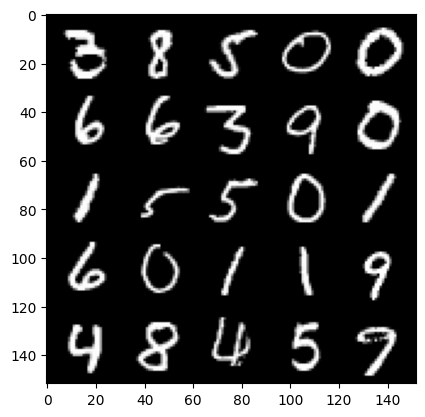

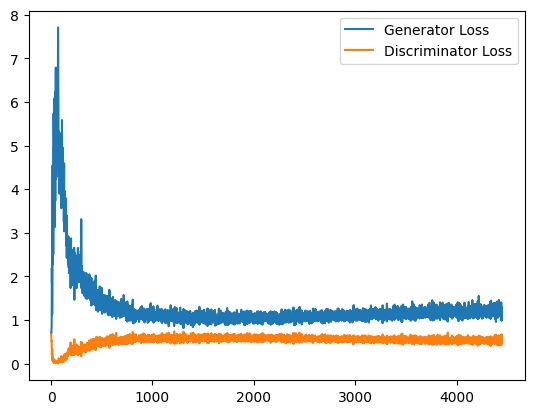

  0%|          | 0/469 [00:00<?, ?it/s]

Step 89500: Generator loss: 1.186287299633026, discriminator loss: 0.5429515094161034


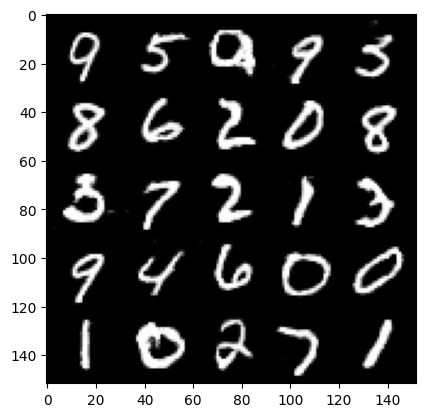

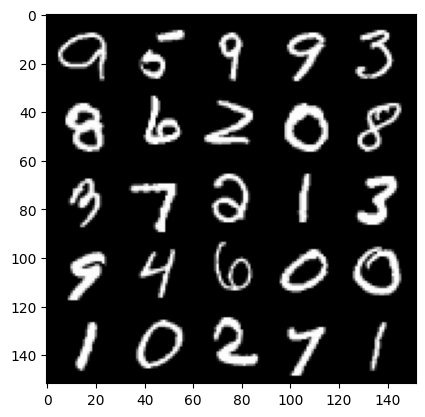

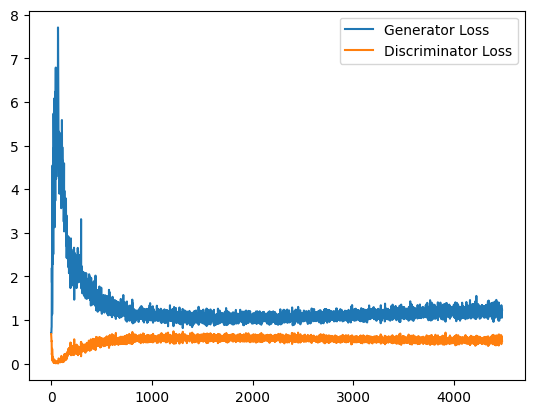

  0%|          | 0/469 [00:00<?, ?it/s]

Step 90000: Generator loss: 1.1963873655796051, discriminator loss: 0.5364698106646538


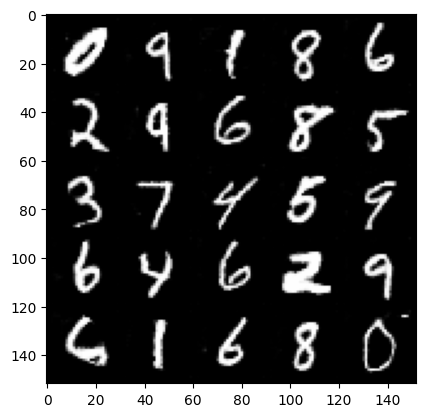

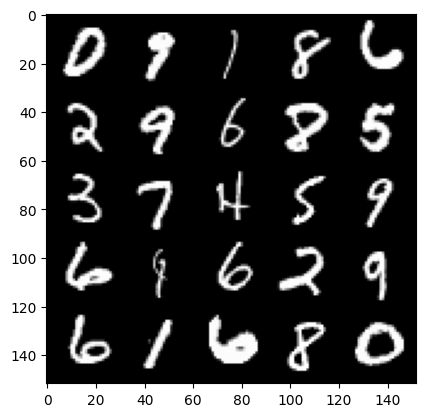

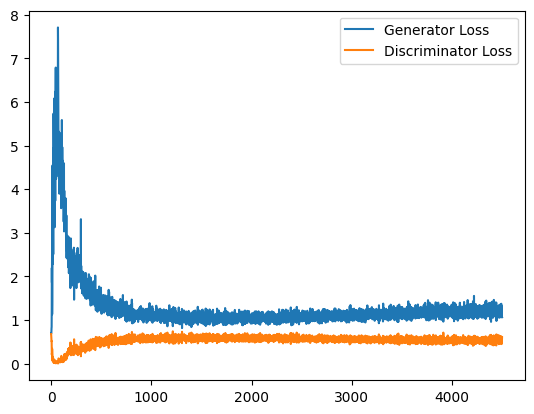

  0%|          | 0/469 [00:00<?, ?it/s]

Step 90500: Generator loss: 1.232847704768181, discriminator loss: 0.5315149301886558


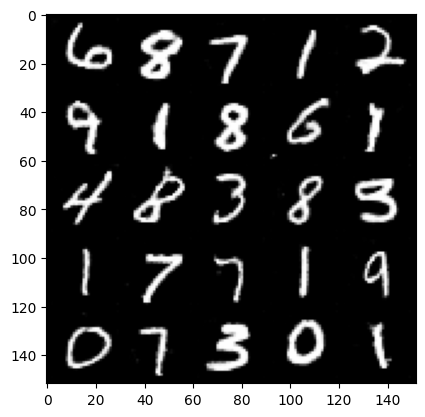

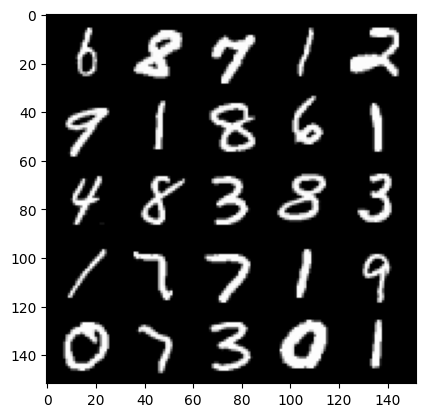

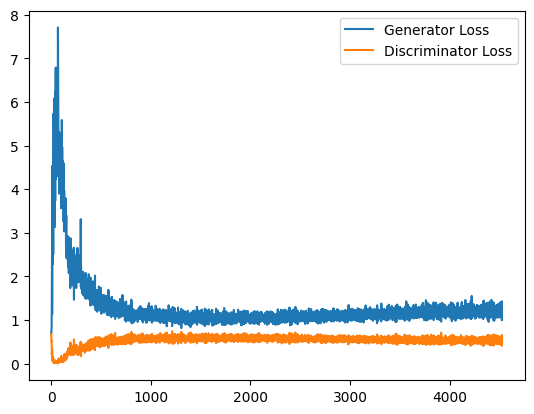

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

Step 91000: Generator loss: 1.1939817399978638, discriminator loss: 0.5347873041629791


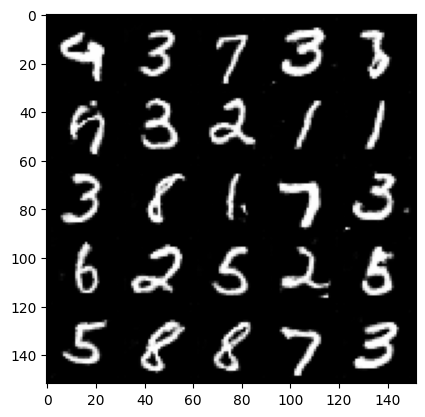

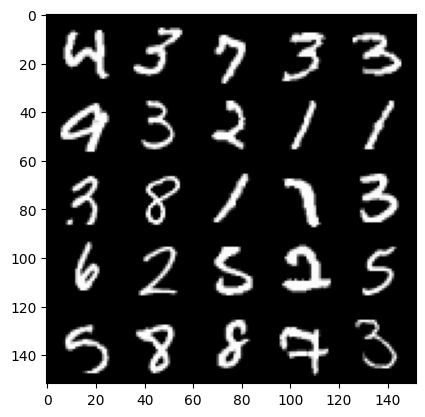

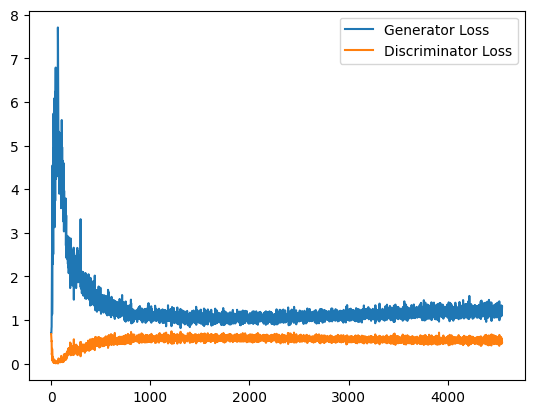

  0%|          | 0/469 [00:00<?, ?it/s]

Step 91500: Generator loss: 1.1881708977222443, discriminator loss: 0.5367742620706558


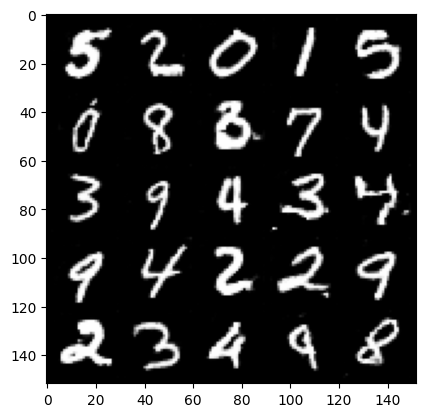

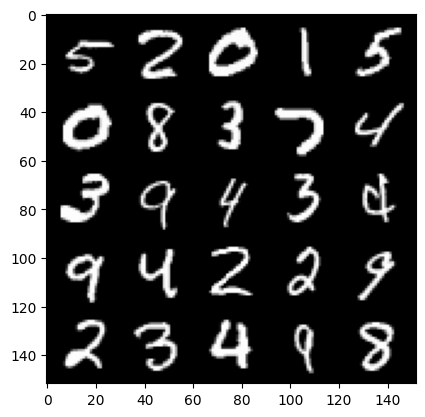

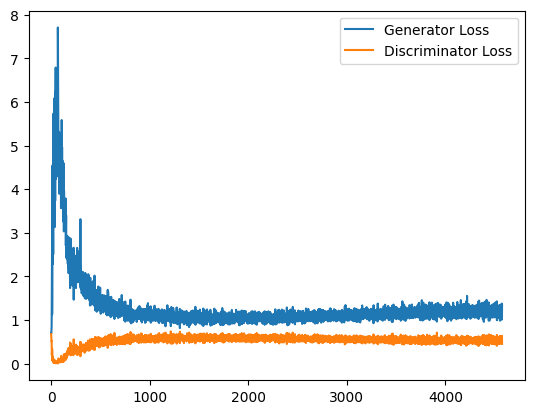

  0%|          | 0/469 [00:00<?, ?it/s]

Step 92000: Generator loss: 1.190597455739975, discriminator loss: 0.5292770691514015


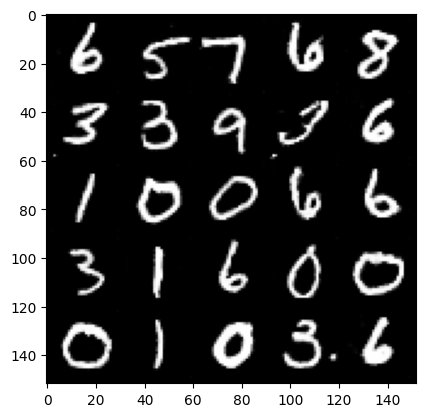

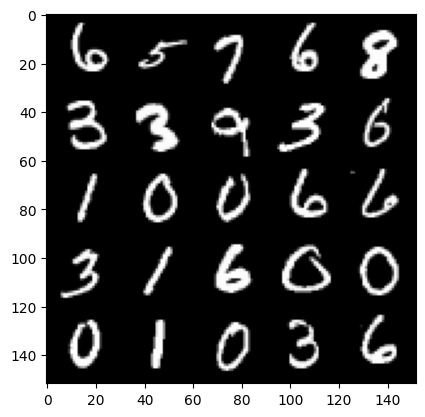

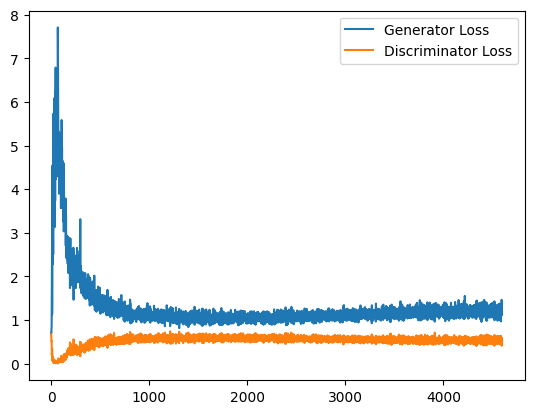

  0%|          | 0/469 [00:00<?, ?it/s]

Step 92500: Generator loss: 1.1904290912151336, discriminator loss: 0.5404843195080757


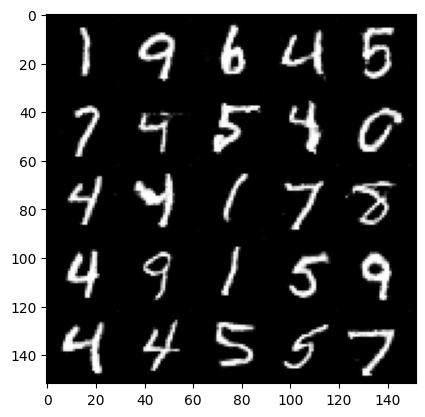

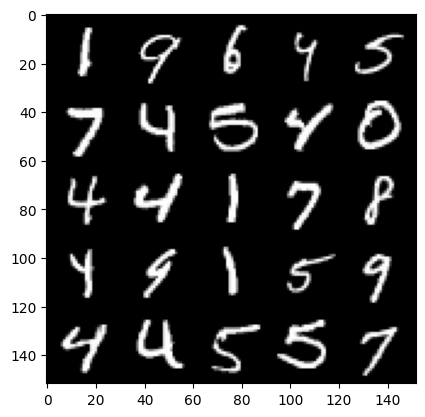

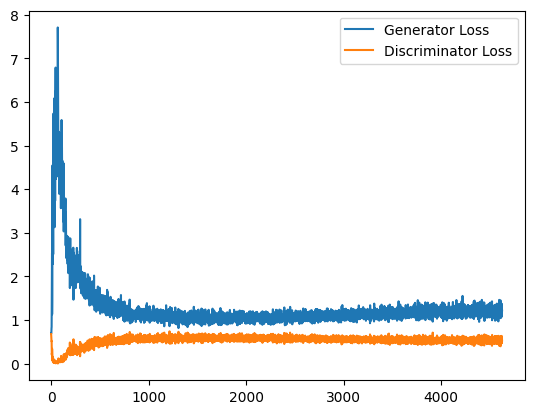

  0%|          | 0/469 [00:00<?, ?it/s]

Step 93000: Generator loss: 1.1868910195827485, discriminator loss: 0.5363943659067154


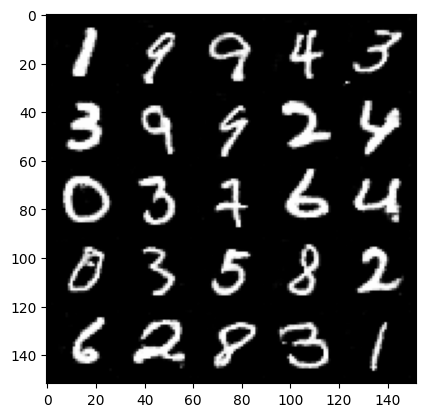

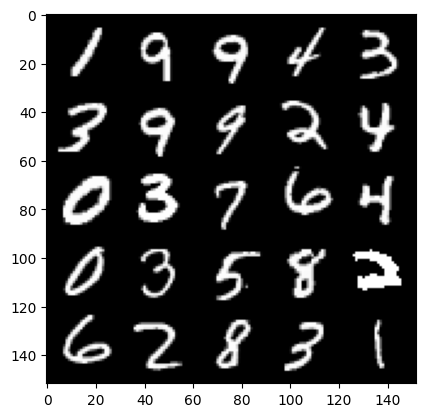

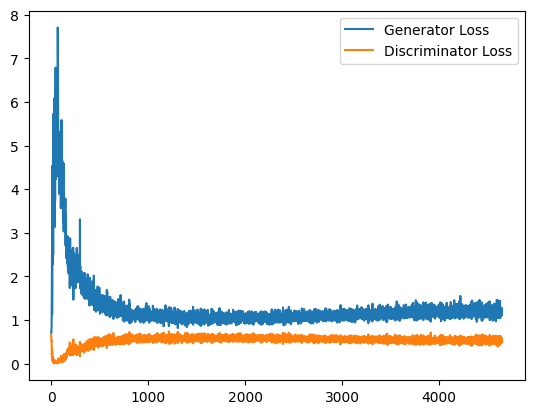

  0%|          | 0/469 [00:00<?, ?it/s]

Step 93500: Generator loss: 1.192349418401718, discriminator loss: 0.5366267879009247


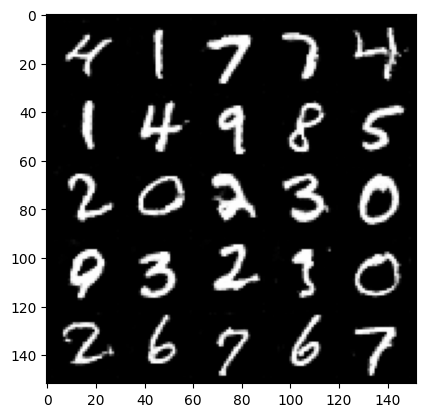

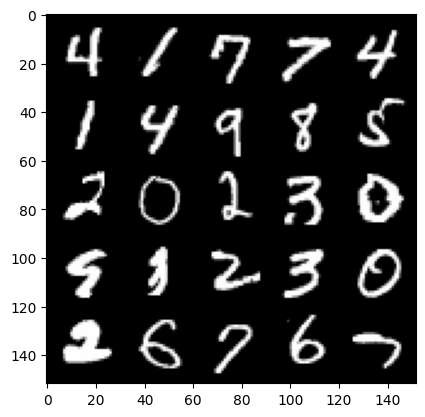

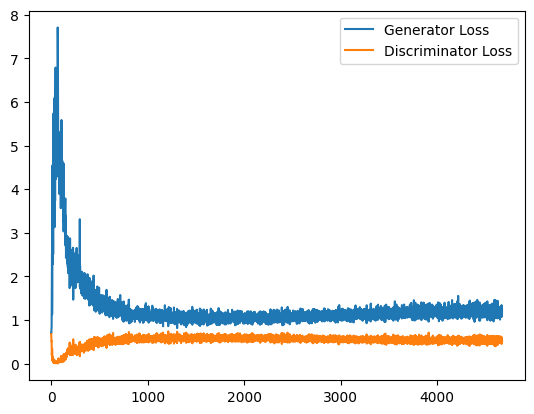

In [15]:
# UNQ_C4 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED CELL
cur_step = 0
generator_losses = []
discriminator_losses = []

#UNIT TEST NOTE: Initializations needed for grading
noise_and_labels = False
fake = False

fake_image_and_labels = False
real_image_and_labels = False
disc_fake_pred = False
disc_real_pred = False

for epoch in range(n_epochs):
    # Dataloader returns the batches and the labels
    for real, labels in tqdm(dataloader):
        cur_batch_size = len(real)
        # Flatten the batch of real images from the dataset
        real = real.to(device)

        one_hot_labels = get_one_hot_labels(labels.to(device), n_classes)
        image_one_hot_labels = one_hot_labels[:, :, None, None]
        image_one_hot_labels = image_one_hot_labels.repeat(1, 1, mnist_shape[1], mnist_shape[2])

        ### Update discriminator ###
        # Zero out the discriminator gradients
        disc_opt.zero_grad()
        # Get noise corresponding to the current batch_size 
        fake_noise = get_noise(cur_batch_size, z_dim, device=device)
        
        # Now you can get the images from the generator
        # Steps: 1) Combine the noise vectors and the one-hot labels for the generator
        #        2) Generate the conditioned fake images
       
        #### START CODE HERE ####
        noise_and_labels = combine_vectors(fake_noise, one_hot_labels)
        fake = gen(noise_and_labels)
        #### END CODE HERE ####
        
        # Make sure that enough images were generated
        assert len(fake) == len(real)
        # Check that correct tensors were combined
        assert tuple(noise_and_labels.shape) == (cur_batch_size, fake_noise.shape[1] + one_hot_labels.shape[1])
        # It comes from the correct generator
        assert tuple(fake.shape) == (len(real), 1, 28, 28)

        # Now you can get the predictions from the discriminator
        # Steps: 1) Create the input for the discriminator
        #           a) Combine the fake images with image_one_hot_labels, 
        #              remember to detach the generator (.detach()) so you do not backpropagate through it
        #           b) Combine the real images with image_one_hot_labels
        #        2) Get the discriminator's prediction on the fakes as disc_fake_pred
        #        3) Get the discriminator's prediction on the reals as disc_real_pred
        
        #### START CODE HERE ####
        fake_image_and_labels = combine_vectors(fake, image_one_hot_labels)
        real_image_and_labels = combine_vectors(real, image_one_hot_labels)
        disc_fake_pred = disc(fake_image_and_labels.detach())
        disc_real_pred = disc(real_image_and_labels)
        #### END CODE HERE ####
        
        # Make sure shapes are correct 
        assert tuple(fake_image_and_labels.shape) == (len(real), fake.detach().shape[1] + image_one_hot_labels.shape[1], 28 ,28)
        assert tuple(real_image_and_labels.shape) == (len(real), real.shape[1] + image_one_hot_labels.shape[1], 28 ,28)
        # Make sure that enough predictions were made
        assert len(disc_real_pred) == len(real)
        # Make sure that the inputs are different
        assert torch.any(fake_image_and_labels != real_image_and_labels)
        # Shapes must match
        assert tuple(fake_image_and_labels.shape) == tuple(real_image_and_labels.shape)
        assert tuple(disc_fake_pred.shape) == tuple(disc_real_pred.shape)
        
        
        disc_fake_loss = criterion(disc_fake_pred, torch.zeros_like(disc_fake_pred))
        disc_real_loss = criterion(disc_real_pred, torch.ones_like(disc_real_pred))
        disc_loss = (disc_fake_loss + disc_real_loss) / 2
        disc_loss.backward(retain_graph=True)
        disc_opt.step() 

        # Keep track of the average discriminator loss
        discriminator_losses += [disc_loss.item()]

        ### Update generator ###
        # Zero out the generator gradients
        gen_opt.zero_grad()

        fake_image_and_labels = combine_vectors(fake, image_one_hot_labels)
        # This will error if you didn't concatenate your labels to your image correctly
        disc_fake_pred = disc(fake_image_and_labels)
        gen_loss = criterion(disc_fake_pred, torch.ones_like(disc_fake_pred))
        gen_loss.backward()
        gen_opt.step()

        # Keep track of the generator losses
        generator_losses += [gen_loss.item()]
        #

        if cur_step % display_step == 0 and cur_step > 0:
            gen_mean = sum(generator_losses[-display_step:]) / display_step
            disc_mean = sum(discriminator_losses[-display_step:]) / display_step
            print(f"Step {cur_step}: Generator loss: {gen_mean}, discriminator loss: {disc_mean}")
            show_tensor_images(fake)
            show_tensor_images(real)
            step_bins = 20
            x_axis = sorted([i * step_bins for i in range(len(generator_losses) // step_bins)] * step_bins)
            num_examples = (len(generator_losses) // step_bins) * step_bins
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(generator_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Generator Loss"
            )
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(discriminator_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Discriminator Loss"
            )
            plt.legend()
            plt.show()
        elif cur_step == 0:
            print("Congratulations! If you've gotten here, it's working. Please let this train until you're happy with how the generated numbers look, and then go on to the exploration!")
        cur_step += 1


#### Exploration

In [16]:
# Putting generator in evaluation mode

gen = gen.eval()

##### Changing the class vector

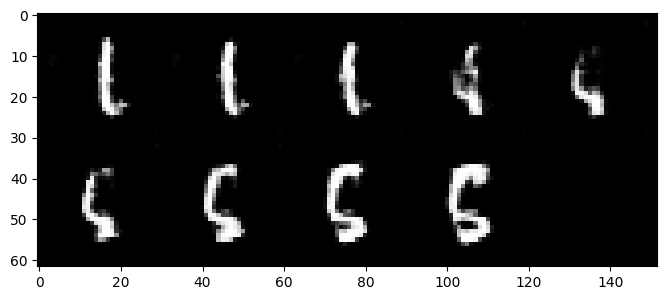

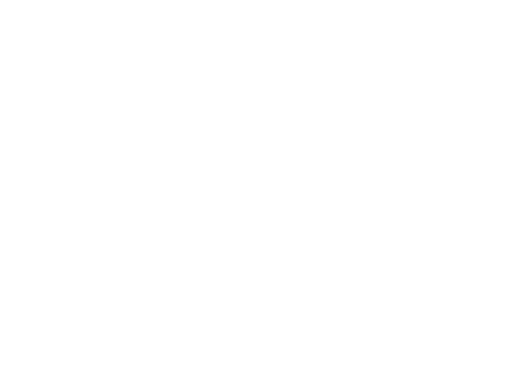

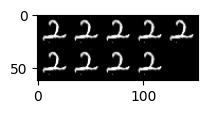

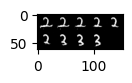

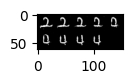

...

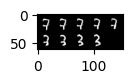

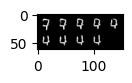

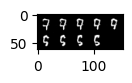

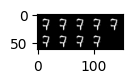

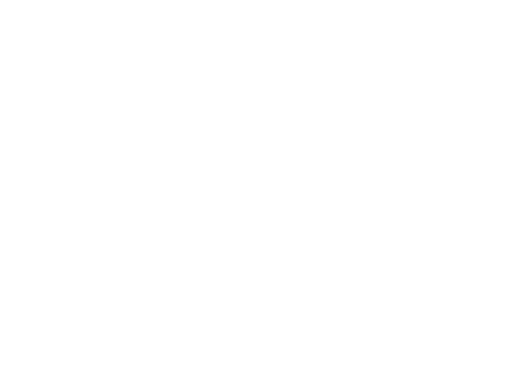

In [32]:
import math

n_interpolation = 9
interpolation_noise = get_noise(1, z_dim, device=device).repeat(n_interpolation, 1)

def interpolate_class(first_number, second_number):
    
    first_label = get_one_hot_labels(torch.Tensor([first_number]).long(), n_classes)
    second_label = get_one_hot_labels(torch.Tensor([second_number]).long(), n_classes)
    
    # Calculating the interpolation vector between the two labels
    percent_second_label = torch.linspace(0, 1, n_interpolation)[:, None]
    interpolation_labels = first_label * (1 - percent_second_label) + second_label * percent_second_label
    
    # Combining the noise and the labels
    noise_and_labels = combine_vectors(interpolation_noise, interpolation_labels.to(device))
    fake = gen(noise_and_labels)
    show_tensor_images(fake, num_images=n_interpolation, show=True)
    
start_plot_number = 1
end_plot_number = 5

plt.figure(figsize=(8, 8))
interpolate_class(start_plot_number, end_plot_number)
_ = plt.axis("off")

plot_numbers = [2, 3, 4, 5, 7]
n_numbers = len(plot_numbers)
plt.figure(figsize=(12, 12))

for i, first_plot_number in enumerate(plot_numbers):
    for j, second_plot_number in enumerate(plot_numbers):
        plt.subplot(n_numbers, n_numbers, i * n_numbers + j + 1)
        interpolate_class(first_plot_number, second_plot_number)
        plt.axis('off')
# plt.subplots_adjust(top=1, bottom=0, left=0, right=1, hspace=0.1, wspace=0)
plt.show()
plt.close()

### Changing the noise vector

In [ ]:
# Let's see what happens when we hold the class constant but, instead change the noise vector. We can interpolate the noise 
# ... vector and generate an image at each step

n_interpolation = 9

# This time we are interpolating between the noise instead of the class labels
def interpolate_noise(first_noise, second_noise):
    
    perce